<table class="table table-bordered">
    <tr>
        <th style="text-align:center;"><h1>Data Wrangling</h1><h2>Assignment 2 </h2><h3>Diploma in Data Science</h3></th>
    </tr>
</table>

# Table Of Contents (Code)<a id="part-1"></a>

#### To (Report) ===> [Report](#part0)

#### 1. [Load and Explore the Data](#part1)
   - [1.1 Exploring team.csv](#part1.1)  
   - [1.2 Exploring batting.csv](#part1.2)
   - [1.3 Exploring fielding.csv](#part1.3)
   - [1.4 Exploring pitching.csv](#part1.4)
   - [1.5 Problem Formulation](#part1.5)
   
#### 2. [Data Wrangling on multiple tables](#part2)
   - [2.1 Data Wrangling on team_data_full](#part2.1)  
   - [2.2 Data Wrangling on batting_data_full](#part2.2)
   - [2.3 Data Wrangling on fielding_data_full](#part2.3)
   - [2.4 Data Wrangling on pitching_data_full](#part2.4)
   - [2.5 Merging Tables](#part2.5)
   - [2.6 Applying Mathematical Calculations](#part2.6)
   
#### 3. [Data Cleansing and Transformation](#part3)
   - [3.1 Exploring baseball_data](#part3.1)  
   - [3.2 Addressing Multicollinearity](#part3.2)
   - [3.3 Continuation of Exploring updated baseball_data](#part3.3)
   - [3.4 Numerical Data Transformation](#part3.4)
   - [3.5 Outlier Capping](#part3.5)
   - [3.6 Train and Test Split](#part3.6)
   - [3.7 Variable Discretization](#part3.7)
   - [3.8 Feature Scaling](#part3.8)

#### 4. [Machine Learning Modelling](#part4)
   - [4.1 Naïve Baseline Model ](#part4.1)  
   - [4.2 Linear Regression Model](#part4.2)
   - [4.3 Rainforest Regressor Model](#part4.3)
   - [4.4 Classification Problem Tested With Logistic Regression and Decision Tree Classifier](#part4.4)
   
#### 5. [Additional (Finding Undervalued Players Who Contribute To Winning)](#part5)

# Code

In [1]:
# import the pacakges
import pandas as pd
import numpy as np
#import warnings
#warnings.filterwarnings('ignore') 
import matplotlib.pyplot as plt
import seaborn as sns 
from sklearn.model_selection import train_test_split
import scipy.stats as stats
from feature_engine.discretisation import EqualWidthDiscretiser
from feature_engine.discretisation import EqualFrequencyDiscretiser
from feature_engine.encoding import OneHotEncoder
from sklearn.preprocessing import StandardScaler
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error
from sklearn.metrics import r2_score
from sklearn.ensemble import RandomForestRegressor

## 1. Load and Explore the Data<a id="part1"></a>

In [2]:
team_data_full = pd.read_csv('team.csv')
batting_data_full = pd.read_csv('batting.csv')
fielding_data_full = pd.read_csv('fielding.csv')
pitching_data_full  = pd.read_csv('pitching.csv')

### 1.1 Exploring team.csv<a id="part1.1"></a>

In [3]:
team_data_full.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2805 entries, 0 to 2804
Data columns (total 48 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   year              2805 non-null   int64  
 1   league_id         2755 non-null   object 
 2   team_id           2805 non-null   object 
 3   franchise_id      2805 non-null   object 
 4   div_id            1288 non-null   object 
 5   rank              2805 non-null   int64  
 6   g                 2805 non-null   int64  
 7   ghome             2406 non-null   float64
 8   w                 2805 non-null   int64  
 9   l                 2805 non-null   int64  
 10  div_win           1260 non-null   object 
 11  wc_win            624 non-null    object 
 12  lg_win            2777 non-null   object 
 13  ws_win            2448 non-null   object 
 14  r                 2805 non-null   int64  
 15  ab                2805 non-null   int64  
 16  h                 2805 non-null   int64  


In [4]:
team_data_full.head()

,year,league_id,team_id,franchise_id,div_id,rank,g,ghome,w,l,...,dp,fp,name,park,attendance,bpf,ppf,team_id_br,team_id_lahman45,team_id_retro
0,1871,NaN,BS1,BNA,NaN,3,31,NaN,20,10,...,NaN,0.83,Boston Red Stockings,South End Grounds I,NaN,103,98,BOS,BS1,BS1
1,1871,NaN,CH1,CNA,NaN,2,28,NaN,19,9,...,NaN,0.82,Chicago White Stockings,Union Base-Ball Grounds,NaN,104,102,CHI,CH1,CH1
2,1871,NaN,CL1,CFC,NaN,8,29,NaN,10,19,...,NaN,0.81,Cleveland Forest Citys,National Association Grounds,NaN,96,100,CLE,CL1,CL1
3,1871,NaN,FW1,KEK,NaN,7,19,NaN,7,12,...,NaN,0.80,Fort Wayne Kekiongas,Hamilton Field,NaN,101,107,KEK,FW1,FW1
4,1871,NaN,NY2,NNA,NaN,5,33,NaN,16,17,...,NaN,0.83,New York Mutuals,Union Grounds (Brooklyn),NaN,90,88,NYU,NY2,NY2


In [5]:
team_data_full.describe(include='all')

,year,league_id,team_id,franchise_id,div_id,rank,g,ghome,w,l,...,dp,fp,name,park,attendance,bpf,ppf,team_id_br,team_id_lahman45,team_id_retro
count,2805.000000,2755,2805,2805,1288,2805.000000,2805.00000,2406.000000,2805.000000,2805.000000,...,2488.000000,2805.000000,2805,2771,2.526000e+03,2805.000000,2805.000000,2805,2805,2805
unique,NaN,6,149,120,3,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,139,212,NaN,NaN,NaN,101,148,149
top,NaN,NL,CHN,CHC,E,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,Cincinnati Reds,Wrigley Field,NaN,NaN,NaN,CHC,CHN,CHN
freq,NaN,1429,140,140,538,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,125,102,NaN,NaN,NaN,140,140,140
mean,1955.036720,NaN,NaN,NaN,NaN,4.107308,150.34795,78.465919,74.749020,74.749020,...,140.186495,0.961519,NaN,NaN,1.344346e+06,100.199643,100.225668,NaN,NaN,NaN
std,41.519083,NaN,NaN,NaN,NaN,2.323414,23.22725,4.698684,17.640402,17.378079,...,29.322764,0.030224,NaN,NaN,9.469316e+05,4.882215,4.814985,NaN,NaN,NaN
min,1871.000000,NaN,NaN,NaN,NaN,1.000000,6.00000,44.000000,0.000000,4.000000,...,18.000000,0.760000,NaN,NaN,6.088000e+03,60.000000,60.000000,NaN,NaN,NaN
25%,1919.000000,NaN,NaN,NaN,NaN,2.000000,153.00000,77.000000,66.000000,65.000000,...,126.000000,0.960000,NaN,NaN,5.287162e+05,97.000000,97.000000,NaN,NaN,NaN
50%,1963.000000,NaN,NaN,NaN,NaN,4.000000,157.00000,81.000000,77.000000,76.000000,...,145.000000,0.970000,NaN,NaN,1.140348e+06,100.000000,100.000000,NaN,NaN,NaN
75%,1992.000000,NaN,NaN,NaN,NaN,6.000000,162.00000,81.000000,87.000000,87.000000,...,159.250000,0.980000,NaN,NaN,2.014687e+06,103.000000,103.000000,NaN,NaN,NaN


In [6]:
team_data_full.isnull().sum()

year                   0
league_id             50
team_id                0
franchise_id           0
div_id              1517
rank                   0
g                      0
ghome                399
w                      0
l                      0
div_win             1545
wc_win              2181
lg_win                28
ws_win               357
r                      0
ab                     0
h                      0
double                 0
triple                 0
hr                     0
bb                     0
so                   120
sb                   144
cs                   859
hbp                 2325
sf                  2325
ra                     0
er                     0
era                    0
cg                     0
sho                    0
sv                     0
ipouts                 0
ha                     0
hra                    0
bba                    0
soa                    0
e                      0
dp                   317
fp                     0


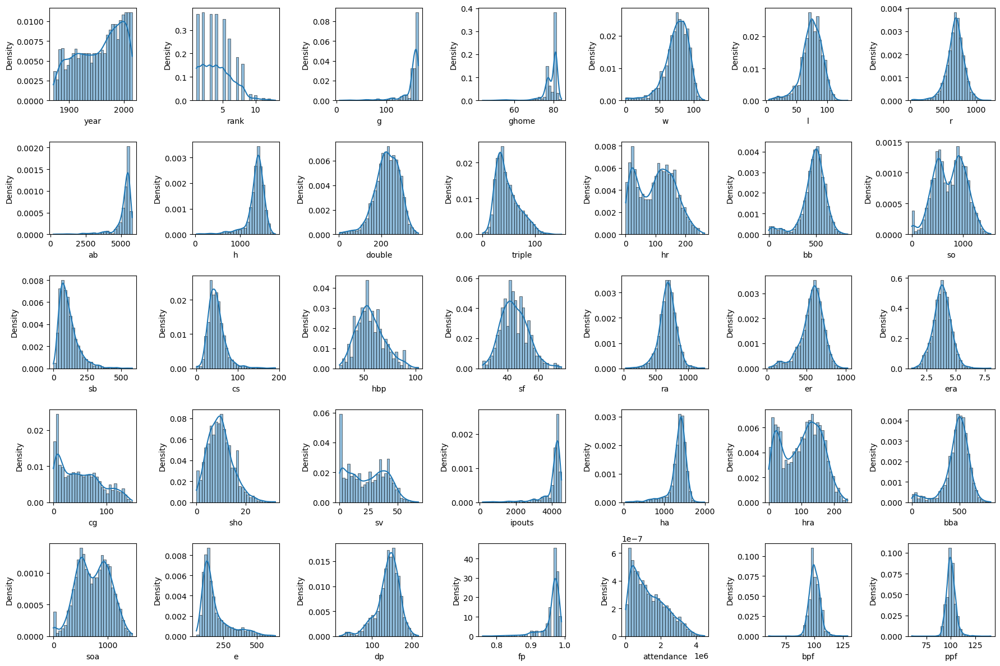

In [7]:
num_cols_team = [n for n in team_data_full.columns if team_data_full[n].dtypes!='O']

fig, ax = plt.subplots(5, 7, figsize=(18, 12))
ax = ax.flatten()

for i, col in enumerate(num_cols_team):
    sns.histplot(team_data_full[col],kde=True,stat='density',bins=30,ax=ax[i])

plt.tight_layout()
plt.show()

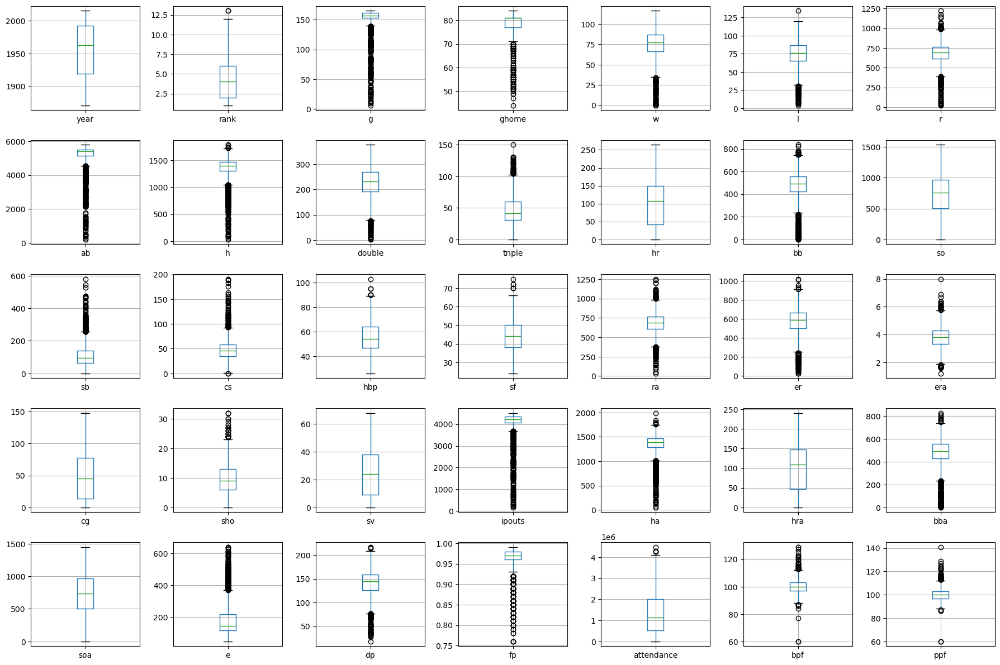

In [8]:
fig, ax = plt.subplots(5, 7, figsize=(18, 12))
ax = ax.flatten()

for i, col in enumerate(num_cols_team):
    team_data_full.boxplot(col, ax=ax[i])

plt.tight_layout()
plt.show()

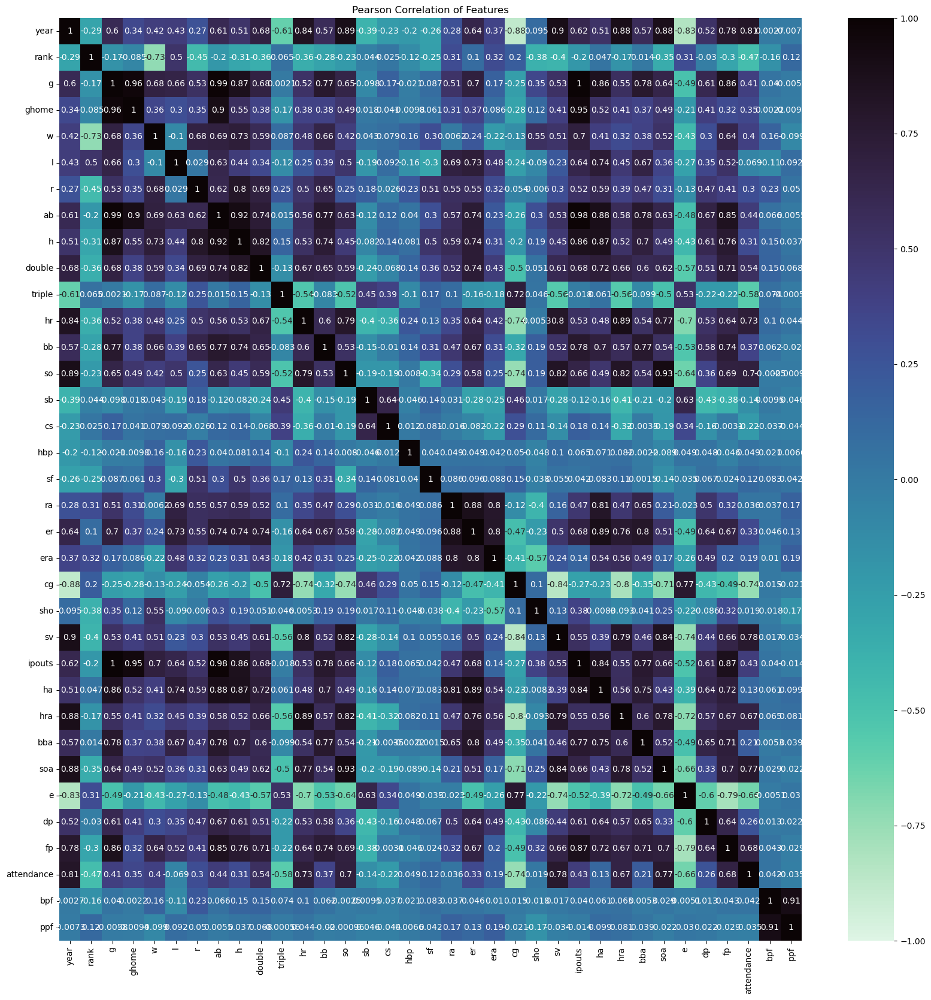

In [9]:
plt.figure(figsize=(20,20))
plt.title('Pearson Correlation of Features', size=12)
ax = sns.heatmap(team_data_full[num_cols_team].corr(), cmap='mako_r', annot=True, vmin=-1, vmax=1)
plt.show()

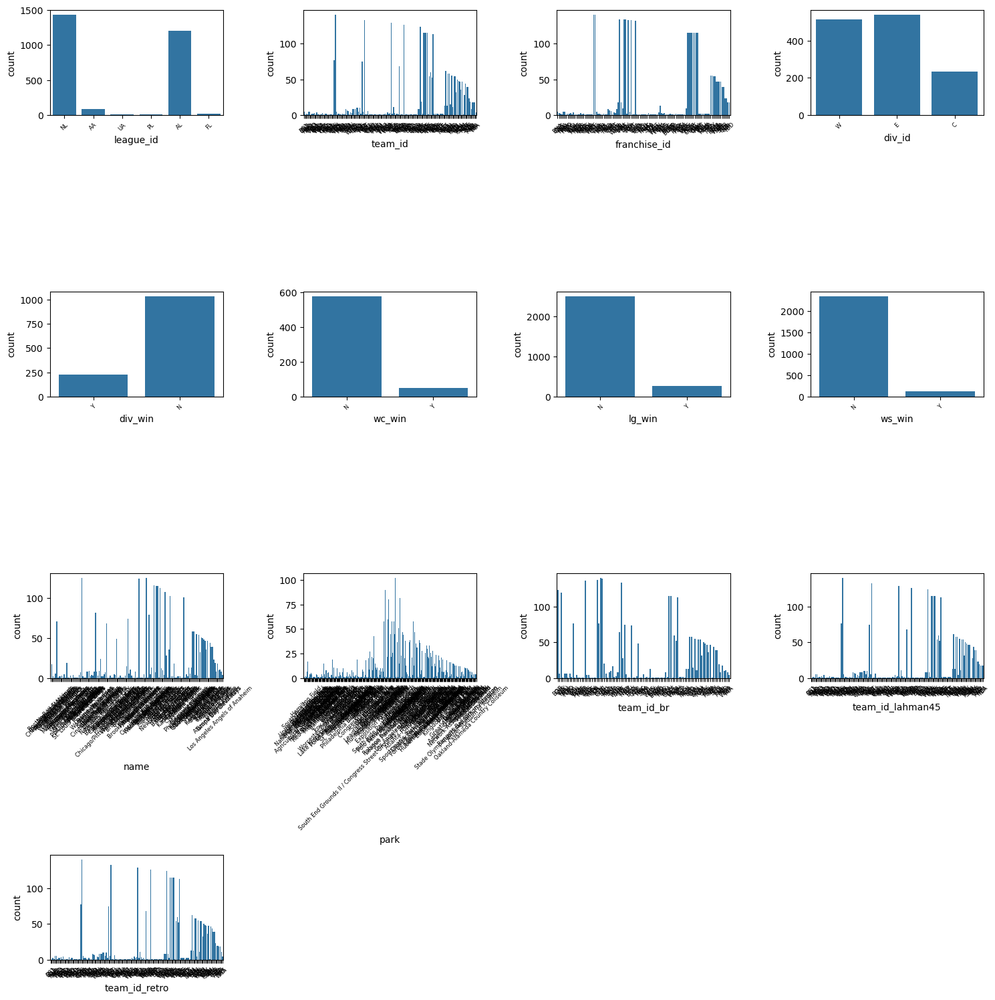

In [10]:
cat_cols_team = [c for c in team_data_full.columns if team_data_full[c].dtypes=='O']
fig, ax = plt.subplots(4, 4, figsize=(15, 15))
ax = ax.flatten()

for i, col in enumerate(cat_cols_team):
    sns.countplot(x=col, data=team_data_full, ax=ax[i])
    plt.ylabel('Count')
    ax[i].tick_params(axis='x', rotation=45, labelsize=6)

for i in range(len(cat_cols_team),16):
    ax[i].axis('off')
    
plt.tight_layout()
plt.show()

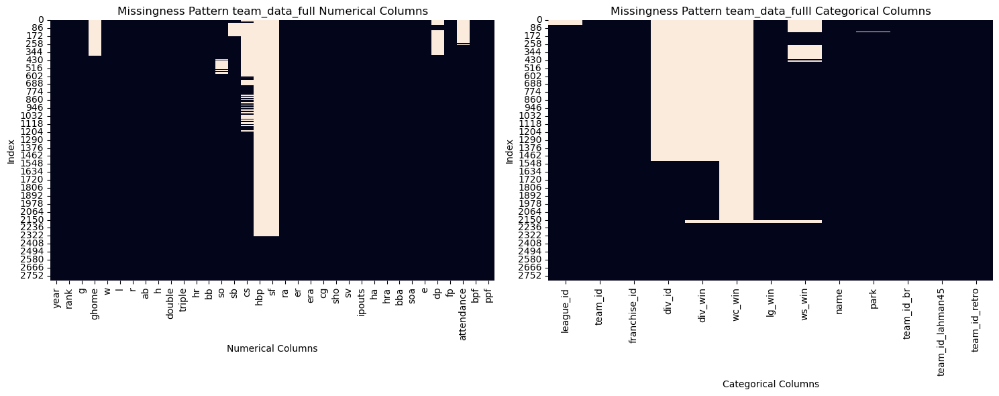

In [11]:
fig, ax = plt.subplots(nrows=1, ncols=2, figsize=(15, 6))

sns.heatmap(team_data_full[num_cols_team].isnull(), cbar=False, ax=ax[0])
ax[0].set_title('Missingness Pattern team_data_full Numerical Columns')
ax[0].set_xlabel('Numerical Columns')
ax[0].set_ylabel('Index')

sns.heatmap(team_data_full[cat_cols_team].isnull(), cbar=False, ax=ax[1])
ax[1].set_title('Missingness Pattern team_data_fulll Categorical Columns')
ax[1].set_xlabel('Categorical Columns')
ax[1].set_ylabel('Index')

plt.tight_layout()
plt.show()

### 1.2 Exploring batting.csv<a id="part1.2"></a>

In [12]:
batting_data_full.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 101332 entries, 0 to 101331
Data columns (total 22 columns):
 #   Column     Non-Null Count   Dtype  
---  ------     --------------   -----  
 0   player_id  101332 non-null  object 
 1   year       101332 non-null  int64  
 2   stint      101332 non-null  int64  
 3   team_id    101332 non-null  object 
 4   league_id  100595 non-null  object 
 5   g          101332 non-null  int64  
 6   ab         96183 non-null   float64
 7   r          96183 non-null   float64
 8   h          96183 non-null   float64
 9   double     96183 non-null   float64
 10  triple     96183 non-null   float64
 11  hr         96183 non-null   float64
 12  rbi        95759 non-null   float64
 13  sb         94883 non-null   float64
 14  cs         72729 non-null   float64
 15  bb         96183 non-null   float64
 16  so         88345 non-null   float64
 17  ibb        59620 non-null   float64
 18  hbp        93373 non-null   float64
 19  sh         89845 non-nu

In [13]:
batting_data_full.head()

,player_id,year,stint,team_id,league_id,g,ab,r,h,double,...,rbi,sb,cs,bb,so,ibb,hbp,sh,sf,g_idp
0,abercda01,1871,1,TRO,NaN,1,4.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN
1,addybo01,1871,1,RC1,NaN,25,118.0,30.0,32.0,6.0,...,13.0,8.0,1.0,4.0,0.0,NaN,NaN,NaN,NaN,NaN
2,allisar01,1871,1,CL1,NaN,29,137.0,28.0,40.0,4.0,...,19.0,3.0,1.0,2.0,5.0,NaN,NaN,NaN,NaN,NaN
3,allisdo01,1871,1,WS3,NaN,27,133.0,28.0,44.0,10.0,...,27.0,1.0,1.0,0.0,2.0,NaN,NaN,NaN,NaN,NaN
4,ansonca01,1871,1,RC1,NaN,25,120.0,29.0,39.0,11.0,...,16.0,6.0,2.0,2.0,1.0,NaN,NaN,NaN,NaN,NaN


In [14]:
batting_data_full.describe(include='all')

,player_id,year,stint,team_id,league_id,g,ab,r,h,double,...,rbi,sb,cs,bb,so,ibb,hbp,sh,sf,g_idp
count,101332,101332.000000,101332.000000,101332,100595,101332.000000,96183.000000,96183.000000,96183.000000,96183.000000,...,95759.000000,94883.000000,72729.000000,96183.000000,88345.000000,59620.000000,93373.000000,89845.000000,60151.000000,70075.000000
unique,18659,NaN,NaN,149,6,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
top,mcguide01,NaN,NaN,CHN,NL,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
freq,31,NaN,NaN,4818,51385,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
mean,NaN,1963.506533,1.077567,NaN,NaN,51.400111,149.970327,19.887038,39.261647,6.637067,...,17.965163,3.158184,1.324025,13.811484,21.629849,1.213234,1.113395,2.457900,1.150122,3.210032
std,NaN,38.628278,0.283676,NaN,NaN,47.145273,186.557072,28.671365,53.310941,9.801563,...,26.756514,7.922994,2.838196,21.092775,28.432978,2.894918,2.320660,4.347818,2.023981,4.835881
min,NaN,1871.000000,1.000000,NaN,NaN,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,NaN,1933.000000,1.000000,NaN,NaN,13.000000,7.000000,0.000000,1.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,2.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,NaN,1972.000000,1.000000,NaN,NaN,34.000000,57.000000,5.000000,11.000000,1.000000,...,4.000000,0.000000,0.000000,3.000000,10.000000,0.000000,0.000000,1.000000,0.000000,1.000000
75%,NaN,1997.000000,1.000000,NaN,NaN,80.250000,251.000000,30.000000,63.000000,10.000000,...,27.000000,2.000000,1.000000,20.000000,30.000000,1.000000,1.000000,3.000000,2.000000,5.000000


In [15]:
batting_data_full.isnull().sum()

player_id        0
year             0
stint            0
team_id          0
league_id      737
g                0
ab            5149
r             5149
h             5149
double        5149
triple        5149
hr            5149
rbi           5573
sb            6449
cs           28603
bb            5149
so           12987
ibb          41712
hbp           7959
sh           11487
sf           41181
g_idp        31257
dtype: int64

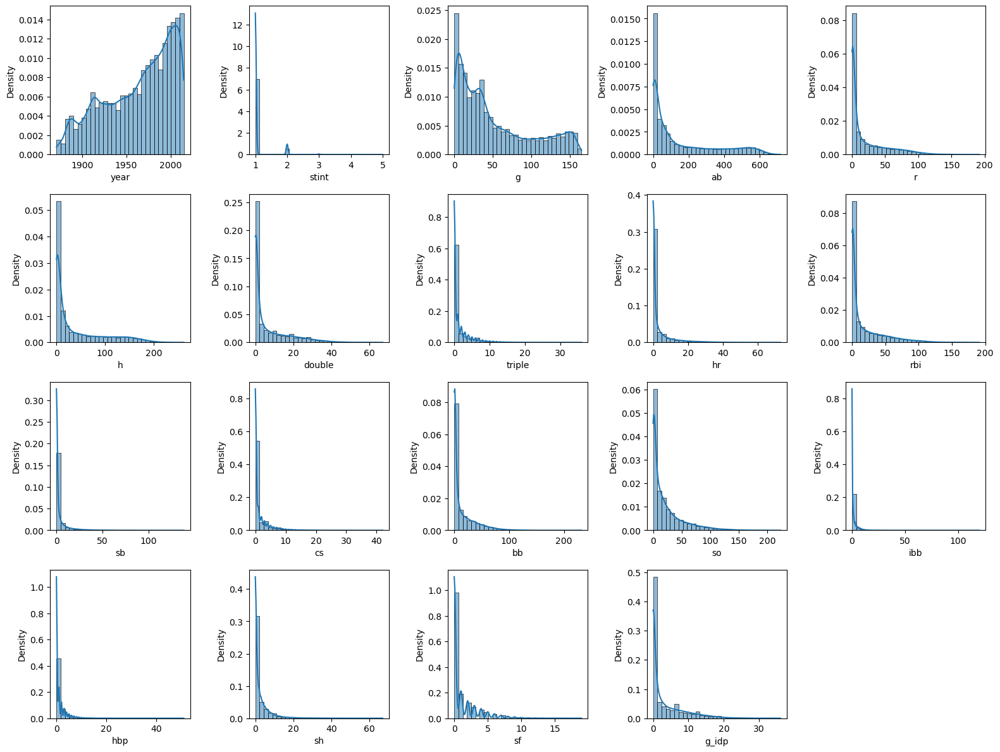

In [16]:
num_cols_batting = [n for n in batting_data_full.columns if batting_data_full[n].dtypes!='O']

fig, ax = plt.subplots(4, 5, figsize=(16, 12))
ax = ax.flatten()

for i, col in enumerate(num_cols_batting):
    sns.histplot(batting_data_full[col],kde=True,stat='density',bins=30,ax=ax[i])

for i in range(len(num_cols_batting),20):
    ax[i].axis('off')

plt.tight_layout()
plt.show()

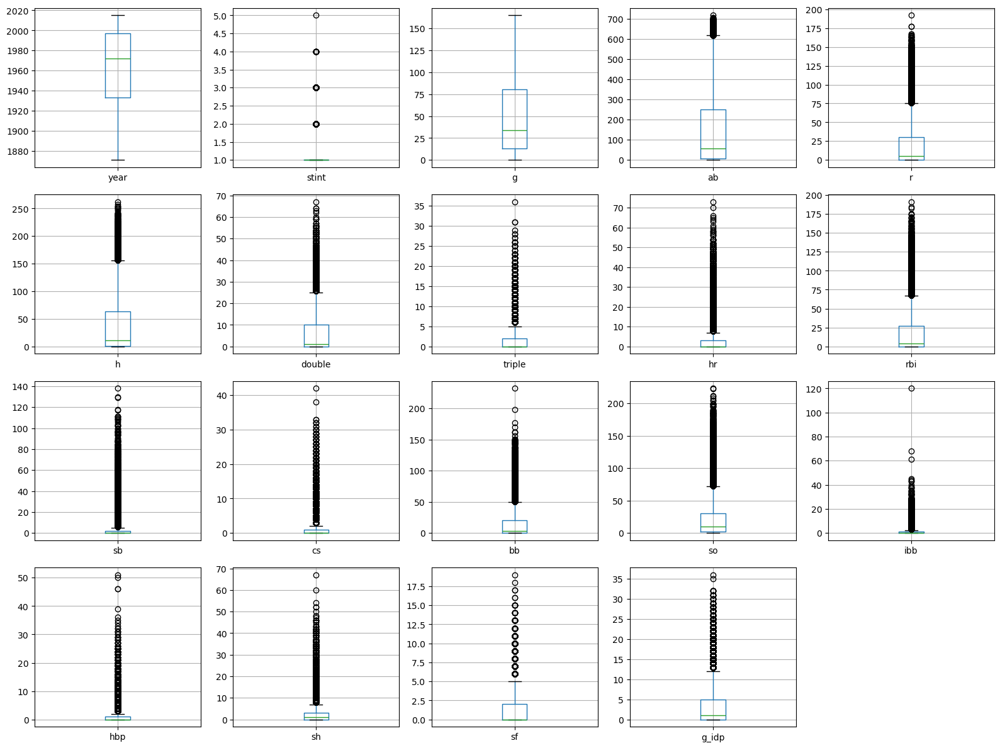

In [17]:
fig, ax = plt.subplots(4, 5, figsize=(16, 12))
ax = ax.flatten()

for i, col in enumerate(num_cols_batting):
    batting_data_full.boxplot(col, ax=ax[i])

for i in range(len(num_cols_batting),20):
    ax[i].axis('off')

plt.tight_layout()
plt.show()

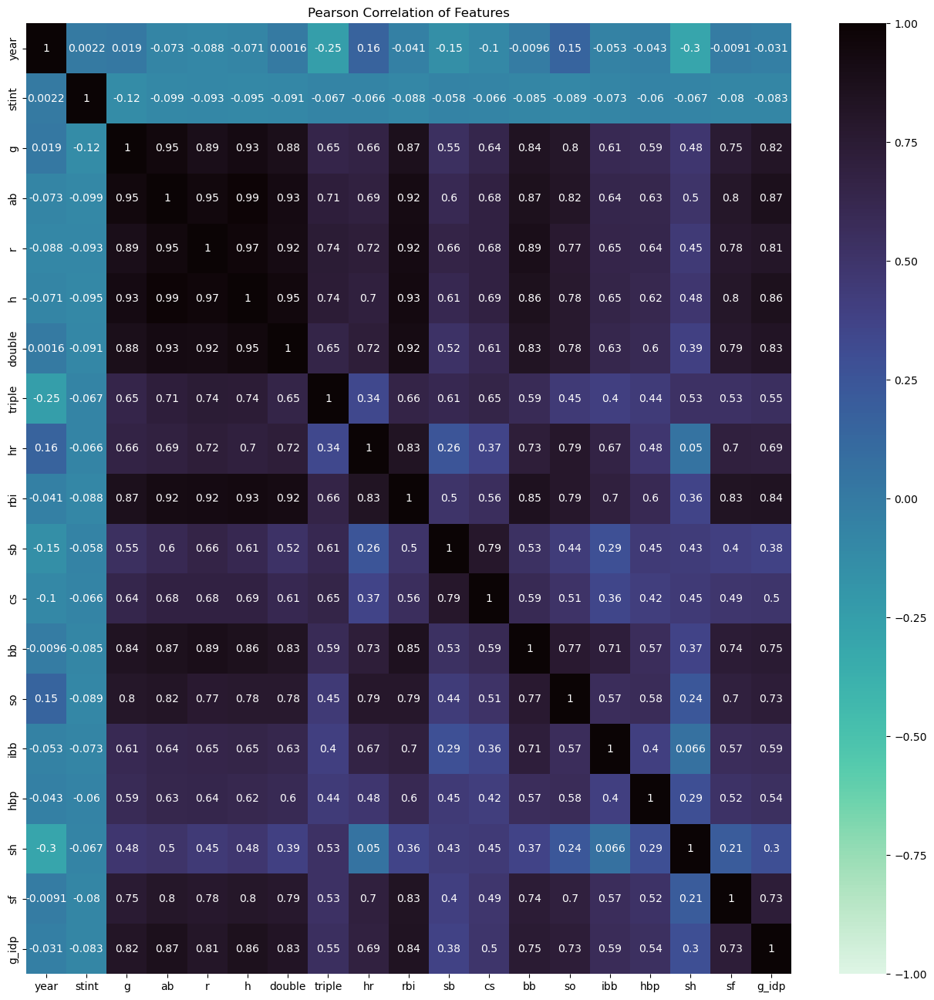

In [18]:
plt.figure(figsize=(16,16))
plt.title('Pearson Correlation of Features', size=12)
ax = sns.heatmap(batting_data_full[num_cols_batting].corr(), cmap='mako_r', annot=True, vmin=-1, vmax=1)
plt.show()

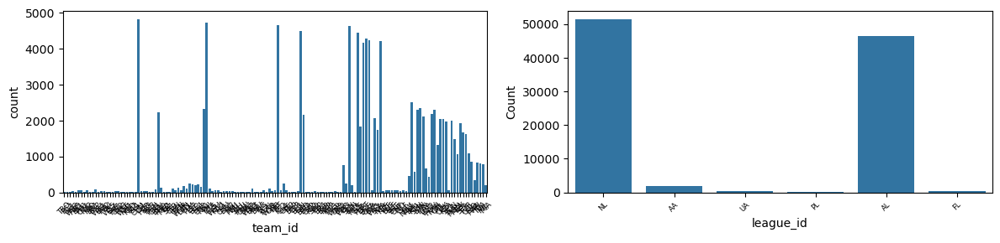

In [19]:
cat_cols_batting = [c for c in batting_data_full.columns if batting_data_full[c].dtypes=='O' and c != 'player_id']
fig, ax = plt.subplots(1, 2, figsize=(12, 3))
ax = ax.flatten()

for i, col in enumerate(cat_cols_batting):
    sns.countplot(x=col, data=batting_data_full, ax=ax[i])
    plt.ylabel('Count')
    ax[i].tick_params(axis='x', rotation=45, labelsize=6)
    
plt.tight_layout()
plt.show()

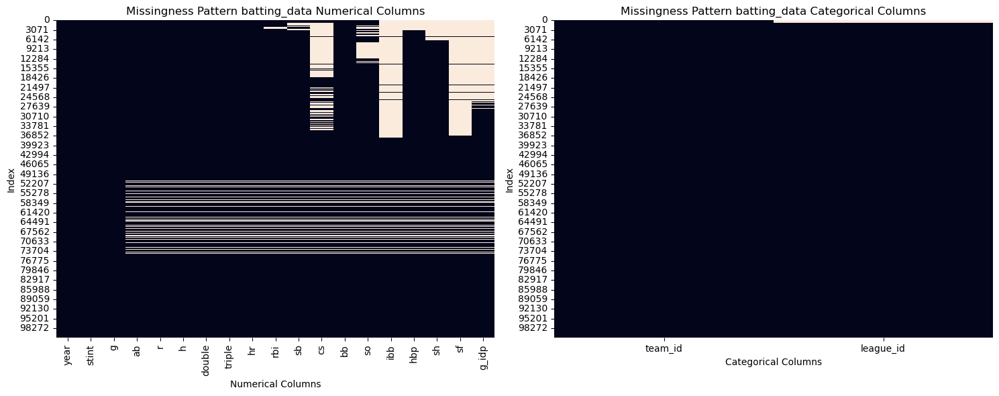

In [20]:
fig, ax = plt.subplots(nrows=1, ncols=2, figsize=(15, 6))

sns.heatmap(batting_data_full[num_cols_batting].isnull(), cbar=False, ax=ax[0])
ax[0].set_title('Missingness Pattern batting_data Numerical Columns')
ax[0].set_xlabel('Numerical Columns')
ax[0].set_ylabel('Index')

sns.heatmap(batting_data_full[cat_cols_batting].isnull(), cbar=False, ax=ax[1])
ax[1].set_title('Missingness Pattern batting_data Categorical Columns')
ax[1].set_xlabel('Categorical Columns')
ax[1].set_ylabel('Index')

plt.tight_layout()
plt.show()

### 1.3 Exploring fielding.csv<a id="part1.3"></a>

In [21]:
fielding_data_full.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 170526 entries, 0 to 170525
Data columns (total 18 columns):
 #   Column     Non-Null Count   Dtype  
---  ------     --------------   -----  
 0   player_id  170526 non-null  object 
 1   year       170526 non-null  int64  
 2   stint      170526 non-null  int64  
 3   team_id    170526 non-null  object 
 4   league_id  169023 non-null  object 
 5   pos        170526 non-null  object 
 6   g          170526 non-null  int64  
 7   gs         75849 non-null   float64
 8   inn_outs   102313 non-null  float64
 9   po         156409 non-null  float64
 10  a          156408 non-null  float64
 11  e          156407 non-null  float64
 12  dp         156408 non-null  float64
 13  pb         11116 non-null   float64
 14  wp         4189 non-null    float64
 15  sb         6024 non-null    float64
 16  cs         6024 non-null    float64
 17  zr         4189 non-null    float64
dtypes: float64(11), int64(3), object(4)
memory usage: 23.4+ MB


In [22]:
fielding_data_full.head()

,player_id,year,stint,team_id,league_id,pos,g,gs,inn_outs,po,a,e,dp,pb,wp,sb,cs,zr
0,abercda01,1871,1,TRO,NaN,SS,1,NaN,NaN,1.0,3.0,2.0,0.0,NaN,NaN,NaN,NaN,NaN
1,addybo01,1871,1,RC1,NaN,2B,22,NaN,NaN,67.0,72.0,42.0,5.0,NaN,NaN,NaN,NaN,NaN
2,addybo01,1871,1,RC1,NaN,SS,3,NaN,NaN,8.0,14.0,7.0,0.0,NaN,NaN,NaN,NaN,NaN
3,allisar01,1871,1,CL1,NaN,2B,2,NaN,NaN,1.0,4.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN
4,allisar01,1871,1,CL1,NaN,OF,29,NaN,NaN,51.0,3.0,7.0,1.0,NaN,NaN,NaN,NaN,NaN


In [23]:
fielding_data_full.describe(include='all')

,player_id,year,stint,team_id,league_id,pos,g,gs,inn_outs,po,a,e,dp,pb,wp,sb,cs,zr
count,170526,170526.000000,170526.000000,170526,169023,170526,170526.000000,75849.000000,102313.000000,156409.000000,156408.000000,156407.000000,156408.000000,11116.000000,4189.000000,6024.000000,6024.000000,4189.000000
unique,18465,NaN,NaN,149,6,11,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
top,harrile01,NaN,NaN,CHN,NL,P,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
freq,114,NaN,NaN,7675,84468,44141,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
mean,NaN,1966.517123,1.077818,NaN,NaN,NaN,33.651854,26.930823,708.231134,79.463496,30.826198,3.512093,6.349017,5.167326,11.772977,24.909031,12.066899,0.703032
std,NaN,38.550401,0.283581,NaN,NaN,NaN,41.117359,40.790139,1061.423810,176.463601,75.011893,7.534450,18.388112,9.116445,12.249974,25.816811,13.222888,1.394882
min,NaN,1871.000000,1.000000,NaN,NaN,NaN,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,NaN,1941.000000,1.000000,NaN,NaN,NaN,4.000000,1.000000,54.000000,2.000000,1.000000,0.000000,0.000000,0.000000,2.000000,4.000000,1.000000,0.000000
50%,NaN,1977.000000,1.000000,NaN,NaN,NaN,16.000000,7.000000,220.000000,10.000000,5.000000,1.000000,1.000000,2.000000,8.000000,17.000000,8.000000,0.000000
75%,NaN,1998.000000,1.000000,NaN,NaN,NaN,45.000000,32.000000,754.000000,72.000000,22.000000,3.000000,3.000000,6.000000,19.000000,39.000000,19.000000,1.000000


In [24]:
fielding_data_full.isnull().sum()

player_id         0
year              0
stint             0
team_id           0
league_id      1503
pos               0
g                 0
gs            94677
inn_outs      68213
po            14117
a             14118
e             14119
dp            14118
pb           159410
wp           166337
sb           164502
cs           164502
zr           166337
dtype: int64

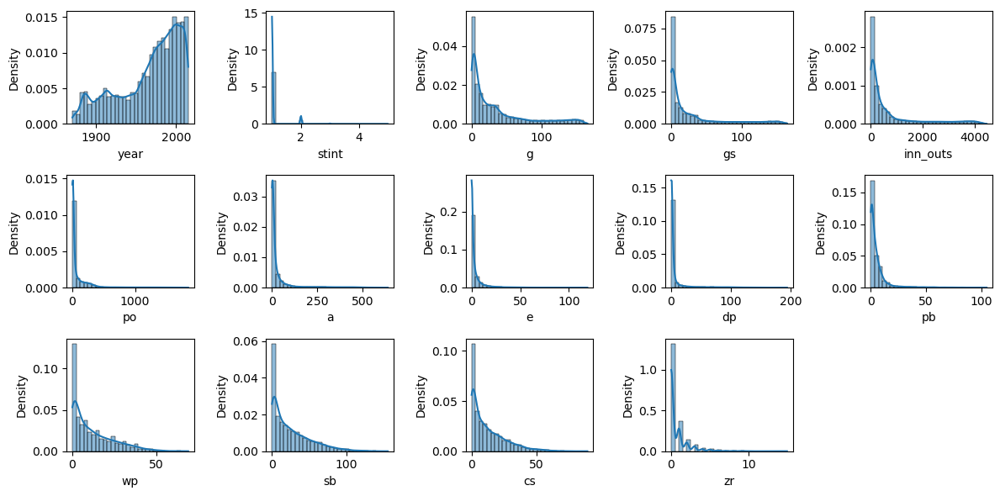

In [25]:
num_cols_fielding = [n for n in fielding_data_full.columns if fielding_data_full[n].dtypes!='O']

fig, ax = plt.subplots(3, 5, figsize=(12, 6))
ax = ax.flatten()

for i, col in enumerate(num_cols_fielding):
    sns.histplot(fielding_data_full[col],kde=True,stat='density',bins=30,ax=ax[i])

for i in range(len(num_cols_fielding),15):
    ax[i].axis('off')

plt.tight_layout()
plt.show()

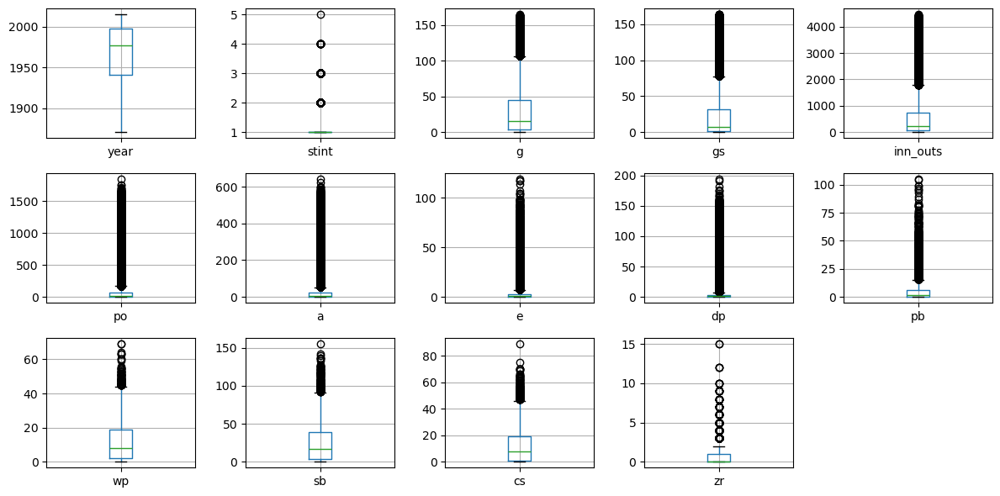

In [26]:
fig, ax = plt.subplots(3, 5, figsize=(12, 6))
ax = ax.flatten()

for i, col in enumerate(num_cols_fielding):
    fielding_data_full.boxplot(col, ax=ax[i])

for i in range(len(num_cols_fielding),15):
    ax[i].axis('off')

plt.tight_layout()
plt.show()

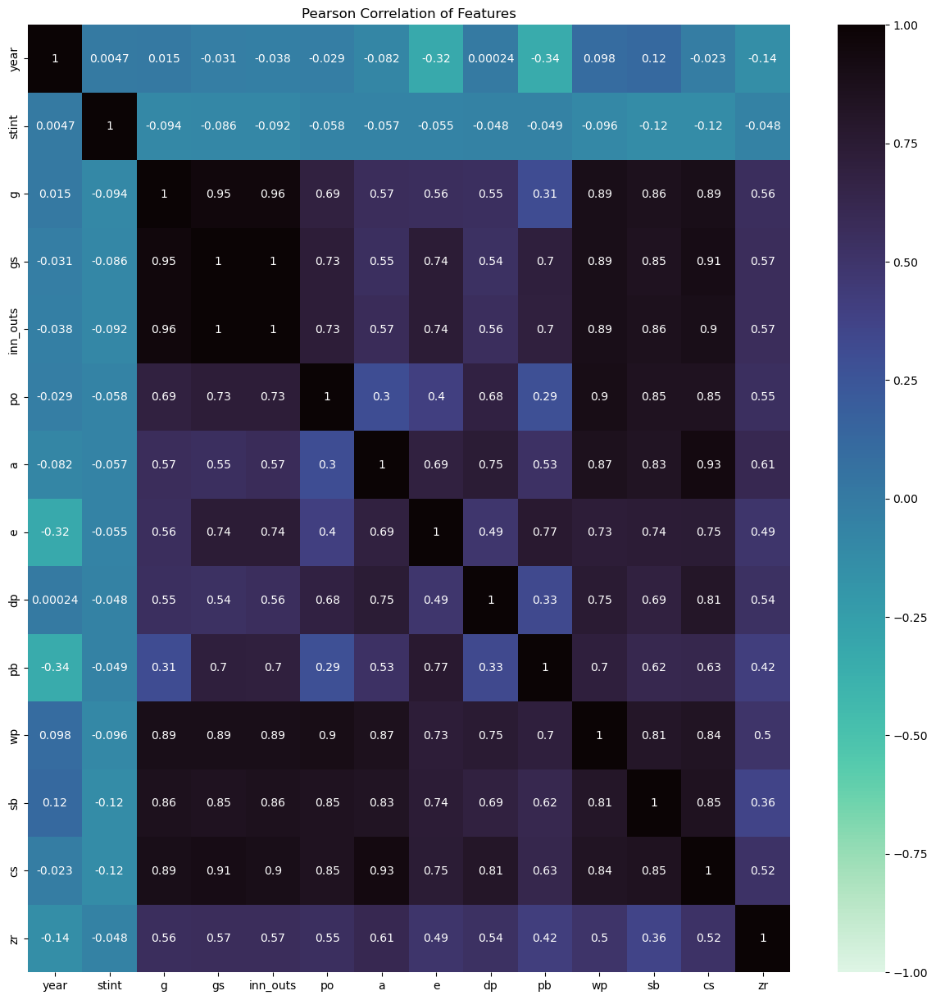

In [27]:
plt.figure(figsize=(15,15))
plt.title('Pearson Correlation of Features', size=12)
ax = sns.heatmap(fielding_data_full[num_cols_fielding].corr(), cmap='mako_r', annot=True, vmin=-1, vmax=1)
plt.show()

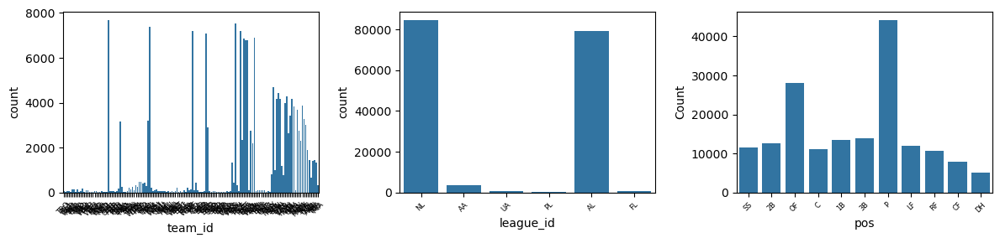

In [28]:
cat_cols_fielding = [c for c in fielding_data_full.columns if fielding_data_full[c].dtypes=='O' and c != 'player_id']
fig, ax = plt.subplots(1, 3, figsize=(12, 3))
ax = ax.flatten()

for i, col in enumerate(cat_cols_fielding):
    sns.countplot(x=col, data=fielding_data_full, ax=ax[i])
    plt.ylabel('Count')
    ax[i].tick_params(axis='x', rotation=45, labelsize=6)
    
plt.tight_layout()
plt.show()

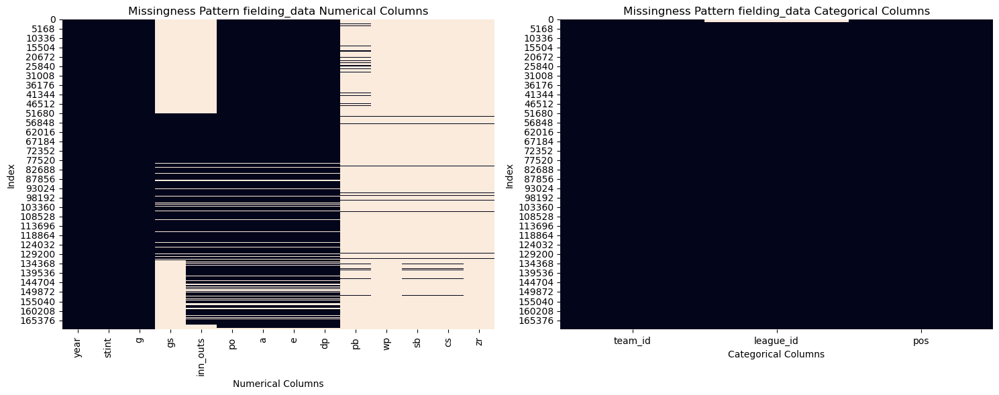

In [29]:
fig, ax = plt.subplots(nrows=1, ncols=2, figsize=(15, 6))

sns.heatmap(fielding_data_full[num_cols_fielding].isnull(), cbar=False, ax=ax[0])
ax[0].set_title('Missingness Pattern fielding_data Numerical Columns')
ax[0].set_xlabel('Numerical Columns')
ax[0].set_ylabel('Index')

sns.heatmap(fielding_data_full[cat_cols_fielding].isnull(), cbar=False, ax=ax[1])
ax[1].set_title('Missingness Pattern fielding_data Categorical Columns')
ax[1].set_xlabel('Categorical Columns')
ax[1].set_ylabel('Index')

plt.tight_layout()
plt.show()

### 1.4 Exploring pitching.csv<a id="part1.4"></a>

In [30]:
pitching_data_full.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 44139 entries, 0 to 44138
Data columns (total 30 columns):
 #   Column     Non-Null Count  Dtype  
---  ------     --------------  -----  
 0   player_id  44139 non-null  object 
 1   year       44139 non-null  int64  
 2   stint      44139 non-null  int64  
 3   team_id    44139 non-null  object 
 4   league_id  44008 non-null  object 
 5   w          44139 non-null  int64  
 6   l          44139 non-null  int64  
 7   g          44139 non-null  int64  
 8   gs         44139 non-null  int64  
 9   cg         44139 non-null  int64  
 10  sho        44139 non-null  int64  
 11  sv         44139 non-null  int64  
 12  ipouts     44138 non-null  float64
 13  h          44139 non-null  int64  
 14  er         44139 non-null  int64  
 15  hr         44139 non-null  int64  
 16  bb         44139 non-null  int64  
 17  so         44139 non-null  int64  
 18  baopp      42614 non-null  float64
 19  era        44049 non-null  float64
 20  ibb   

In [31]:
pitching_data_full.head()

,player_id,year,stint,team_id,league_id,w,l,g,gs,cg,...,ibb,wp,hbp,bk,bfp,gf,r,sh,sf,g_idp
0,bechtge01,1871,1,PH1,NaN,1,2,3,3,2,...,NaN,NaN,NaN,0,NaN,NaN,42,NaN,NaN,NaN
1,brainas01,1871,1,WS3,NaN,12,15,30,30,30,...,NaN,NaN,NaN,0,NaN,NaN,292,NaN,NaN,NaN
2,fergubo01,1871,1,NY2,NaN,0,0,1,0,0,...,NaN,NaN,NaN,0,NaN,NaN,9,NaN,NaN,NaN
3,fishech01,1871,1,RC1,NaN,4,16,24,24,22,...,NaN,NaN,NaN,0,NaN,NaN,257,NaN,NaN,NaN
4,fleetfr01,1871,1,NY2,NaN,0,1,1,1,1,...,NaN,NaN,NaN,0,NaN,NaN,21,NaN,NaN,NaN


In [32]:
pitching_data_full.describe(include='all')

,player_id,year,stint,team_id,league_id,w,l,g,gs,cg,...,ibb,wp,hbp,bk,bfp,gf,r,sh,sf,g_idp
count,44139,44139.000000,44139.00000,44139,44008,44139.000000,44139.000000,44139.000000,44139.000000,44139.000000,...,29564.000000,44006.000000,43580.000000,44139.000000,43900.000000,44006.000000,44139.000000,11239.000000,11239.000000,745.000000
unique,9126,NaN,NaN,149,6,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
top,newsobo01,NaN,NaN,PHI,NL,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
freq,29,NaN,NaN,2090,22405,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
mean,NaN,1967.786493,1.07925,NaN,NaN,4.748794,4.748771,23.667142,9.552550,3.207979,...,2.447064,2.534836,2.271111,0.303881,345.551572,6.355611,43.332291,2.207759,1.908088,4.844295
std,NaN,37.352599,0.28443,NaN,NaN,5.837989,5.007080,18.462900,12.312479,7.134955,...,2.792671,3.438515,3.008115,0.759298,350.259188,10.003279,43.437952,2.751917,2.143002,5.524863
min,NaN,1871.000000,1.00000,NaN,NaN,0.000000,0.000000,1.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,NaN,1940.000000,1.00000,NaN,NaN,0.000000,1.000000,7.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,64.000000,0.000000,11.000000,0.000000,0.000000,1.000000
50%,NaN,1977.000000,1.00000,NaN,NaN,2.000000,3.000000,22.000000,3.000000,0.000000,...,2.000000,1.000000,1.000000,0.000000,229.000000,3.000000,29.000000,1.000000,1.000000,3.000000
75%,NaN,2000.000000,1.00000,NaN,NaN,7.000000,8.000000,35.000000,18.000000,3.000000,...,4.000000,4.000000,3.000000,0.000000,540.000000,8.000000,68.000000,3.000000,3.000000,7.000000


In [33]:
pitching_data_full.isnull().sum()

player_id        0
year             0
stint            0
team_id          0
league_id      131
w                0
l                0
g                0
gs               0
cg               0
sho              0
sv               0
ipouts           1
h                0
er               0
hr               0
bb               0
so               0
baopp         1525
era             90
ibb          14575
wp             133
hbp            559
bk               0
bfp            239
gf             133
r                0
sh           32900
sf           32900
g_idp        43394
dtype: int64

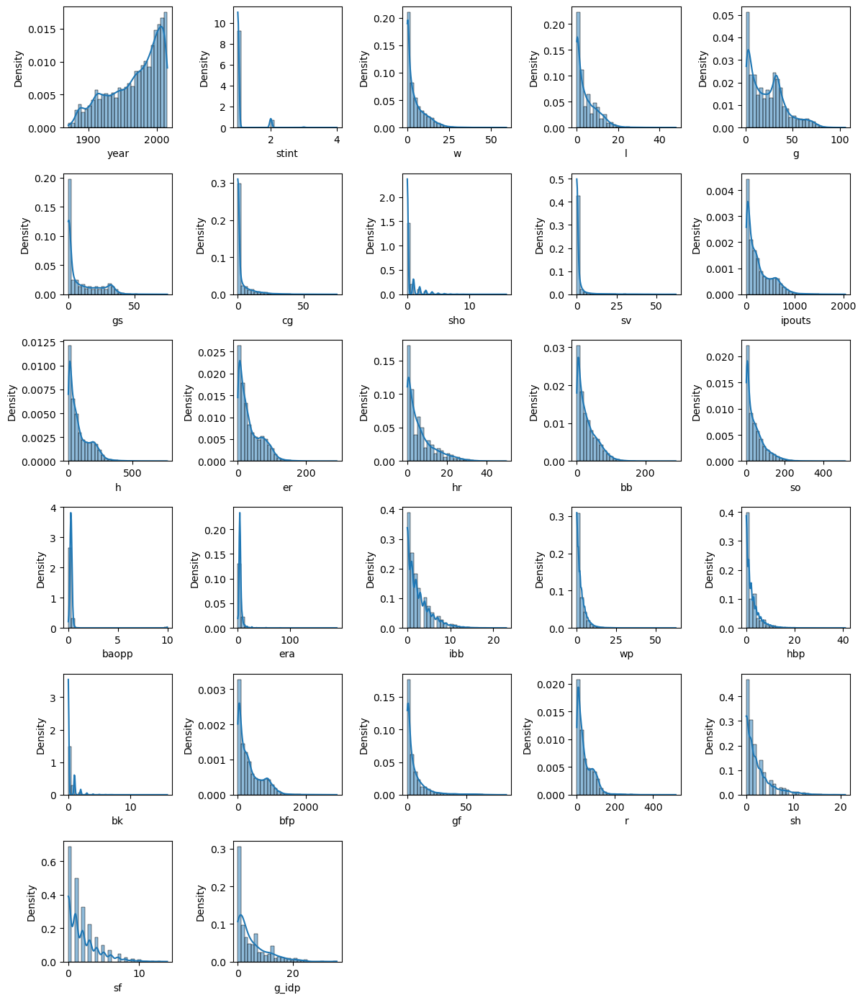

In [34]:
num_cols_pitching = [n for n in pitching_data_full.columns if pitching_data_full[n].dtypes!='O']

fig, ax = plt.subplots(6, 5, figsize=(12, 14))
ax = ax.flatten()

for i, col in enumerate(num_cols_pitching):
    sns.histplot(pitching_data_full[col],kde=True,stat='density',bins=30,ax=ax[i])

for i in range(len(num_cols_pitching),30):
    ax[i].axis('off')

plt.tight_layout()
plt.show()

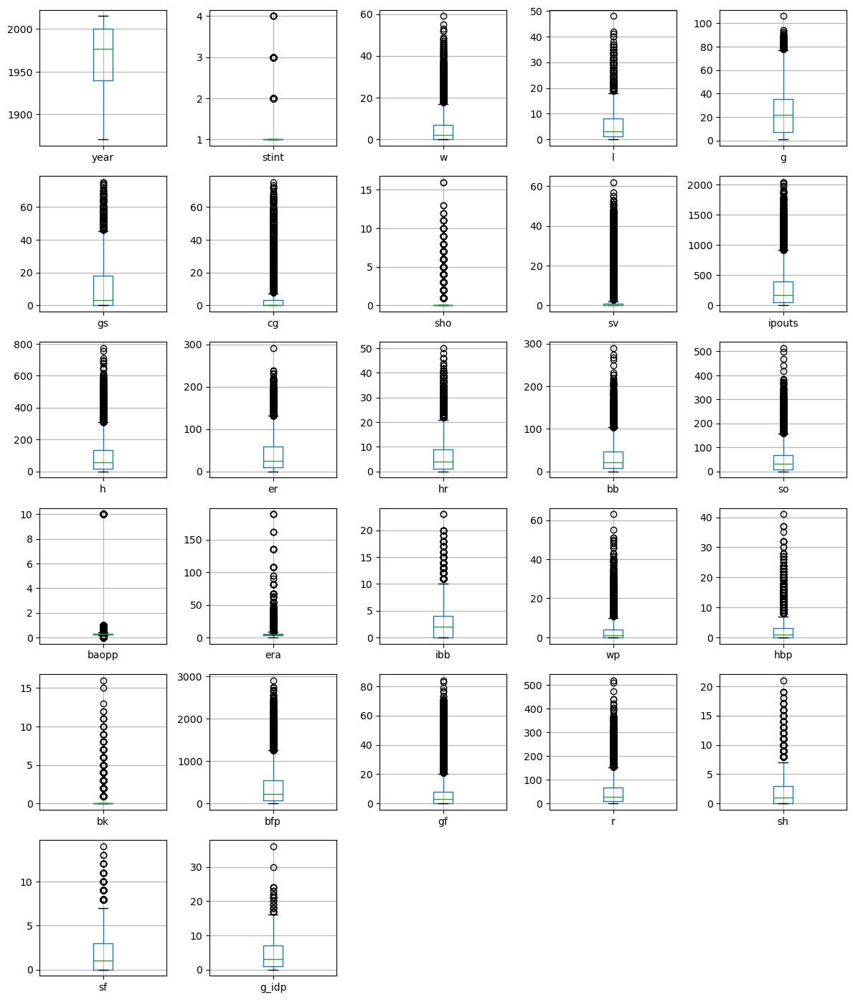

In [35]:
fig, ax = plt.subplots(6, 5, figsize=(12, 14))
ax = ax.flatten()

for i, col in enumerate(num_cols_pitching):
    pitching_data_full.boxplot(col, ax=ax[i])

for i in range(len(num_cols_pitching),30):
    ax[i].axis('off')

plt.tight_layout()
plt.show()

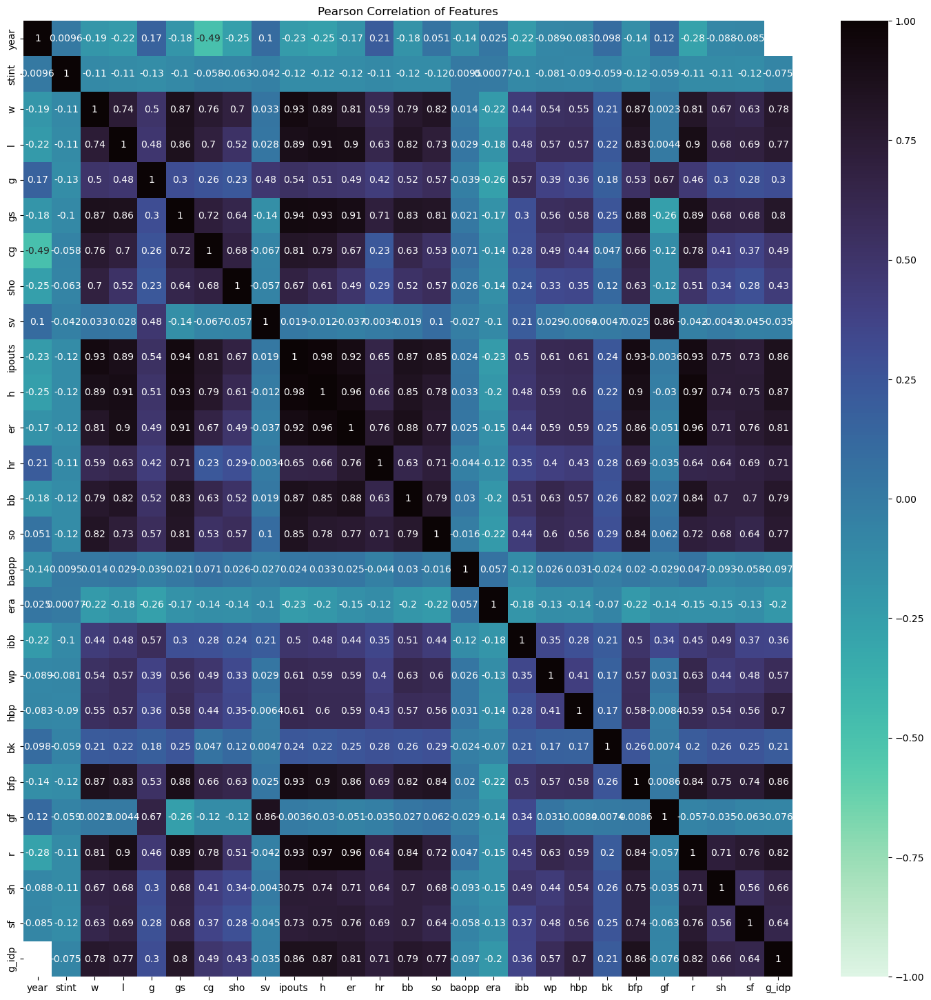

In [36]:
plt.figure(figsize=(18,18))
plt.title('Pearson Correlation of Features', size=12)
ax = sns.heatmap(pitching_data_full[num_cols_pitching].corr(), cmap='mako_r', annot=True, vmin=-1, vmax=1)
plt.show()

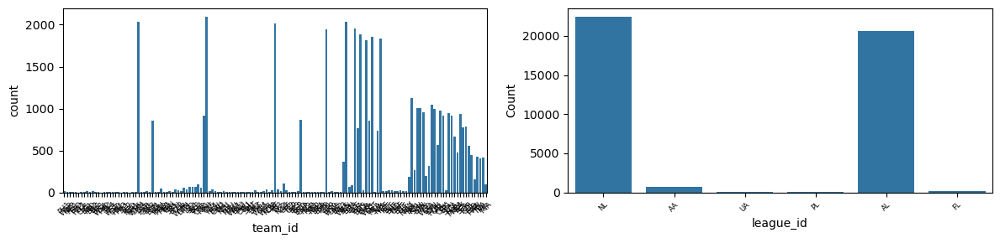

In [37]:
cat_cols_pitching = [c for c in pitching_data_full.columns if pitching_data_full[c].dtypes == 'O' and c != 'player_id']
fig, ax = plt.subplots(1, 2, figsize=(12, 3))
ax = ax.flatten()

for i, col in enumerate(cat_cols_pitching):
    sns.countplot(x=col, data=pitching_data_full, ax=ax[i])
    plt.ylabel('Count')
    ax[i].tick_params(axis='x', rotation=45, labelsize=6)
    
plt.tight_layout()
plt.show()

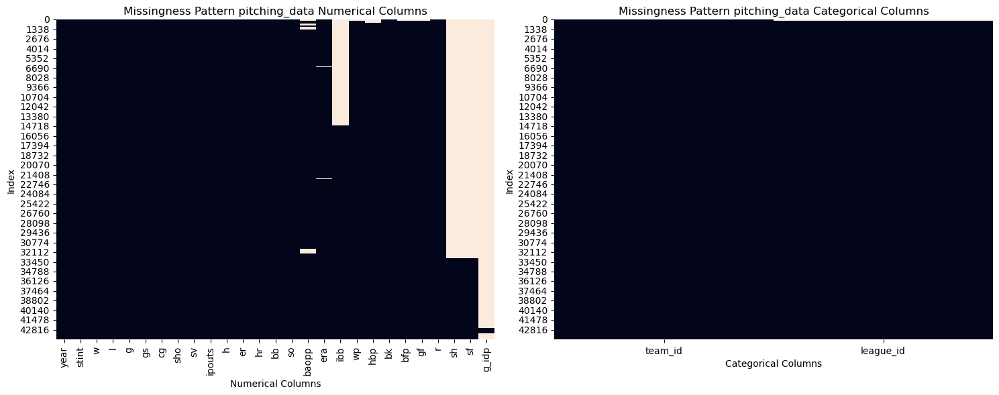

In [38]:
fig, ax = plt.subplots(nrows=1, ncols=2, figsize=(15, 6))

sns.heatmap(pitching_data_full[num_cols_pitching].isnull(), cbar=False, ax=ax[0])
ax[0].set_title('Missingness Pattern pitching_data Numerical Columns')
ax[0].set_xlabel('Numerical Columns')
ax[0].set_ylabel('Index')

sns.heatmap(pitching_data_full[cat_cols_pitching].isnull(), cbar=False, ax=ax[1])
ax[1].set_title('Missingness Pattern pitching_data Categorical Columns')
ax[1].set_xlabel('Categorical Columns')
ax[1].set_ylabel('Index')

plt.tight_layout()
plt.show()

### 1.5 Problem Formulation<a id="part1.5"></a>

As the 2014 MLB season comes to a close, Houston Astros finds themselves with a 70-92 win-loss record. In professional baseball leagues like MLB, small market teams such as Houston Astros often face challenges competing with larger market teams due to financial disparities. To maximise their competitive edge, Houston Astros need to identify undervalued players who can significantly improve their win percentage and overall team success. This project aims to develop a regression model that predicts a team's season win percentage based on the averages of their players' pitching, batting, and fielding statistics. By pinpointing the most impactful metrics, Houston Astros can strategically recruit undervalued players to increase their chances of on-field success, leading to more revenue opportunities.

## 2. Data Wrangling on multiple tables<a id="part2"></a>

### 2.1 Data Wrangling on team_data_full<a id="part2.1"></a>

In [39]:
team_data = team_data_full[(team_data_full['year'] >= 1955) & (team_data_full['year'] != 2015)]

In [40]:
# Old Code
# Using data from 1969 when divisions were introduced and excluding 1994 due to players' strike
# Also tried for all seasons and from 1955 onwards too

#team_data = team_data_full[(team_data_full['year'] >= 1969) & (team_data_full['year'] != 1994)]
#team_data = team_data_full
#team_data = team_data_full[(team_data_full['year'] >= 1955)]

In [41]:
team_data.info()

<class 'pandas.core.frame.DataFrame'>
Index: 1512 entries, 1263 to 2774
Data columns (total 48 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   year              1512 non-null   int64  
 1   league_id         1512 non-null   object 
 2   team_id           1512 non-null   object 
 3   franchise_id      1512 non-null   object 
 4   div_id            1258 non-null   object 
 5   rank              1512 non-null   int64  
 6   g                 1512 non-null   int64  
 7   ghome             1512 non-null   float64
 8   w                 1512 non-null   int64  
 9   l                 1512 non-null   int64  
 10  div_win           1230 non-null   object 
 11  wc_win            594 non-null    object 
 12  lg_win            1484 non-null   object 
 13  ws_win            1484 non-null   object 
 14  r                 1512 non-null   int64  
 15  ab                1512 non-null   int64  
 16  h                 1512 non-null   int64  
 1

In [42]:
team_data = team_data.copy()

team_data['t_Win_Percentage'] = team_data['w'] / team_data['g']

In [43]:
# Old Code where I tried to create a team performance indicator
# Decided against it in the end as it heavily weights teams that have won their league or the world series
# Focusing on objective metrics like Win Percentage provides a more balanced view of team performance

#team_data['Performance_Indicator'] = (
#    0.1 * (1 / team_data['rank']) +   
#    0.15 * team_data['WinPct'] +   
#    0.05 * (team_data['div_win'] == 'Y').astype(int) +     
#    0.25 * (team_data['lg_win'] == 'Y').astype(int) +   
#    0.45 * (team_data['ws_win'] == 'Y').astype(int)
#)

In [44]:
team_data_tomerge = team_data[['year','team_id','t_Win_Percentage']]

In [45]:
team_data_tomerge.head()

,year,team_id,t_Win_Percentage
1263,1955,BAL,0.365385
1264,1955,BOS,0.545455
1265,1955,BRO,0.636364
1266,1955,CHA,0.587097
1267,1955,CHN,0.467532


### 2.2 Data Wrangling on batting_data_full<a id="part2.2"></a>

In [46]:
batting_data = batting_data_full[(batting_data_full['year'] >= 1955) & (batting_data_full['year'] != 2015)]
# Ensuring that players included played a minimum of 15 games for statistical reliability and inclusiveness
batting_data = batting_data[batting_data['g']>=15]

In [47]:
# Old Code
# Using data from 1969 when divisions were introduced and excluding 1994 due to players' strike
# Also tried for all seasons and from 1955 onwards too

#batting_data = batting_data_full[(batting_data_full['year'] >= 1969) & (batting_data_full['year'] != 1994)]
#batting_data = batting_data_full
#batting_data = batting_data_full[(batting_data_full['year'] >= 1955)]

In [48]:
batting_data.info()

<class 'pandas.core.frame.DataFrame'>
Index: 46574 entries, 37447 to 99845
Data columns (total 22 columns):
 #   Column     Non-Null Count  Dtype  
---  ------     --------------  -----  
 0   player_id  46574 non-null  object 
 1   year       46574 non-null  int64  
 2   stint      46574 non-null  int64  
 3   team_id    46574 non-null  object 
 4   league_id  46574 non-null  object 
 5   g          46574 non-null  int64  
 6   ab         43624 non-null  float64
 7   r          43624 non-null  float64
 8   h          43624 non-null  float64
 9   double     43624 non-null  float64
 10  triple     43624 non-null  float64
 11  hr         43624 non-null  float64
 12  rbi        43624 non-null  float64
 13  sb         43624 non-null  float64
 14  cs         43624 non-null  float64
 15  bb         43624 non-null  float64
 16  so         43624 non-null  float64
 17  ibb        43624 non-null  float64
 18  hbp        43624 non-null  float64
 19  sh         43624 non-null  float64
 20  sf     

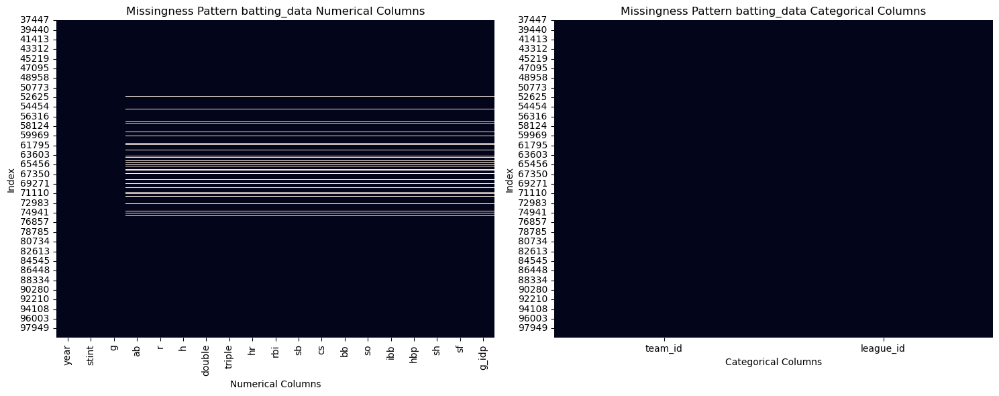

In [49]:
num_cols_batting = [n for n in batting_data.columns if batting_data[n].dtypes!='O']
cat_cols_batting = [c for c in batting_data.columns if batting_data[c].dtypes=='O' and c != 'player_id']

fig, ax = plt.subplots(nrows=1, ncols=2, figsize=(15, 6))

sns.heatmap(batting_data[num_cols_batting].isnull(), cbar=False, ax=ax[0])
ax[0].set_title('Missingness Pattern batting_data Numerical Columns')
ax[0].set_xlabel('Numerical Columns')
ax[0].set_ylabel('Index')

sns.heatmap(batting_data[cat_cols_batting].isnull(), cbar=False, ax=ax[1])
ax[1].set_title('Missingness Pattern batting_data Categorical Columns')
ax[1].set_xlabel('Categorical Columns')
ax[1].set_ylabel('Index')

plt.tight_layout()
plt.show()

In [50]:
batting_data = batting_data.copy()
# Dropped NaNs for this dataframe as the missing statistics were from the same records
batting_data = batting_data.dropna()

In [51]:
batting_data.info()

<class 'pandas.core.frame.DataFrame'>
Index: 43624 entries, 37447 to 99845
Data columns (total 22 columns):
 #   Column     Non-Null Count  Dtype  
---  ------     --------------  -----  
 0   player_id  43624 non-null  object 
 1   year       43624 non-null  int64  
 2   stint      43624 non-null  int64  
 3   team_id    43624 non-null  object 
 4   league_id  43624 non-null  object 
 5   g          43624 non-null  int64  
 6   ab         43624 non-null  float64
 7   r          43624 non-null  float64
 8   h          43624 non-null  float64
 9   double     43624 non-null  float64
 10  triple     43624 non-null  float64
 11  hr         43624 non-null  float64
 12  rbi        43624 non-null  float64
 13  sb         43624 non-null  float64
 14  cs         43624 non-null  float64
 15  bb         43624 non-null  float64
 16  so         43624 non-null  float64
 17  ibb        43624 non-null  float64
 18  hbp        43624 non-null  float64
 19  sh         43624 non-null  float64
 20  sf     

In [52]:
batting_data['b_bat_avg/g'] = (batting_data['h'] / batting_data['ab']) / batting_data['g']
batting_data['b_hits/g'] = batting_data['h'] / batting_data['g']
batting_data['b_atbats/g'] = batting_data['ab'] / batting_data['g']
batting_data['b_runs/g'] = batting_data['r'] / batting_data['g']
batting_data['b_doubles/g'] = batting_data['double'] / batting_data['g']
batting_data['b_triples/g'] = batting_data['triple'] / batting_data['g']
batting_data['b_homeruns/g'] = batting_data['hr'] / batting_data['g']
batting_data['b_runs_batted_in/g'] = batting_data['rbi'] / batting_data['g']
batting_data['b_stolen_bases/g'] = batting_data['sb'] / batting_data['g']
batting_data['b_caught_stealing/g'] = batting_data['cs'] / batting_data['g']
batting_data['b_base_on_balls/g'] = batting_data['bb'] / batting_data['g']
batting_data['b_strikeouts/g'] = batting_data['so'] / batting_data['g']
batting_data['b_intentional_walks/g'] = batting_data['ibb'] / batting_data['g']
batting_data['b_hit_by_pitch/g'] = batting_data['hbp'] / batting_data['g']
batting_data['b_sacrifice_hits/g'] = batting_data['sh'] / batting_data['g']
batting_data['b_sacrifice_flies/g'] = batting_data['sf'] / batting_data['g']
batting_data['b_grounded_id_plays/g'] = batting_data['g_idp'] / batting_data['g']

In [53]:
batting_data_tomerge = batting_data.groupby(['team_id', 'year'], as_index=False).agg({
    'b_bat_avg/g': 'mean',
    'b_hits/g': 'mean',
    'b_atbats/g': 'mean',
    'b_runs/g': 'mean',
    'b_doubles/g': 'mean',
    'b_triples/g': 'mean',
    'b_homeruns/g': 'mean',
    'b_runs_batted_in/g': 'mean',
    'b_stolen_bases/g': 'mean',
    'b_caught_stealing/g': 'mean',
    'b_base_on_balls/g': 'mean',
    'b_strikeouts/g': 'mean',
    'b_intentional_walks/g': 'mean',
    'b_hit_by_pitch/g': 'mean',
    'b_sacrifice_hits/g': 'mean',
    'b_sacrifice_flies/g': 'mean',
    'b_grounded_id_plays/g': 'mean'
})

In [54]:
batting_data_tomerge.head()

,team_id,year,b_bat_avg/g,b_hits/g,b_atbats/g,b_runs/g,b_doubles/g,b_triples/g,b_homeruns/g,b_runs_batted_in/g,b_stolen_bases/g,b_caught_stealing/g,b_base_on_balls/g,b_strikeouts/g,b_intentional_walks/g,b_hit_by_pitch/g,b_sacrifice_hits/g,b_sacrifice_flies/g,b_grounded_id_plays/g
0,ANA,1997,0.002553,0.525006,2.051676,0.295626,0.094147,0.007262,0.058537,0.262491,0.050675,0.024496,0.231383,0.355682,0.012231,0.014421,0.017419,0.018375,0.051850
1,ANA,1998,0.004054,0.511064,1.941993,0.256686,0.102274,0.007916,0.043583,0.237378,0.035468,0.015339,0.177636,0.379926,0.006735,0.016822,0.021399,0.012059,0.042984
2,ANA,1999,0.005181,0.456344,1.869738,0.223107,0.082310,0.007490,0.046907,0.210210,0.024575,0.016612,0.166685,0.358455,0.005247,0.016195,0.019449,0.014533,0.048877
3,ANA,2000,0.005894,0.414458,1.559357,0.227356,0.082305,0.009269,0.059201,0.210059,0.027485,0.014886,0.165830,0.290857,0.009160,0.012307,0.015569,0.011125,0.031323
4,ANA,2001,0.004845,0.456409,1.874119,0.213522,0.079834,0.009303,0.052667,0.199040,0.028909,0.015601,0.141994,0.369203,0.008109,0.021066,0.018959,0.015032,0.043275


### 2.3 Data Wrangling on fielding_data_full<a id="part2.3"></a>

In [55]:
fielding_data = fielding_data_full[(fielding_data_full['year'] >= 1955) & (fielding_data_full['year'] != 2015)]
# Ensuring that players included played a minimum of 15 games for statistical reliability and inclusiveness
fielding_data = fielding_data[fielding_data['g']>=15]

In [56]:
# Old Code
# Using data from 1969 when divisions were introduced and excluding 1994 due to players' strike
# Also tried for all seasons and from 1955 onwards too

#fielding_data = fielding_data_full[(fielding_data_full['year'] >= 1969) & (fielding_data_full['year'] != 1994)]
#fielding_data = fielding_data_full
#fielding_data = fielding_data_full[(fielding_data_full['year'] >= 1955)]

In [57]:
fielding_data.info()

<class 'pandas.core.frame.DataFrame'>
Index: 60973 entries, 52396 to 167937
Data columns (total 18 columns):
 #   Column     Non-Null Count  Dtype  
---  ------     --------------  -----  
 0   player_id  60973 non-null  object 
 1   year       60973 non-null  int64  
 2   stint      60973 non-null  int64  
 3   team_id    60973 non-null  object 
 4   league_id  60973 non-null  object 
 5   pos        60973 non-null  object 
 6   g          60973 non-null  int64  
 7   gs         40622 non-null  float64
 8   inn_outs   56008 non-null  float64
 9   po         56274 non-null  float64
 10  a          56274 non-null  float64
 11  e          56274 non-null  float64
 12  dp         56274 non-null  float64
 13  pb         3952 non-null   float64
 14  wp         2766 non-null   float64
 15  sb         3952 non-null   float64
 16  cs         3952 non-null   float64
 17  zr         2766 non-null   float64
dtypes: float64(11), int64(3), object(4)
memory usage: 8.8+ MB


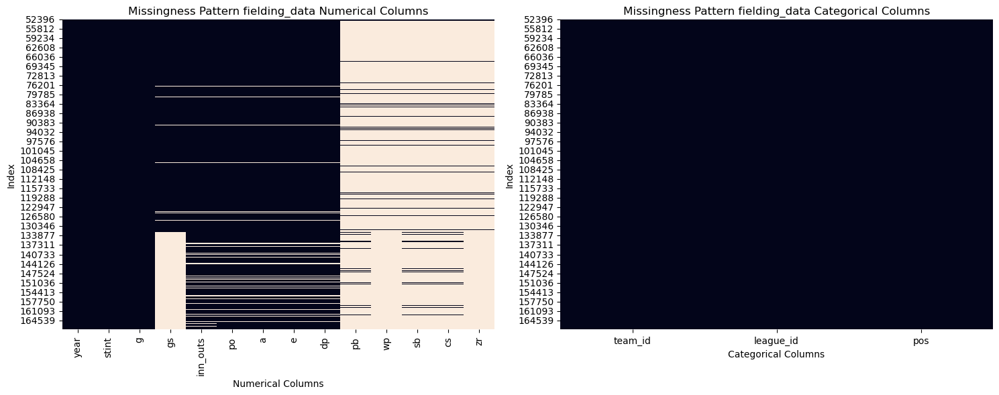

In [58]:
num_cols_fielding = [n for n in fielding_data.columns if fielding_data[n].dtypes!='O']
cat_cols_fielding = [c for c in fielding_data.columns if fielding_data[c].dtypes=='O' and c != 'player_id']

fig, ax = plt.subplots(nrows=1, ncols=2, figsize=(15, 6))

sns.heatmap(fielding_data[num_cols_fielding].isnull(), cbar=False, ax=ax[0])
ax[0].set_title('Missingness Pattern fielding_data Numerical Columns')
ax[0].set_xlabel('Numerical Columns')
ax[0].set_ylabel('Index')

sns.heatmap(fielding_data[cat_cols_fielding].isnull(), cbar=False, ax=ax[1])
ax[1].set_title('Missingness Pattern fielding_data Categorical Columns')
ax[1].set_xlabel('Categorical Columns')
ax[1].set_ylabel('Index')

plt.tight_layout()
plt.show()

In [59]:
fielding_data = fielding_data.copy()
# Dropped NaNs for specific columns in dataframe as the missing statistics were from the same records
fielding_data = fielding_data.dropna(subset=['po', 'a', 'e', 'dp'], how='all')
fielding_data = fielding_data.drop(columns=['gs','pb','wp','sb','cs','zr'])

In [60]:
fielding_data.info()

<class 'pandas.core.frame.DataFrame'>
Index: 56274 entries, 52396 to 167937
Data columns (total 12 columns):
 #   Column     Non-Null Count  Dtype  
---  ------     --------------  -----  
 0   player_id  56274 non-null  object 
 1   year       56274 non-null  int64  
 2   stint      56274 non-null  int64  
 3   team_id    56274 non-null  object 
 4   league_id  56274 non-null  object 
 5   pos        56274 non-null  object 
 6   g          56274 non-null  int64  
 7   inn_outs   56008 non-null  float64
 8   po         56274 non-null  float64
 9   a          56274 non-null  float64
 10  e          56274 non-null  float64
 11  dp         56274 non-null  float64
dtypes: float64(5), int64(3), object(4)
memory usage: 5.6+ MB


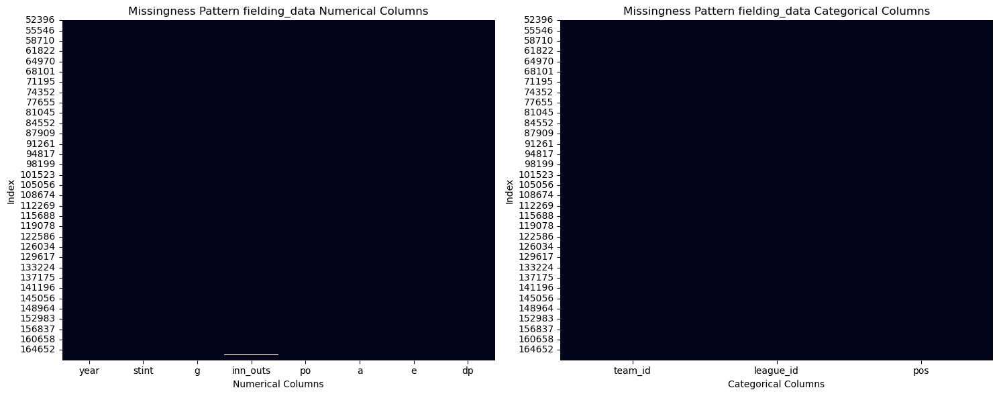

In [61]:
num_cols_fielding = [n for n in fielding_data.columns if fielding_data[n].dtypes!='O']
cat_cols_fielding = [c for c in fielding_data.columns if fielding_data[c].dtypes=='O' and c != 'player_id']

fig, ax = plt.subplots(nrows=1, ncols=2, figsize=(15, 6))

sns.heatmap(fielding_data[num_cols_fielding].isnull(), cbar=False, ax=ax[0])
ax[0].set_title('Missingness Pattern fielding_data Numerical Columns')
ax[0].set_xlabel('Numerical Columns')
ax[0].set_ylabel('Index')

sns.heatmap(fielding_data[cat_cols_fielding].isnull(), cbar=False, ax=ax[1])
ax[1].set_title('Missingness Pattern fielding_data Categorical Columns')
ax[1].set_xlabel('Categorical Columns')
ax[1].set_ylabel('Index')

plt.tight_layout()
plt.show()

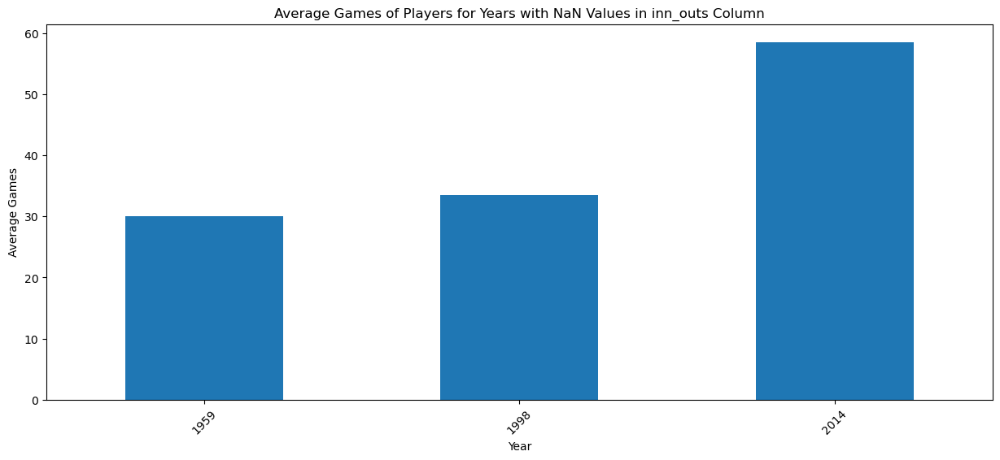

In [62]:
# Filtering rows with NaNs specifically in the 'inn_outs' column
rows_with_nan_inn_outs = fielding_data[fielding_data['inn_outs'].isnull()]

# Calculating the average of the 'g' column for each year where 'inn_outs' is NaN
average_g_per_year = rows_with_nan_inn_outs.groupby('year')['g'].mean()

# Plotting the averages
average_g_per_year.plot(kind='bar', figsize=(15, 6))
plt.title('Average Games of Players for Years with NaN Values in inn_outs Column')
plt.xlabel('Year')
plt.ylabel('Average Games')
plt.xticks(rotation=45)
plt.show()

In [63]:
# Filtering rows where any of the specified columns have null values
frows_with_nulls = fielding_data[fielding_data.isnull().any(axis=1)]

# Calculating the total number of rows for each year and null values for each year
ftotal_rows_per_year = fielding_data.groupby('year').size()
fnull_rows_per_year = frows_with_nulls.groupby('year').size()

# Calculating the percentage of null values for each year and excluding nans
fpercentage_nulls_per_year = ((fnull_rows_per_year / ftotal_rows_per_year) * 100).dropna()

print(fpercentage_nulls_per_year)

year
1959     0.173010
1998     0.166806
2014    20.061022
dtype: float64


In [64]:
years_to_impute_mean = [1959, 1998, 2014]

# Calculating the mean 'inn_outs' per game ('g') for each of the specified years
mean_inn_outs_per_game = (fielding_data[fielding_data['year'].isin(years_to_impute_mean)]
                          .groupby('year')
                          .apply(lambda x: x['inn_outs'].mean() / x['g'].mean())
                          .to_dict())

# Imputing mean 'inn_outs' per game for specific years where 'inn_outs' is null
def impute_mean_inn_outs_per_game(df, years, column, mean_values):
    df_copy = df.copy()
    for year in years:
        # Filtering rows for the specific year and where 'inn_outs' is null
        # Next, I imputed the mean
        mask = (df_copy['year'] == year) & df_copy[column].isnull()
        df_copy.loc[mask, column] = mean_values[year] * df_copy.loc[mask, 'g']
    return df_copy

fielding_data = impute_mean_inn_outs_per_game(fielding_data, years_to_impute_mean, 'inn_outs', mean_inn_outs_per_game)

C:\Users\Hongk\AppData\Local\Temp\ipykernel_25416\3556895621.py:6: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  .apply(lambda x: x['inn_outs'].mean() / x['g'].mean())


In [65]:
# Old Code (Tested Mode and Median) (The function name is impute_mean_inn_outs_per_game(df, years, column, mean_values): as I didn't want to change it)

# Calculating the median 'inn_outs' per game ('g') for each of the specified years
#median_inn_outs_per_game = (fielding_data[fielding_data['year'].isin(years_to_impute_mean)]
#                            .groupby('year')
#                            .apply(lambda x: x['inn_outs'].median() / x['g'].median())
#                            .to_dict())

# Imputing median 'inn_outs' per game for specific years where 'inn_outs' is null
#fielding_data = impute_mean_inn_outs_per_game(fielding_data, years_to_impute_mean, 'inn_outs', median_inn_outs_per_game)

# Calculating the mode 'inn_outs' per game ('g') for each of the specified years
#mode_inn_outs_per_game = (fielding_data[fielding_data['year'].isin(years_to_impute_mean)]
#                          .groupby('year')
#                          .apply(lambda x: (x['inn_outs'] / x['g']).mode()[0])
#                          .to_dict())

# Imputing mode 'inn_outs' per game for specific years where 'inn_outs' is null
#fielding_data = impute_mean_inn_outs_per_game(fielding_data, years_to_impute_mean, 'inn_outs', mode_inn_outs_per_game)

In [66]:
# Filtering rows where any of the specified columns have null values
frows_with_nulls = fielding_data[fielding_data.isnull().any(axis=1)]

# Calculating the total number of rows for each year and null values for each year
ftotal_rows_per_year = fielding_data.groupby('year').size()
fnull_rows_per_year = frows_with_nulls.groupby('year').size()

# Calculating the percentage of null values for each year and excluding nans
fpercentage_nulls_per_year = ((fnull_rows_per_year / ftotal_rows_per_year) * 100).dropna()

print(fpercentage_nulls_per_year)

Series([], dtype: float64)


In [67]:
fielding_data.info()

<class 'pandas.core.frame.DataFrame'>
Index: 56274 entries, 52396 to 167937
Data columns (total 12 columns):
 #   Column     Non-Null Count  Dtype  
---  ------     --------------  -----  
 0   player_id  56274 non-null  object 
 1   year       56274 non-null  int64  
 2   stint      56274 non-null  int64  
 3   team_id    56274 non-null  object 
 4   league_id  56274 non-null  object 
 5   pos        56274 non-null  object 
 6   g          56274 non-null  int64  
 7   inn_outs   56274 non-null  float64
 8   po         56274 non-null  float64
 9   a          56274 non-null  float64
 10  e          56274 non-null  float64
 11  dp         56274 non-null  float64
dtypes: float64(5), int64(3), object(4)
memory usage: 5.6+ MB


In [68]:
fielding_data['f_time_played_as_outs/g'] = fielding_data['inn_outs'] / fielding_data['g']
fielding_data['f_putouts/g'] = fielding_data['po'] / fielding_data['g']
fielding_data['f_assists/g'] = fielding_data['a'] / fielding_data['g']
fielding_data['f_errors/g'] = fielding_data['e'] / fielding_data['g']
fielding_data['f_double_plays/g'] = fielding_data['dp'] / fielding_data['g']

In [69]:
fielding_data_grouped = fielding_data.groupby(['team_id', 'year'], as_index=False).agg({                                     
    'f_time_played_as_outs/g': 'mean',
    'f_putouts/g': 'mean',
    'f_assists/g': 'mean',
    'f_errors/g': 'mean',                   
    'f_double_plays/g': 'mean'            
})

fielding_data_grouped['f_fielding_percentage'] = ((fielding_data_grouped['f_putouts/g'] + fielding_data_grouped['f_assists/g']) /
                            (fielding_data_grouped['f_putouts/g'] + fielding_data_grouped['f_assists/g'] + fielding_data_grouped['f_errors/g']))

fielding_data_tomerge = fielding_data_grouped

In [70]:
fielding_data_tomerge.head()

,team_id,year,f_time_played_as_outs/g,f_putouts/g,f_assists/g,f_errors/g,f_double_plays/g,f_fielding_percentage
0,ANA,1997,17.928612,1.880474,0.591292,0.046454,0.148485,0.981553
1,ANA,1998,17.945930,1.756693,0.569468,0.038265,0.119025,0.983816
2,ANA,1999,18.492295,1.955927,0.627207,0.043890,0.153559,0.983293
3,ANA,2000,15.583132,1.447916,0.652454,0.048788,0.153829,0.977299
4,ANA,2001,17.126348,2.204147,0.710261,0.046253,0.186504,0.984377


### 2.4 Data Wrangling on pitching_data_full<a id="part2.4"></a>

In [71]:
pitching_data = pitching_data_full[(pitching_data_full['year'] >= 1955) & (pitching_data_full['year'] != 2015)]
# Ensuring that players included played a minimum of 15 games for statistical reliability and inclusiveness
pitching_data = pitching_data[pitching_data['g']>=15]

In [72]:
# Old Code
# Using data from 1969 when divisions were introduced and excluding 1994 due to players' strike
# Also tried for all seasons and from 1955 onwards too

#pitching_data = pitching_data_full[(pitching_data_full['year'] >= 1969) & (pitching_data_full['year'] != 1994)]
#pitching_data = pitching_data_full
#pitching_data = pitching_data_full[(pitching_data_full['year'] >= 1955)]

In [73]:
pitching_data.info()

<class 'pandas.core.frame.DataFrame'>
Index: 18468 entries, 14575 to 43329
Data columns (total 30 columns):
 #   Column     Non-Null Count  Dtype  
---  ------     --------------  -----  
 0   player_id  18468 non-null  object 
 1   year       18468 non-null  int64  
 2   stint      18468 non-null  int64  
 3   team_id    18468 non-null  object 
 4   league_id  18468 non-null  object 
 5   w          18468 non-null  int64  
 6   l          18468 non-null  int64  
 7   g          18468 non-null  int64  
 8   gs         18468 non-null  int64  
 9   cg         18468 non-null  int64  
 10  sho        18468 non-null  int64  
 11  sv         18468 non-null  int64  
 12  ipouts     18468 non-null  float64
 13  h          18468 non-null  int64  
 14  er         18468 non-null  int64  
 15  hr         18468 non-null  int64  
 16  bb         18468 non-null  int64  
 17  so         18468 non-null  int64  
 18  baopp      18065 non-null  float64
 19  era        18468 non-null  float64
 20  ibb    

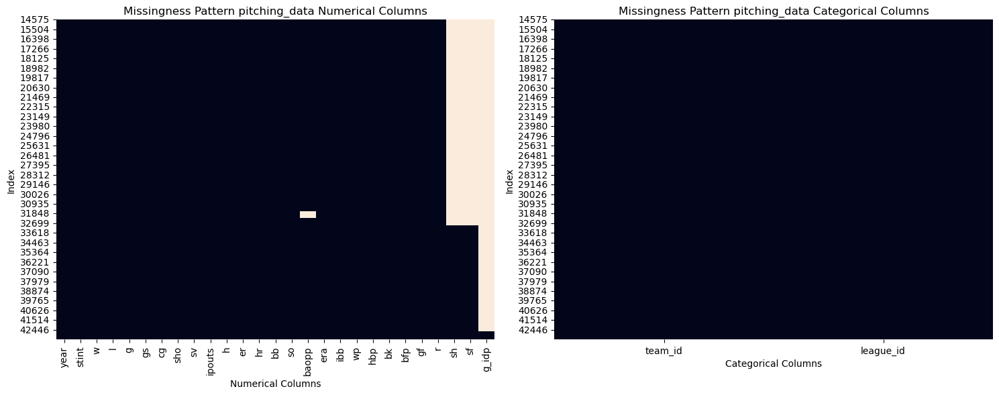

In [74]:
num_cols_pitching = [n for n in pitching_data.columns if pitching_data[n].dtypes!='O']
cat_cols_pitching = [c for c in pitching_data.columns if pitching_data[c].dtypes == 'O' and c != 'player_id']

fig, ax = plt.subplots(nrows=1, ncols=2, figsize=(15, 6))

sns.heatmap(pitching_data[num_cols_pitching].isnull(), cbar=False, ax=ax[0])
ax[0].set_title('Missingness Pattern pitching_data Numerical Columns')
ax[0].set_xlabel('Numerical Columns')
ax[0].set_ylabel('Index')

sns.heatmap(pitching_data[cat_cols_pitching].isnull(), cbar=False, ax=ax[1])
ax[1].set_title('Missingness Pattern pitching_data Categorical Columns')
ax[1].set_xlabel('Categorical Columns')
ax[1].set_ylabel('Index')

plt.tight_layout()
plt.show()

In [75]:
pitching_data = pitching_data.copy()
# Dropped columns as they had an extremely high percentage of null values
pitching_data = pitching_data.drop(columns=['sh','sf','g_idp'])

In [76]:
pitching_data.isnull().mean()

player_id    0.000000
year         0.000000
stint        0.000000
team_id      0.000000
league_id    0.000000
w            0.000000
l            0.000000
g            0.000000
gs           0.000000
cg           0.000000
sho          0.000000
sv           0.000000
ipouts       0.000000
h            0.000000
er           0.000000
hr           0.000000
bb           0.000000
so           0.000000
baopp        0.021822
era          0.000000
ibb          0.000000
wp           0.000000
hbp          0.000000
bk           0.000000
bfp          0.000000
gf           0.000000
r            0.000000
dtype: float64

In [77]:
average_baopp_per_year = pitching_data.groupby('year')['baopp'].mean()

print(average_baopp_per_year)

year
1955    0.255176
1956    0.256626
1957    0.254286
1958    0.254940
1959    0.253711
1960    0.252976
1961    0.253859
1962    0.255530
1963    0.243942
1964    0.247406
1965    0.242500
1966    0.246806
1967    0.238977
1968    0.234601
1969    0.246420
1970    0.249668
1971    0.246917
1972    0.241753
1973    0.255242
1974    0.254549
1975    0.254653
1976    0.253198
1977    0.260076
1978    0.254569
1979    0.262158
1980    0.258155
1981    0.250042
1982    0.257050
1983    0.253810
1984    0.255171
1985    0.251926
1986    0.255182
1987    0.258783
1988    0.249760
1989    0.246791
1990    0.252353
1991    0.248631
1992    0.251429
1993    0.259382
1994    0.250607
1995    0.250387
1996    0.229816
1997    0.259726
1998         NaN
1999    0.000000
2000    0.265040
2001    0.260469
2002    0.257032
2003    0.259960
2004    0.261856
2005    0.261228
2006    0.265739
2007    0.262411
2008    0.258327
2009    0.257164
2010    0.253441
2011    0.249855
2012    0.247219
2013    0

In [78]:
# 'baopp' values fully null in 1998, all 0s in 1999. 
# Imputing the same values for each player the year 1998 and 1999 would be pointless after grouping by 

pitching_data = pitching_data.drop(columns=['baopp'])

In [79]:
pitching_data.info()

<class 'pandas.core.frame.DataFrame'>
Index: 18468 entries, 14575 to 43329
Data columns (total 26 columns):
 #   Column     Non-Null Count  Dtype  
---  ------     --------------  -----  
 0   player_id  18468 non-null  object 
 1   year       18468 non-null  int64  
 2   stint      18468 non-null  int64  
 3   team_id    18468 non-null  object 
 4   league_id  18468 non-null  object 
 5   w          18468 non-null  int64  
 6   l          18468 non-null  int64  
 7   g          18468 non-null  int64  
 8   gs         18468 non-null  int64  
 9   cg         18468 non-null  int64  
 10  sho        18468 non-null  int64  
 11  sv         18468 non-null  int64  
 12  ipouts     18468 non-null  float64
 13  h          18468 non-null  int64  
 14  er         18468 non-null  int64  
 15  hr         18468 non-null  int64  
 16  bb         18468 non-null  int64  
 17  so         18468 non-null  int64  
 18  era        18468 non-null  float64
 19  ibb        18468 non-null  float64
 20  wp     

In [80]:
pitching_data['p_complete_games/g'] = pitching_data['cg'] / pitching_data['g']
pitching_data['p_shutouts/g'] = pitching_data['sho'] / pitching_data['g']
pitching_data['p_saves/g'] = pitching_data['sv'] / pitching_data['g']
pitching_data['p_outs_pitched/g'] = pitching_data['ipouts'] / pitching_data['g']
pitching_data['p_hits/g'] = pitching_data['h'] / pitching_data['g']
pitching_data['p_earned_runs/g'] = pitching_data['er'] / pitching_data['g']
pitching_data['p_homeruns/g'] = pitching_data['hr'] / pitching_data['g']
pitching_data['p_walks/g'] = pitching_data['bb'] / pitching_data['g']
pitching_data['p_strikeouts/g'] = pitching_data['so'] / pitching_data['g']
pitching_data['p_earned_run_average/g'] = pitching_data['era'] / pitching_data['g']
pitching_data['p_intentional_walks/g'] = pitching_data['ibb'] / pitching_data['g']
pitching_data['p_wild_pitches/g'] = pitching_data['wp'] / pitching_data['g']
pitching_data['p_batters_hit_by_pitch/g'] = pitching_data['hbp'] / pitching_data['g']
pitching_data['p_balks/g'] = pitching_data['bk'] / pitching_data['g']
pitching_data['p_batters_faced/g'] = pitching_data['bfp'] / pitching_data['g']
pitching_data['p_games_finished/g'] = pitching_data['gf'] / pitching_data['g']
pitching_data['p_runs_allowed/g'] = pitching_data['r'] / pitching_data['g']

In [81]:
pitching_data_tomerge = pitching_data.groupby(['team_id', 'year'], as_index=False).agg({
    'p_complete_games/g': 'mean',
    'p_shutouts/g': 'mean',
    'p_saves/g': 'mean',
    'p_outs_pitched/g': 'mean',
    'p_hits/g': 'mean',
    'p_earned_runs/g': 'mean',
    'p_homeruns/g': 'mean',
    'p_walks/g': 'mean',
    'p_strikeouts/g': 'mean',
    'p_earned_run_average/g': 'mean',
    'p_intentional_walks/g': 'mean',
    'p_wild_pitches/g': 'mean',
    'p_batters_hit_by_pitch/g': 'mean',
    'p_balks/g': 'mean',
    'p_batters_faced/g': 'mean',
    'p_games_finished/g': 'mean',
    'p_runs_allowed/g': 'mean'
})

In [82]:
pitching_data_tomerge.head()

,team_id,year,p_complete_games/g,p_shutouts/g,p_saves/g,p_outs_pitched/g,p_hits/g,p_earned_runs/g,p_homeruns/g,p_walks/g,p_strikeouts/g,p_earned_run_average/g,p_intentional_walks/g,p_wild_pitches/g,p_batters_hit_by_pitch/g,p_balks/g,p_batters_faced/g,p_games_finished/g,p_runs_allowed/g
0,ANA,1997,0.022863,0.008463,0.061068,8.699534,2.956340,1.432045,0.409462,1.127542,2.082287,0.119706,0.061509,0.123357,0.116571,0.015620,12.576046,0.255554,1.549213
1,ANA,1998,0.006582,0.002101,0.057323,9.119088,3.177303,1.524072,0.329301,1.329248,2.169994,0.150783,0.040602,0.124282,0.108239,0.006064,13.360786,0.207474,1.655004
2,ANA,1999,0.012020,0.000000,0.047569,9.162571,3.187218,1.642571,0.372123,1.329656,1.765536,0.169072,0.030501,0.134308,0.105938,0.005077,13.376812,0.242249,1.779180
3,ANA,2000,0.014321,0.006914,0.055378,8.728415,3.147421,1.713543,0.483894,1.427881,1.697696,0.200852,0.076080,0.102055,0.073288,0.026010,13.014745,0.232000,1.844212
4,ANA,2001,0.016365,0.000000,0.063410,9.759867,3.351293,1.571211,0.381519,1.150453,2.053222,0.116228,0.095918,0.090591,0.149084,0.004092,14.035258,0.230675,1.694103


### 2.5 Merging Tables<a id="part2.5"></a>

In [83]:
baseball_data = pd.merge(team_data_tomerge, batting_data_tomerge, on=['team_id', 'year'], how='inner')

baseball_data = pd.merge(baseball_data, fielding_data_tomerge, on=['team_id', 'year'], how='inner')

baseball_data = pd.merge(baseball_data, pitching_data_tomerge, on=['team_id', 'year'], how='inner')

In [84]:
# Putting target column as the last column (Industry norm as said by Mr Joey)
cols = baseball_data.columns.tolist()

cols.remove('t_Win_Percentage')  
cols.append('t_Win_Percentage') 
baseball_data = baseball_data[cols]

In [85]:
baseball_data.to_csv('baseball_data_averages.csv', index=False)  

### 2.6 Applying Mathematical Calculations<a id="part2.6"></a>

In [86]:
# Dividing each value with the mean for that particular to obtain a relative scale
div_columns = baseball_data.columns.difference(['year','team_id', 't_Win_Percentage'])
yearly_averages = baseball_data.groupby('year')[div_columns].mean()

def divide_by_average(row):
    year = row['year']
    for col in div_columns:
        row[col] = row[col] / yearly_averages.loc[year, col]
    return row

baseball_data = baseball_data.apply(divide_by_average, axis=1)

In [87]:
baseball_data.to_csv('baseball_data.csv', index=False)  

## 3. Data Cleansing and Transformation<a id="part3"></a>

### 3.1 Exploring baseball_data<a id="part3.1"></a>

In [88]:
baseball_data.head()

,year,team_id,b_bat_avg/g,b_hits/g,b_atbats/g,b_runs/g,b_doubles/g,b_triples/g,b_homeruns/g,b_runs_batted_in/g,...,p_strikeouts/g,p_earned_run_average/g,p_intentional_walks/g,p_wild_pitches/g,p_batters_hit_by_pitch/g,p_balks/g,p_batters_faced/g,p_games_finished/g,p_runs_allowed/g,t_Win_Percentage
0,1955,BAL,0.948324,0.898021,0.981893,0.797353,0.806354,0.817806,0.382889,0.750476,...,0.832739,1.275437,0.508209,1.672395,0.686960,0.000000,0.952081,1.151850,1.016901,0.365385
1,1955,BOS,1.223469,1.115633,1.083901,1.179554,1.352743,1.247190,1.076691,1.162633,...,1.025579,0.905280,0.963246,1.029656,1.134555,2.874398,1.079302,1.082395,0.990829,0.545455
2,1955,BRO,0.877074,1.062500,1.025636,1.221527,1.241956,0.992910,1.456900,1.281928,...,1.196801,0.929173,0.851848,1.189845,0.609425,0.000000,1.034659,0.914752,1.010745,0.636364
3,1955,CHA,1.253581,0.966143,0.939396,1.024878,0.941913,0.723382,0.827441,1.035662,...,1.176657,0.915969,0.897082,0.614568,0.830470,1.565220,1.064720,0.870603,0.910687,0.587097
4,1955,CHN,0.999528,0.971260,0.996825,0.923834,0.945835,1.152953,1.216886,0.903520,...,0.986738,1.063108,1.300203,1.047356,0.844260,0.000000,0.998038,1.018668,1.037316,0.467532


In [89]:
baseball_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1512 entries, 0 to 1511
Data columns (total 43 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   year                      1512 non-null   int64  
 1   team_id                   1512 non-null   object 
 2   b_bat_avg/g               1512 non-null   float64
 3   b_hits/g                  1512 non-null   float64
 4   b_atbats/g                1512 non-null   float64
 5   b_runs/g                  1512 non-null   float64
 6   b_doubles/g               1512 non-null   float64
 7   b_triples/g               1512 non-null   float64
 8   b_homeruns/g              1512 non-null   float64
 9   b_runs_batted_in/g        1512 non-null   float64
 10  b_stolen_bases/g          1512 non-null   float64
 11  b_caught_stealing/g       1512 non-null   float64
 12  b_base_on_balls/g         1512 non-null   float64
 13  b_strikeouts/g            1512 non-null   float64
 14  b_intent

In [90]:
baseball_data.describe()

,year,b_bat_avg/g,b_hits/g,b_atbats/g,b_runs/g,b_doubles/g,b_triples/g,b_homeruns/g,b_runs_batted_in/g,b_stolen_bases/g,...,p_strikeouts/g,p_earned_run_average/g,p_intentional_walks/g,p_wild_pitches/g,p_batters_hit_by_pitch/g,p_balks/g,p_batters_faced/g,p_games_finished/g,p_runs_allowed/g,t_Win_Percentage
count,1512.000000,1512.000000,1512.000000,1512.000000,1512.000000,1512.000000,1512.000000,1512.000000,1512.000000,1512.000000,...,1512.000000,1512.000000,1512.000000,1512.000000,1512.000000,1512.000000,1512.000000,1512.000000,1512.000000,1512.000000
mean,1987.400794,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,...,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,0.499531
std,16.721234,0.182801,0.145297,0.120930,0.174306,0.177535,0.314683,0.271575,0.176799,0.355440,...,0.143531,0.195448,0.347599,0.258441,0.269910,0.574282,0.087048,0.104780,0.112316,0.071168
min,1955.000000,0.417806,0.655072,0.659607,0.558448,0.479391,0.336718,0.353410,0.542441,0.264149,...,0.648609,0.531742,0.170051,0.362675,0.340832,0.000000,0.717219,0.576107,0.663372,0.248447
25%,1974.000000,0.877026,0.907302,0.918522,0.876501,0.879964,0.777464,0.810446,0.874838,0.753017,...,0.896884,0.862408,0.743525,0.823010,0.814918,0.577048,0.942431,0.926370,0.920351,0.450617
50%,1988.000000,0.983761,0.993307,0.995772,0.998182,0.984221,0.963410,0.974967,0.996697,0.954186,...,0.990315,0.990202,0.972468,0.973600,0.974061,0.907927,0.998992,0.999815,0.996285,0.500000
75%,2002.000000,1.114545,1.076803,1.060166,1.101168,1.099989,1.190191,1.164958,1.105285,1.200473,...,1.095680,1.118816,1.221491,1.151716,1.167510,1.346683,1.056695,1.068047,1.070454,0.549652
max,2014.000000,2.078932,1.521164,1.415012,1.695645,1.632146,2.379413,2.421295,1.731721,2.875964,...,1.607474,1.812814,2.344125,2.009911,2.189287,3.563020,1.397467,1.435370,1.433655,0.716049


In [91]:
baseball_data.isnull().sum()

year                        0
team_id                     0
b_bat_avg/g                 0
b_hits/g                    0
b_atbats/g                  0
b_runs/g                    0
b_doubles/g                 0
b_triples/g                 0
b_homeruns/g                0
b_runs_batted_in/g          0
b_stolen_bases/g            0
b_caught_stealing/g         0
b_base_on_balls/g           0
b_strikeouts/g              0
b_intentional_walks/g       0
b_hit_by_pitch/g            0
b_sacrifice_hits/g          0
b_sacrifice_flies/g         0
b_grounded_id_plays/g       0
f_time_played_as_outs/g     0
f_putouts/g                 0
f_assists/g                 0
f_errors/g                  0
f_double_plays/g            0
f_fielding_percentage       0
p_complete_games/g          0
p_shutouts/g                0
p_saves/g                   0
p_outs_pitched/g            0
p_hits/g                    0
p_earned_runs/g             0
p_homeruns/g                0
p_walks/g                   0
p_strikeou

In [92]:
baseball_data.nunique().sort_values()

team_id                       42
year                          60
t_Win_Percentage             330
p_shutouts/g                1400
p_balks/g                   1477
p_complete_games/g          1501
b_hits/g                    1512
p_saves/g                   1512
p_outs_pitched/g            1512
p_hits/g                    1512
p_earned_runs/g             1512
p_homeruns/g                1512
p_walks/g                   1512
p_strikeouts/g              1512
p_earned_run_average/g      1512
p_intentional_walks/g       1512
p_wild_pitches/g            1512
p_batters_hit_by_pitch/g    1512
p_batters_faced/g           1512
p_games_finished/g          1512
f_fielding_percentage       1512
f_double_plays/g            1512
f_errors/g                  1512
p_runs_allowed/g            1512
b_atbats/g                  1512
b_runs/g                    1512
b_doubles/g                 1512
b_triples/g                 1512
b_homeruns/g                1512
b_runs_batted_in/g          1512
b_stolen_b

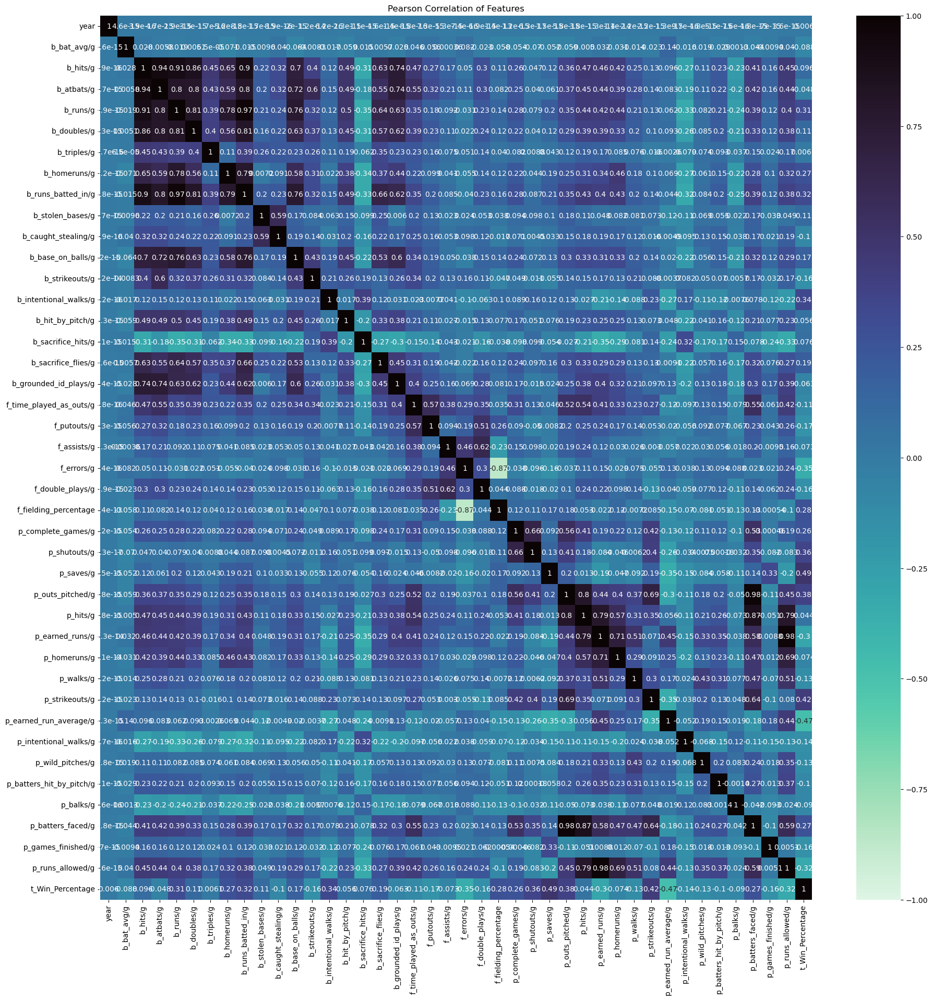

In [93]:
num_cols = [n for n in baseball_data.columns if baseball_data[n].dtypes!='O']
corr_matrix = baseball_data[num_cols].corr()

plt.figure(figsize=(22,22))
plt.title('Pearson Correlation of Features', size=12)
ax = sns.heatmap(corr_matrix, cmap='mako_r', annot=True, vmin=-1, vmax=1)
plt.show()

### 3.2 Addressing Multicollinearity<a id="part3.2"></a>

In [94]:
# Finding pairs of features with correlation greater than the threshold
high_corr_pairs = set()
for col1 in corr_matrix.columns:
    for col2 in corr_matrix.columns:
        if col1 != col2 and abs(corr_matrix.loc[col1, col2]) > 0.7:
            # Adding sorted pairs to the set to ensure uniqueness as there was repeat for both sides previously
            pair = tuple(sorted([col1, col2]))
            high_corr_pairs.add(pair)

# Print the unique pairs
print("Unique pairs of columns with multicollinearity issues:")
for pair in high_corr_pairs:
    print(pair)

Unique pairs of columns with multicollinearity issues:
('b_base_on_balls/g', 'b_runs/g')
('b_base_on_balls/g', 'b_hits/g')
('p_hits/g', 'p_runs_allowed/g')
('b_doubles/g', 'b_runs_batted_in/g')
('b_homeruns/g', 'b_runs_batted_in/g')
('b_atbats/g', 'b_runs/g')
('b_atbats/g', 'b_grounded_id_plays/g')
('b_atbats/g', 'b_hits/g')
('b_base_on_balls/g', 'b_runs_batted_in/g')
('b_hits/g', 'b_runs/g')
('b_grounded_id_plays/g', 'b_hits/g')
('p_batters_faced/g', 'p_hits/g')
('b_atbats/g', 'b_runs_batted_in/g')
('b_hits/g', 'b_runs_batted_in/g')
('b_atbats/g', 'b_doubles/g')
('p_hits/g', 'p_outs_pitched/g')
('p_earned_runs/g', 'p_homeruns/g')
('p_earned_runs/g', 'p_runs_allowed/g')
('p_earned_runs/g', 'p_hits/g')
('p_batters_faced/g', 'p_outs_pitched/g')
('f_errors/g', 'f_fielding_percentage')
('b_atbats/g', 'b_base_on_balls/g')
('b_runs/g', 'b_runs_batted_in/g')
('b_doubles/g', 'b_runs/g')
('b_homeruns/g', 'b_runs/g')
('b_doubles/g', 'b_hits/g')


In [95]:
# Dropping some columns due to multicollinearity issues and some newly created features not improving models
# Before dropping, also compared the dropped column with dropping the features highly correlated to it (LOTS of Testing)
# Dropped column year and team_id too
baseball_data = baseball_data.drop(columns=['year','team_id','f_fielding_percentage','b_hits/g',
                                           'b_atbats/g','p_outs_pitched/g','b_base_on_balls/g','b_doubles/g','b_homeruns/g',
                                           'p_earned_runs/g','p_hits/g', 'b_runs_batted_in/g'])

In [96]:
# Old Code from testing (Parts of it that were not deleted)

# Dropping one variable from each pair and reassigning to baseball_data
#baseball_data = baseball_data.drop(columns=['b_homeruns/g'])
#baseball_data = baseball_data.drop(columns=['b_runs/g'])
#baseball_data = baseball_data.drop(columns=['b_hits/g'])
#baseball_data = baseball_data.drop(columns=['b_runs_batted_in/g'])
#baseball_data = baseball_data.drop(columns=['p_batters_faced/g'])
#baseball_data = baseball_data.drop(columns=['b_homeruns/g'])
#baseball_data = baseball_data.drop(columns=['p_hits/g'])
#baseball_data = baseball_data.drop(columns=['b_grounded_id_plays/g'])
#baseball_data = baseball_data.drop(columns=['b_base_on_balls/g'])
#baseball_data = baseball_data.drop(columns=['b_atbats/g'])
#baseball_data = baseball_data.drop(columns=['b_doubles/g'])
#baseball_data = baseball_data.drop(columns=['p_batters_faced/g'])
#baseball_data = baseball_data.drop(columns=['p_earned_runs/g'])
#baseball_data = baseball_data.drop(columns=['p_hits/g'])
#baseball_data = baseball_data.drop(columns=['b_base_on_balls/g'])
#baseball_data = baseball_data.drop(columns=['f_errors/g'])
#baseball_data = baseball_data.drop(columns=['f_fielding_percentage'])

In [97]:
baseball_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1512 entries, 0 to 1511
Data columns (total 31 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   b_bat_avg/g               1512 non-null   float64
 1   b_runs/g                  1512 non-null   float64
 2   b_triples/g               1512 non-null   float64
 3   b_stolen_bases/g          1512 non-null   float64
 4   b_caught_stealing/g       1512 non-null   float64
 5   b_strikeouts/g            1512 non-null   float64
 6   b_intentional_walks/g     1512 non-null   float64
 7   b_hit_by_pitch/g          1512 non-null   float64
 8   b_sacrifice_hits/g        1512 non-null   float64
 9   b_sacrifice_flies/g       1512 non-null   float64
 10  b_grounded_id_plays/g     1512 non-null   float64
 11  f_time_played_as_outs/g   1512 non-null   float64
 12  f_putouts/g               1512 non-null   float64
 13  f_assists/g               1512 non-null   float64
 14  f_errors

In [98]:
num_cols = [n for n in baseball_data.columns if baseball_data[n].dtypes != 'O']

corr_matrix = baseball_data[num_cols].corr()

# Finding pairs of features with correlation greater than the threshold
high_corr_pairs = set()
for col1 in corr_matrix.columns:
    for col2 in corr_matrix.columns:
        if col1 != col2 and corr_matrix.loc[col1, col2] > 0.7:
            # Adding sorted pairs to the set to ensure uniqueness as there was repeat for both sides previously
            pair = tuple(sorted([col1, col2]))
            high_corr_pairs.add(pair)

# Print the unique pairs
print("Unique pairs of columns with multicollinearity issues:")
for pair in high_corr_pairs:
    print(pair)

Unique pairs of columns with multicollinearity issues:


### 3.3 Continuation of Exploring updated baseball_data<a id="part3.3"></a>

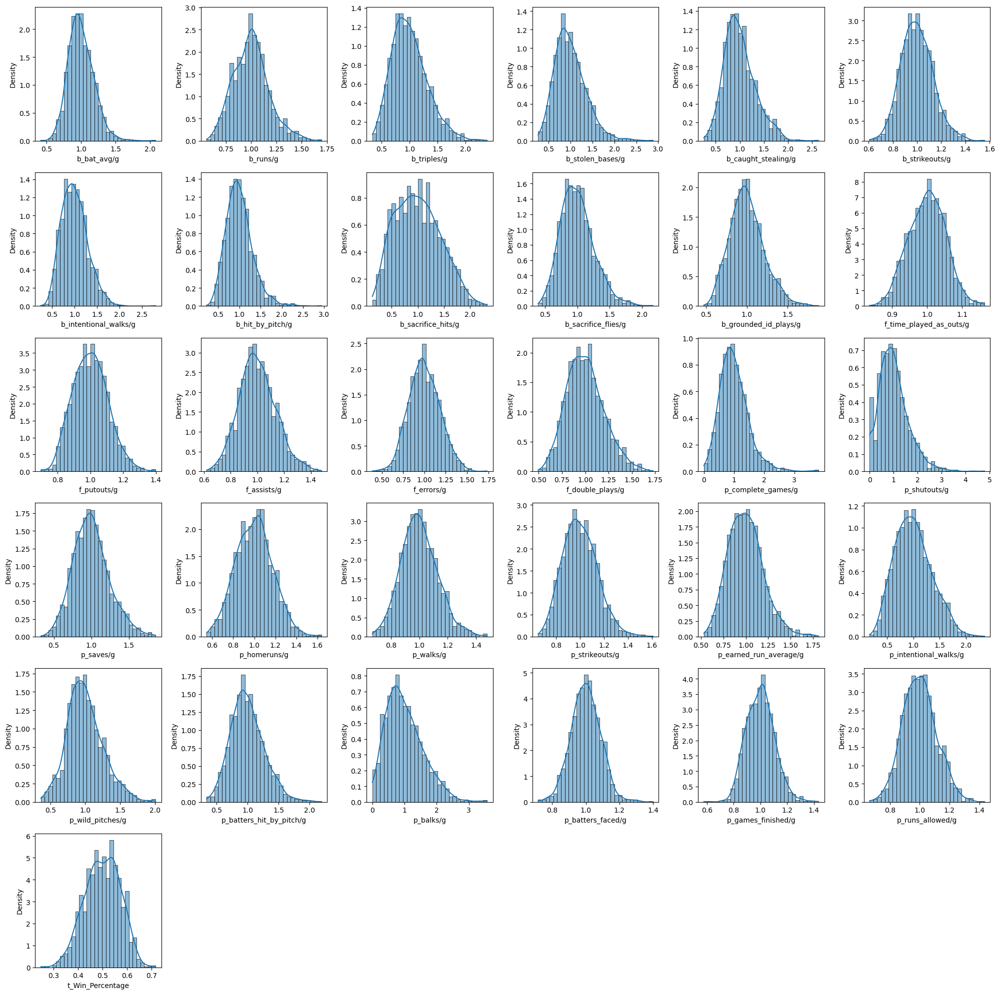

In [99]:
fig, ax = plt.subplots(6, 6, figsize=(20, 20))
ax = ax.flatten()

for i, col in enumerate(num_cols):
    sns.histplot(baseball_data[col],kde=True,stat='density',bins=30,ax=ax[i])

for i in range(len(num_cols),36):
    ax[i].axis('off')

plt.tight_layout()
plt.show()

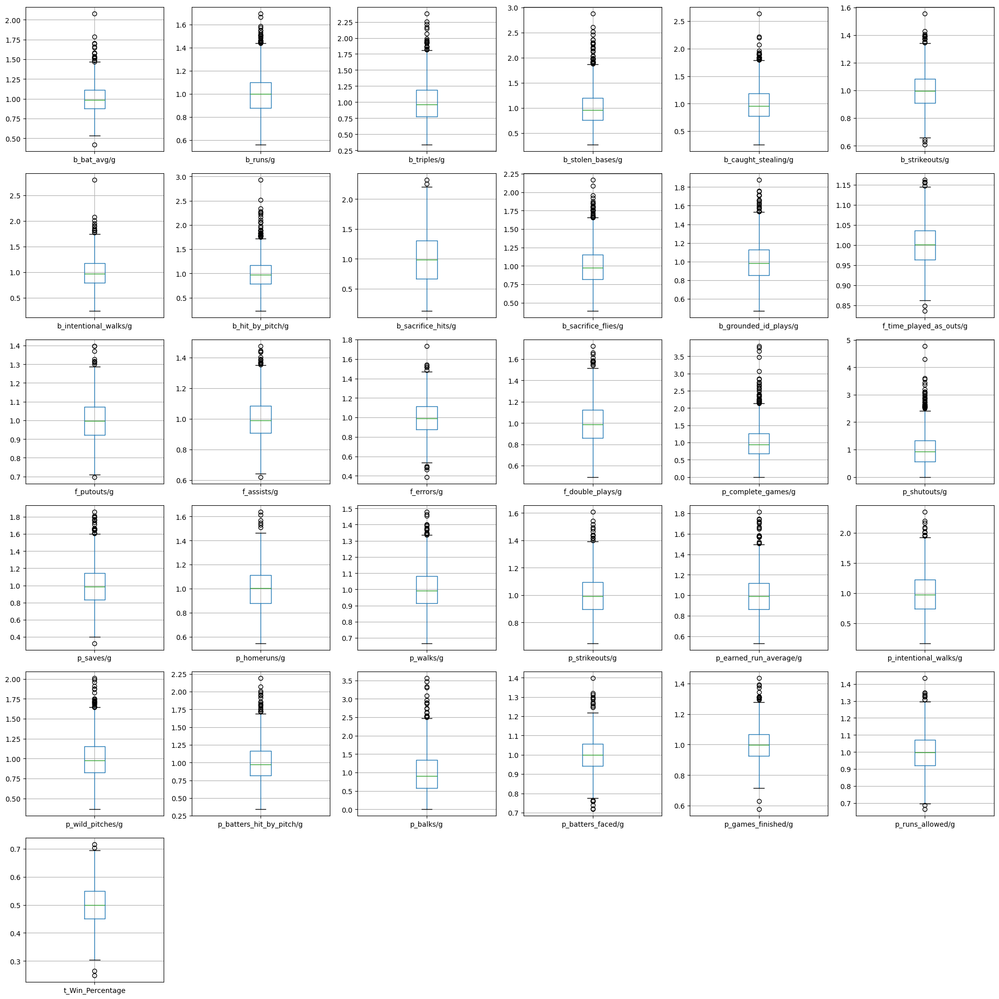

In [100]:
fig, ax = plt.subplots(6, 6, figsize=(20, 20))
ax = ax.flatten()

# plotting boxplot for every numerical column
for i, col in enumerate(num_cols):
    baseball_data.boxplot(col, ax=ax[i])

for i in range(len(num_cols),36):
    ax[i].axis('off')

plt.tight_layout()
plt.show()

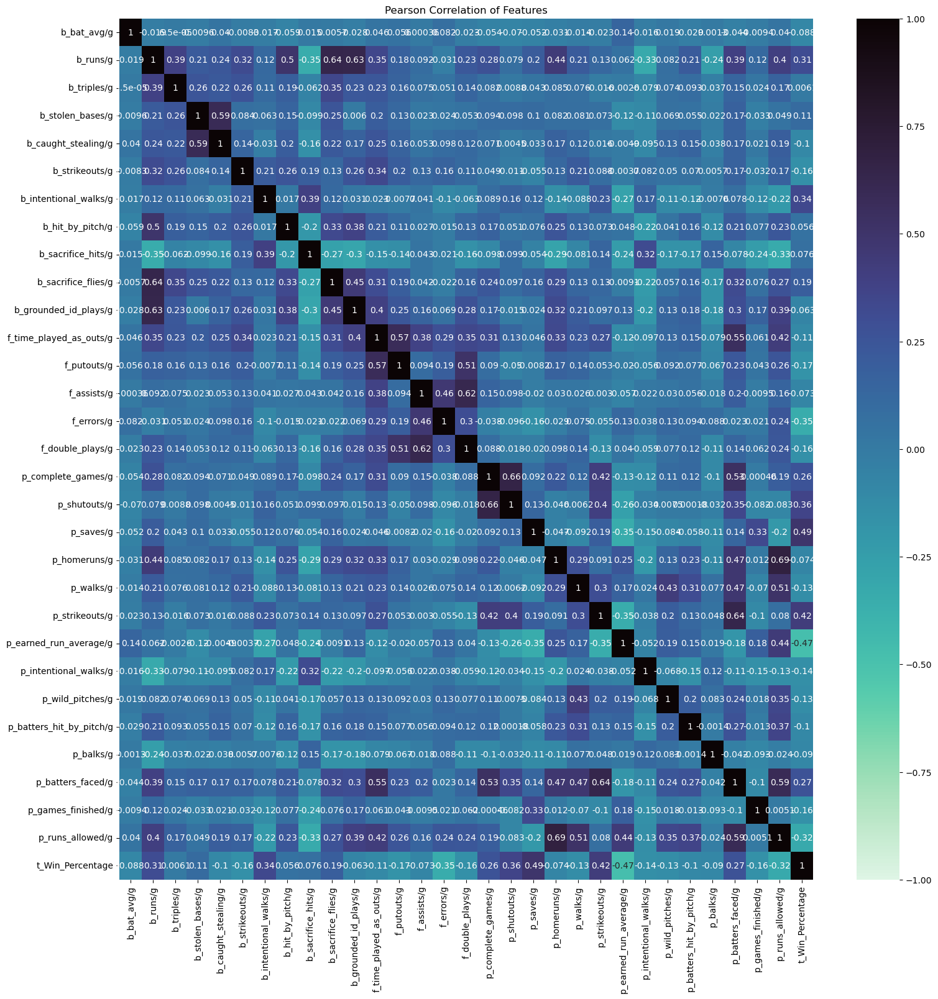

In [101]:
plt.figure(figsize=(18,18))
plt.title('Pearson Correlation of Features', size=12)
ax = sns.heatmap(baseball_data[num_cols].corr(), cmap='mako_r', annot=True, vmin=-1, vmax=1)
plt.show()

### 3.4 Numerical Data Transformation<a id="part3.4"></a>

In [102]:
# For easier understanding of train and test scores mean squared errors
baseball_data['t_Win_Percentage(%)'] = baseball_data['t_Win_Percentage'] * 100
baseball_data = baseball_data.drop(columns=['t_Win_Percentage'])

In [103]:
# For testing for the classficiation models at the bottom part 4.4 instead of linear regression?
#baseball_data['t_Win_Percentage(%)'] = pd.cut(baseball_data['t_Win_Percentage(%)'], 
#                                                bins=3, 
#                                                labels=[0, 1, 2])

In [104]:
num_cols = [n for n in baseball_data.columns if baseball_data[n].dtypes != 'O']
baseball_data[num_cols].skew()

b_bat_avg/g                 0.595929
b_runs/g                    0.428979
b_triples/g                 0.680824
b_stolen_bases/g            0.876905
b_caught_stealing/g         0.667547
b_strikeouts/g              0.306843
b_intentional_walks/g       0.605303
b_hit_by_pitch/g            0.909971
b_sacrifice_hits/g          0.307468
b_sacrifice_flies/g         0.643656
b_grounded_id_plays/g       0.529833
f_time_played_as_outs/g     0.002729
f_putouts/g                 0.265864
f_assists/g                 0.288328
f_errors/g                  0.160293
f_double_plays/g            0.428036
p_complete_games/g          1.107708
p_shutouts/g                0.983892
p_saves/g                   0.434162
p_homeruns/g                0.150777
p_walks/g                   0.346167
p_strikeouts/g              0.420257
p_earned_run_average/g      0.530747
p_intentional_walks/g       0.421520
p_wild_pitches/g            0.515664
p_batters_hit_by_pitch/g    0.543315
p_balks/g                   0.760129
p

In [105]:
def diagnostic_plots(df, variable):
    
    plt.figure(figsize=(18,6))
    plt.subplot(1, 3, 1)
    df[variable].hist(bins=30)

    plt.subplot(1, 3, 2)
    stats.probplot(df[variable], dist="norm", plot=plt)

    plt.subplot(1, 3, 3) 
    sns.boxplot(y=df[variable]) 


    plt.show()

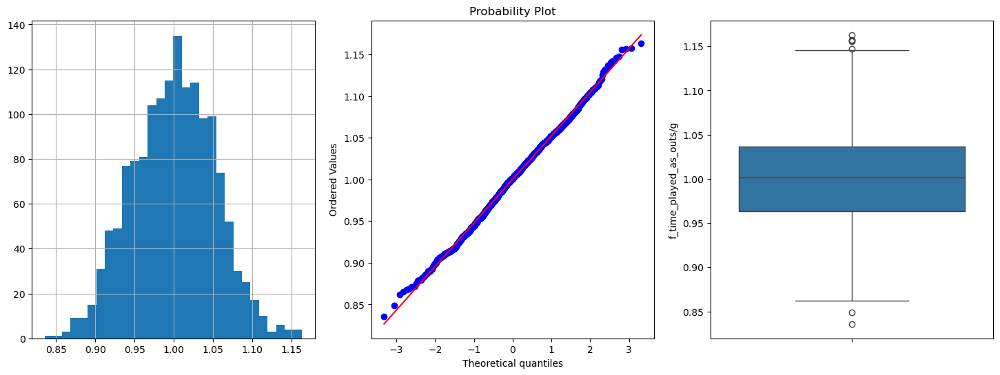

In [106]:
diagnostic_plots(baseball_data,'f_time_played_as_outs/g')

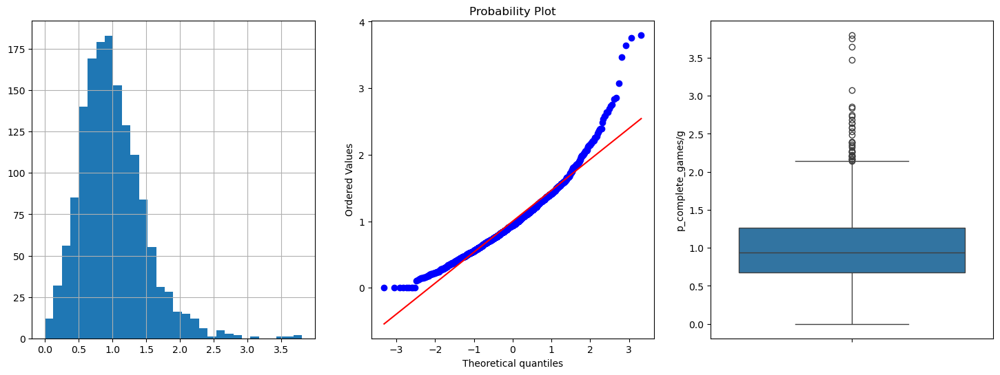

In [107]:
diagnostic_plots(baseball_data,'p_complete_games/g')

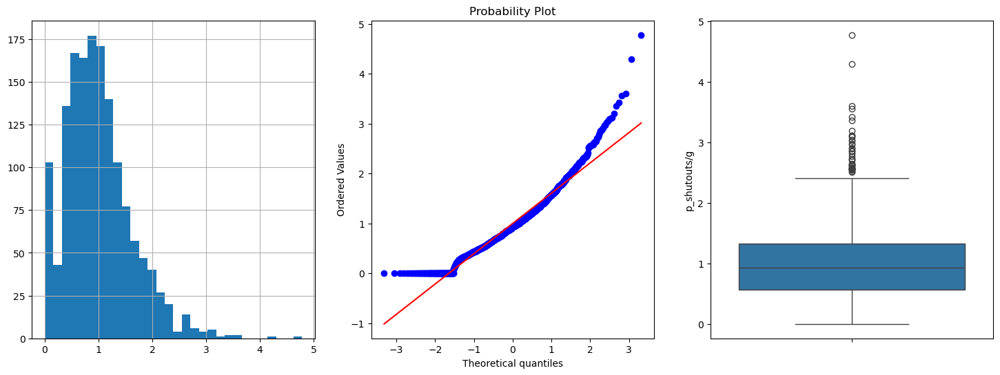

In [108]:
diagnostic_plots(baseball_data,'p_shutouts/g')

In [109]:
baseball_data[['f_time_played_as_outs/g']] = np.log(baseball_data[['f_time_played_as_outs/g']])
baseball_data[['p_complete_games/g','p_shutouts/g']] = np.log(baseball_data[['p_complete_games/g','p_shutouts/g']] + 1e-6)

In [110]:
# Old Code did not improve model/not better than the method chosen 

#baseball_data[['b_hit_by_pitch/g','p_earned_run_average/g']] = np.log(baseball_data[['b_hit_by_pitch/g','p_earned_run_average/g']])  
#baseball_data['b_sacrifice_flies/g'] = np.cbrt(baseball_data['b_sacrifice_flies/g'])
#baseball_data['b_sacrifice_flies/g'] = np.sqrt(baseball_data['b_sacrifice_flies/g'])
#baseball_data['b_sacrifice_flies/g'] = np.log(baseball_data['b_sacrifice_flies/g'])
#baseball_data['f_time_played_as_outs/g'] = np.sqrt(baseball_data['f_time_played_as_outs/g'])
#baseball_data['f_time_played_as_outs/g'] = np.cbrt(baseball_data['f_time_played_as_outs/g'])
#baseball_data['p_opp_battingavg/g'] = np.sqrt(baseball_data['p_opp_battingavg/g'])
#baseball_data['p_opp_battingavg/g'] = np.cbrt(baseball_data['p_opp_battingavg/g'])
#baseball_data['p_earned_run_average/g'] = np.cbrt(baseball_data['p_earned_run_average/g'])
#baseball_data['p_earned_run_average/g'] = np.sqrt(baseball_data['p_earned_run_average/g'])
#baseball_data['p_balks/g'] = np.cbrt(baseball_data['p_balks/g'])
#baseball_data['p_balks/g'] = np.sqrt(baseball_data['p_balks/g'])
#baseball_data['p_balks/g'] = np.log(baseball_data['p_balks/g']+ 1e-6)
#baseball_data['p_balks/g'] = 1/(baseball_data['p_balks/g']+ 1)
#baseball_data['b_triples/g'] = 1/(baseball_data['b_triples/g'])
#baseball_data['b_triples/g'] = np.cbrt(baseball_data['b_triples/g'])
#baseball_data['b_triples/g'] = np.sqrt(baseball_data['b_triples/g'])
#baseball_data['b_triples/g'] = np.log(baseball_data['b_triples/g']+ 1e-6)
#baseball_data['p_shutouts/g'] = 1/(baseball_data['p_shutouts/g']+1)
#baseball_data['p_shutouts/g'] = np.cbrt(baseball_data['p_shutouts/g'])
#baseball_data['p_shutouts/g'] = np.sqrt(baseball_data['p_shutouts/g'])

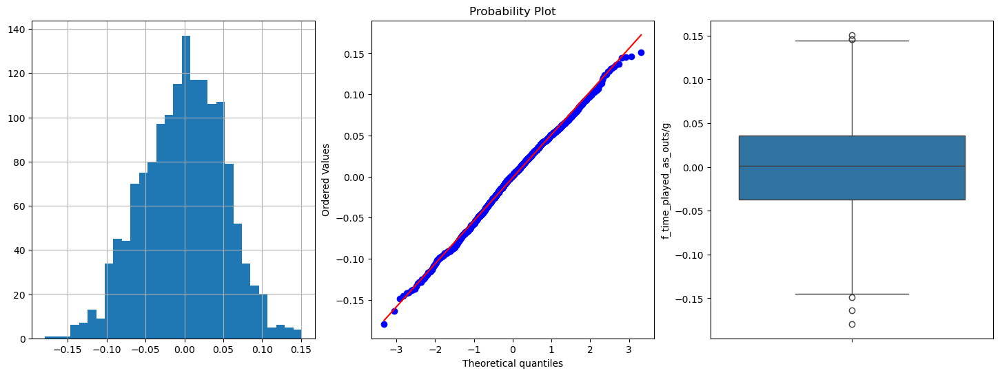

In [111]:
diagnostic_plots(baseball_data,'f_time_played_as_outs/g')

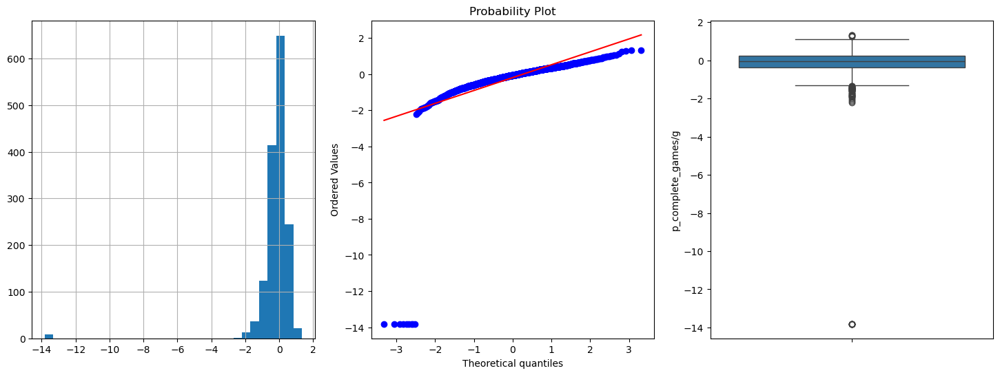

In [112]:
diagnostic_plots(baseball_data,'p_complete_games/g')

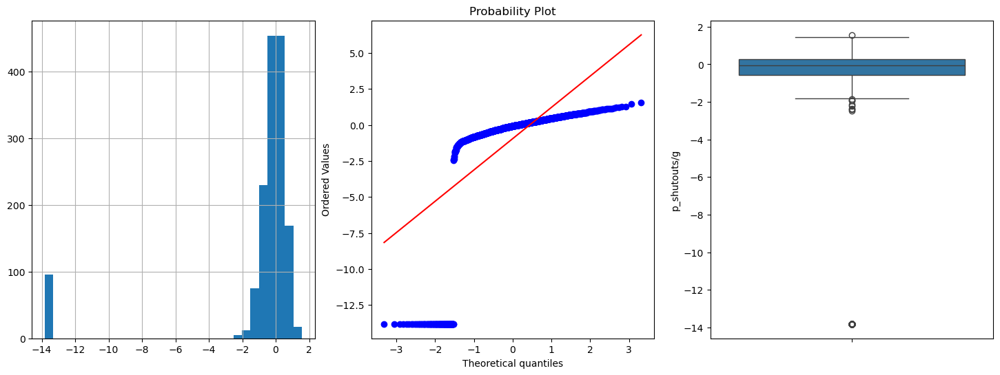

In [113]:
diagnostic_plots(baseball_data,'p_shutouts/g')

### 3.5 Outlier Capping<a id="part3.5"></a>

In [114]:
def find_skewed_boundaries(df, variable, distance):

    IQR = df[variable].quantile(0.75) - df[variable].quantile(0.25)

    lower_boundary = df[variable].quantile(0.25) - (IQR * distance)
    upper_boundary = df[variable].quantile(0.75) + (IQR * distance)

    return upper_boundary, lower_boundary

def find_normal_boundaries(df, variable, distance):

    upper_boundary = df[variable].mean() + df[variable].std() * distance
    lower_boundary = df[variable].mean() - df[variable].std() * distance

    return upper_boundary, lower_boundary

In [115]:
bcs_upper_limit, bcs_lower_limit = find_normal_boundaries(baseball_data, 'b_caught_stealing/g', 1.5)
bso_upper_limit, bso_lower_limit = find_normal_boundaries(baseball_data, 'b_strikeouts/g', 3)
biw_upper_limit, biw_lower_limit = find_normal_boundaries(baseball_data, 'b_intentional_walks/g', 1.5)
fa_upper_limit, fa_lower_limit = find_skewed_boundaries(baseball_data, 'f_assists/g', 1.5)
fe_upper_limit, fe_lower_limit = find_normal_boundaries(baseball_data, 'f_errors/g', 1.5)
fdp_upper_limit, fdp_lower_limit = find_normal_boundaries(baseball_data, 'f_double_plays/g', 3)
pera_upper_limit, pera_lower_limit = find_normal_boundaries(baseball_data, 'p_earned_run_average/g', 1.5)
piw_upper_limit, piw_lower_limit = find_skewed_boundaries(baseball_data, 'p_intentional_walks/g', 1.5)
pcg_upper_limit, pcg_lower_limit = find_normal_boundaries(baseball_data, 'p_complete_games/g', 1.5)
pw_upper_limit, pw_lower_limit = find_normal_boundaries(baseball_data, 'p_walks/g', 3)
pwp_upper_limit, pwp_lower_limit = find_normal_boundaries(baseball_data, 'p_wild_pitches/g', 3)

In [116]:
baseball_data['b_caught_stealing/g']= np.where(baseball_data['b_caught_stealing/g'] > bcs_upper_limit, bcs_upper_limit,
                      np.where(baseball_data['b_caught_stealing/g'] < bcs_lower_limit, bcs_lower_limit, baseball_data['b_caught_stealing/g']))

baseball_data['b_strikeouts/g']= np.where(baseball_data['b_strikeouts/g'] > bso_upper_limit, bso_upper_limit,
                      np.where(baseball_data['b_strikeouts/g'] < bso_lower_limit, bso_lower_limit, baseball_data['b_strikeouts/g']))

baseball_data['b_intentional_walks/g']= np.where(baseball_data['b_intentional_walks/g'] > biw_upper_limit, biw_upper_limit,
                      np.where(baseball_data['b_intentional_walks/g'] < biw_lower_limit, biw_lower_limit, baseball_data['b_intentional_walks/g']))

baseball_data['f_assists/g']= np.where(baseball_data['f_assists/g'] > fa_upper_limit, fa_upper_limit,
                      np.where(baseball_data['f_assists/g'] < fa_lower_limit, fa_lower_limit, baseball_data['f_assists/g']))

baseball_data['f_errors/g']= np.where(baseball_data['f_errors/g'] > fe_upper_limit, fe_upper_limit,
                      np.where(baseball_data['f_errors/g'] < fe_lower_limit, fe_lower_limit, baseball_data['f_errors/g']))

baseball_data['f_double_plays/g']= np.where(baseball_data['f_double_plays/g'] > fdp_upper_limit, fdp_upper_limit,
                      np.where(baseball_data['f_double_plays/g'] < fdp_lower_limit, fdp_lower_limit, baseball_data['f_double_plays/g']))

baseball_data['p_earned_run_average/g']= np.where(baseball_data['p_earned_run_average/g'] > pera_upper_limit, pera_upper_limit,
                      np.where(baseball_data['p_earned_run_average/g'] < pera_lower_limit, pera_lower_limit, baseball_data['p_earned_run_average/g']))

baseball_data['p_intentional_walks/g']= np.where(baseball_data['p_intentional_walks/g'] > piw_upper_limit, piw_upper_limit,
                      np.where(baseball_data['p_intentional_walks/g'] < piw_lower_limit, piw_lower_limit, baseball_data['p_intentional_walks/g']))

baseball_data['p_complete_games/g']= np.where(baseball_data['p_complete_games/g'] > pcg_upper_limit, pcg_upper_limit,
                      np.where(baseball_data['p_complete_games/g'] < pcg_lower_limit, pcg_lower_limit, baseball_data['p_complete_games/g']))

baseball_data['p_walks/g']= np.where(baseball_data['p_walks/g'] > pw_upper_limit, pw_upper_limit,
                      np.where(baseball_data['p_walks/g'] < pw_lower_limit, pw_lower_limit, baseball_data['p_walks/g']))

baseball_data['p_wild_pitches/g']= np.where(baseball_data['p_wild_pitches/g'] > pwp_upper_limit, pwp_upper_limit,
                      np.where(baseball_data['p_wild_pitches/g'] < pwp_lower_limit, pwp_lower_limit, baseball_data['p_wild_pitches/g']))

In [117]:
# Old Code, tried every many distances for the last parameter, even for the ones above that were included in the above code
#br_upper_limit, br_lower_limit = find_skewed_boundaries(baseball_data, 'b_runs/g', 1.5)
#bsb_upper_limit, bsb_lower_limit = find_normal_boundaries(baseball_data, 'b_stolen_bases/g', 1.5)
#hbp_upper_limit, hbp_lower_limit = find_normal_boundaries(baseball_data, 'b_hit_by_pitch/g', 1.5)
#bsh_upper_limit, bsh_lower_limit = find_normal_boundaries(baseball_data, 'b_sacrifice_hits/g', 3)
#bsf_upper_limit, bsf_lower_limit = find_normal_boundaries(baseball_data, 'b_sacrifice_flies/g', 1.5)
#bgdip_upper_limit, bgdip_lower_limit = find_normal_boundaries(baseball_data, 'b_grounded_id_plays/g', 1.5)
#ftp_upper_limit, ftp_lower_limit = find_normal_boundaries(baseball_data, 'f_time_played_as_outs/g', 1.5)
#pso_upper_limit, pso_lower_limit = find_normal_boundaries(baseball_data, 'p_shutouts/g', 1.5)
#ps_upper_limit, ps_lower_limit = find_skewed_boundaries(baseball_data, 'p_saves/g', 1.5)
#phr_upper_limit, phr_lower_limit = find_normal_boundaries(baseball_data, 'p_homeruns/g', 1.5)
#psko_upper_limit, psko_lower_limit = find_normal_boundaries(baseball_data, 'p_strikeouts/g', 1.5)
#pb_upper_limit, pb_lower_limit = find_normal_boundaries(baseball_data, 'p_balks/g', 3)
#pbf_upper_limit, pbf_lower_limit = find_skewed_boundaries(baseball_data, 'p_batters_faced/g', 1.5)
#pgf_upper_limit, pgf_lower_limit = find_skewed_boundaries(baseball_data, 'p_games_finished/g', 1.5)
#bt_upper_limit, bt_lower_limit = find_skewed_boundaries(baseball_data, 'b_triples/g', 3)
#fpo_upper_limit, fpo_lower_limit = find_skewed_boundaries(baseball_data, 'f_putouts/g', 1.5)
#pbhp_upper_limit, pbhp_lower_limit = find_skewed_boundaries(baseball_data, 'p_batters_hit_by_pitch/g', 3)
#pra_upper_limit, pra_lower_limit = find_normal_boundaries(baseball_data, 'p_runs_allowed/g', 1.5)

In [118]:
# Old Code
#baseball_data['b_hit_by_pitch/g']= np.where(baseball_data['b_hit_by_pitch/g'] > hbp_upper_limit, hbp_upper_limit,
#                      np.where(baseball_data['b_hit_by_pitch/g'] < hbp_lower_limit, hbp_lower_limit, baseball_data['b_hit_by_pitch/g']))
#baseball_data['b_sacrifice_hits/g']= np.where(baseball_data['b_sacrifice_hits/g'] > bsh_upper_limit, bsh_upper_limit,
#                      np.where(baseball_data['b_sacrifice_hits/g'] < bsh_lower_limit, bsh_lower_limit, baseball_data['b_sacrifice_hits/g']))
#baseball_data['b_sacrifice_flies/g']= np.where(baseball_data['b_sacrifice_flies/g'] > bsf_upper_limit, bsf_upper_limit,
#                      np.where(baseball_data['b_sacrifice_flies/g'] < bsf_lower_limit, bsf_lower_limit, baseball_data['b_sacrifice_flies/g']))
#baseball_data['b_grounded_id_plays/g']= np.where(baseball_data['b_grounded_id_plays/g'] > bgdip_upper_limit, bgdip_upper_limit,
#                      np.where(baseball_data['b_grounded_id_plays/g'] < bgdip_lower_limit, bgdip_lower_limit, baseball_data['b_grounded_id_plays/g']))
#baseball_data['f_time_played_as_outs/g']= np.where(baseball_data['f_time_played_as_outs/g'] > ftp_upper_limit, ftp_upper_limit,
#                      np.where(baseball_data['f_time_played_as_outs/g'] < ftp_lower_limit, ftp_lower_limit, baseball_data['f_time_played_as_outs/g']))
#baseball_data['b_triples/g']= np.where(baseball_data['b_triples/g'] > bt_upper_limit, bt_upper_limit,
#                      np.where(baseball_data['b_triples/g'] < bt_lower_limit, bt_lower_limit, baseball_data['b_triples/g']))
#baseball_data['b_runs/g']= np.where(baseball_data['b_runs/g'] > br_upper_limit, br_upper_limit,
#                      np.where(baseball_data['b_runs/g'] < br_lower_limit, br_lower_limit, baseball_data['b_runs/g']))
#baseball_data['b_stolen_bases/g']= np.where(baseball_data['b_stolen_bases/g'] > bsb_upper_limit, bsb_upper_limit,
#                      np.where(baseball_data['b_stolen_bases/g'] < bsb_lower_limit, bsb_lower_limit, baseball_data['b_stolen_bases/g']))
#baseball_data['f_putouts/g']= np.where(baseball_data['f_putouts/g'] > fpo_upper_limit, fpo_upper_limit,
#                      np.where(baseball_data['f_putouts/g'] < fpo_lower_limit, fpo_lower_limit, baseball_data['f_putouts/g']))
#baseball_data['p_batters_hit_by_pitch/g']= np.where(baseball_data['p_batters_hit_by_pitch/g'] > pbhp_upper_limit, pbhp_upper_limit,
#                  np.where(baseball_data['p_batters_hit_by_pitch/g'] < pbhp_lower_limit, pbhp_lower_limit, baseball_data['p_batters_hit_by_pitch/g']))
#baseball_data['p_runs_allowed/g']= np.where(baseball_data['p_runs_allowed/g'] > pra_upper_limit, pra_upper_limit,
#                      np.where(baseball_data['p_runs_allowed/g'] < pra_lower_limit, pra_lower_limit, baseball_data['p_runs_allowed/g']))
#baseball_data['p_shutouts/g']= np.where(baseball_data['p_shutouts/g'] > pso_upper_limit, pso_upper_limit,
#                      np.where(baseball_data['p_shutouts/g'] < pso_lower_limit, pso_lower_limit, baseball_data['p_shutouts/g']))
#baseball_data['p_saves/g']= np.where(baseball_data['p_saves/g'] > ps_upper_limit, ps_upper_limit,
#                      np.where(baseball_data['p_saves/g'] < ps_lower_limit, ps_lower_limit, baseball_data['p_saves/g']))
#baseball_data['p_homeruns/g']= np.where(baseball_data['p_homeruns/g'] > phr_upper_limit, phr_upper_limit,
#                      np.where(baseball_data['p_homeruns/g'] < phr_lower_limit, phr_lower_limit, baseball_data['p_homeruns/g']))
#baseball_data['p_strikeouts/g']= np.where(baseball_data['p_strikeouts/g'] > psko_upper_limit, psko_upper_limit,
#                      np.where(baseball_data['p_strikeouts/g'] < psko_lower_limit, psko_lower_limit, baseball_data['p_strikeouts/g']))
#baseball_data['p_balks/g']= np.where(baseball_data['p_balks/g'] > pb_upper_limit, pb_upper_limit,
#                      np.where(baseball_data['p_balks/g'] < pb_lower_limit, pb_lower_limit, baseball_data['p_balks/g']))
#baseball_data['p_batters_faced/g']= np.where(baseball_data['p_batters_faced/g'] > pbf_upper_limit, pbf_upper_limit,
#                      np.where(baseball_data['p_batters_faced/g'] < pbf_lower_limit, pbf_lower_limit, baseball_data['p_batters_faced/g']))
#baseball_data['p_games_finished/g']= np.where(baseball_data['p_games_finished/g'] > pgf_upper_limit, pgf_upper_limit,
#                      np.where(baseball_data['p_games_finished/g'] < pgf_lower_limit, pgf_lower_limit, baseball_data['p_games_finished/g']))

In [119]:
# Old Code, also tried winsorization

#from feature_engine.outliers import Winsorizer
#winsorizer = Winsorizer(capping_method ='quantiles', 
#                        tail='both', # cap left, right or both tails
#                        fold =0.05,
#                        variables=['b_runs/g', 'b_stolen_bases/g', 'p_games_finished/g'])

#winsorizer.fit(baseball_data)

#baseball_data = winsorizer.transform(baseball_data)

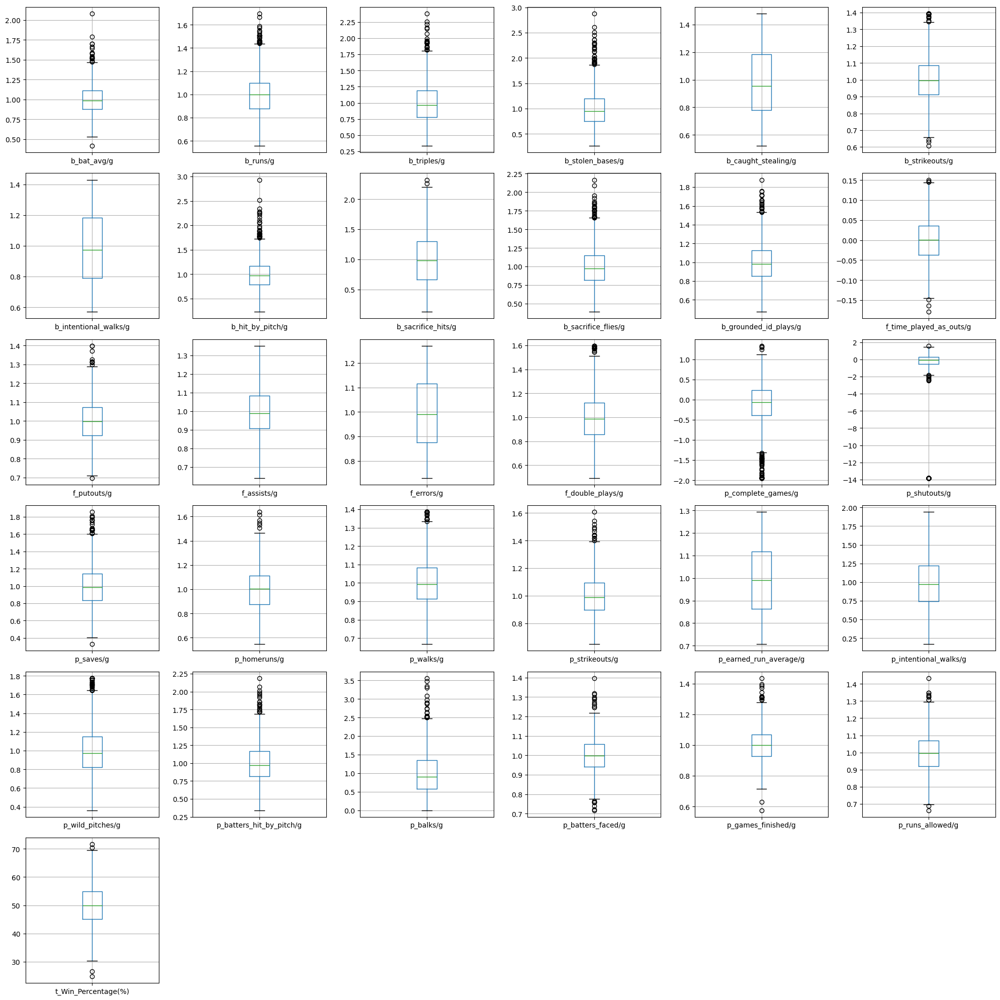

In [120]:
fig, ax = plt.subplots(6, 6, figsize=(20, 20))
ax = ax.flatten()

# plotting boxplot for every numerical column
for i, col in enumerate(num_cols):
    baseball_data.boxplot(col, ax=ax[i])

for i in range(len(num_cols),36):
    ax[i].axis('off')

plt.tight_layout()
plt.show()

### 3.6 Train and Test Split<a id="part3.6"></a>

In [121]:
X_train, X_test, y_train, y_test = train_test_split(
    baseball_data.drop('t_Win_Percentage(%)', axis=1), baseball_data['t_Win_Percentage(%)'], test_size=0.3, random_state=69)

X_train.shape, X_test.shape

((1058, 30), (454, 30))

In [122]:
y_train.shape, y_test.shape

((1058,), (454,))

In [123]:
def highlight_col(x, mask_train_idx=X_train.index, mask_test_idx=X_test.index):
    # Initialising DataFrame with the same shape as x with empty strings
    df = pd.DataFrame('', index=x.index, columns=x.columns)
    
    df.iloc[mask_train_idx, :-1] = 'background-color: #EB6E1F'  # X_train
    df.iloc[mask_test_idx, :-1] = 'background-color: #002D62'   # X_test
    df.iloc[mask_train_idx, -1] = 'background-color: #E0A077'   # y_train
    df.iloc[mask_test_idx, -1] = 'background-color: #4779B3'    # y_test
    
    return df

baseball_data.style.apply(highlight_col, axis=None)

### 3.7 Variable Discretization<a id="part3.7"></a>

In [124]:
ewd_ps_disc = EqualWidthDiscretiser(bins=5, variables = ['p_strikeouts/g'])
ewd_ps_disc.fit(X_train)

EqualWidthDiscretiser(bins=5, variables=['p_strikeouts/g'])

In [125]:
ewd_fp_disc = EqualWidthDiscretiser(bins=7, variables=['f_putouts/g'])
ewd_fp_disc.fit(X_train)

EqualWidthDiscretiser(bins=7, variables=['f_putouts/g'])

In [126]:
X_train = ewd_ps_disc.transform(X_train)
X_test = ewd_ps_disc.transform(X_test)

X_train = ewd_fp_disc.transform(X_train)
X_test = ewd_fp_disc.transform(X_test)

In [127]:
# Old Code
#ewd_disc = EqualWidthDiscretiser(bins=5, variables = ['p_earned_run_average/g','b_runs/g','f_errors/g','f_time_played_as_outs/g'
#                                                      ,'b_caught_stealing/g'])
#ewd_pw_disc = EqualWidthDiscretiser(bins=10, variables = ['p_walks/g'])
#ewd_cg_disc = EqualWidthDiscretiser(bins=3, variables = ['p_complete_games/g'])
#ewd_disc = EqualWidthDiscretiser(bins=7, variables = ['b_sacrifice_hits/g','b_strikeouts/g'])

Text(0, 0.5, 'Number of observations per bin')

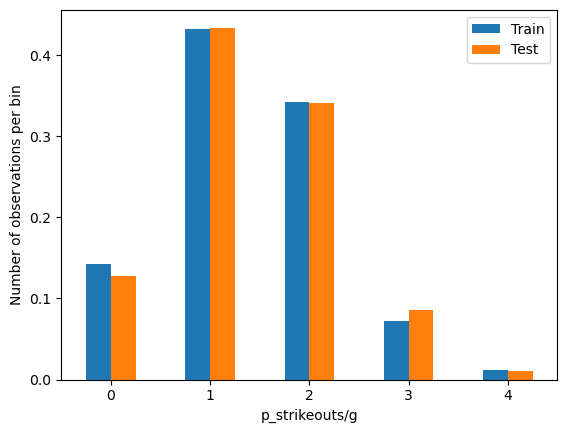

In [128]:
t1 = X_train.groupby(['p_strikeouts/g'])['p_strikeouts/g'].count() / len(X_train)
t2 = X_test.groupby(['p_strikeouts/g'])['p_strikeouts/g'].count() / len(X_test)

tmp = pd.concat([t1, t2], axis=1)
tmp.columns = ['Train', 'Test']
tmp.plot.bar()
plt.xticks(rotation=0)
plt.ylabel('Number of observations per bin')

Text(0, 0.5, 'Number of observations per bin')

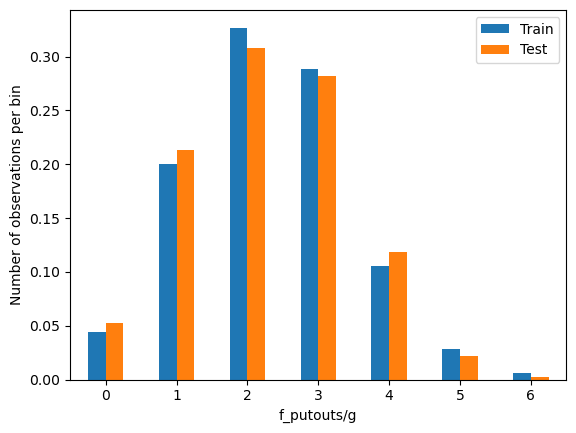

In [129]:
t1 = X_train.groupby(['f_putouts/g'])['f_putouts/g'].count() / len(X_train)
t2 = X_test.groupby(['f_putouts/g'])['f_putouts/g'].count() / len(X_test)

tmp = pd.concat([t1, t2], axis=1)
tmp.columns = ['Train', 'Test']
tmp.plot.bar()
plt.xticks(rotation=0)
plt.ylabel('Number of observations per bin')

In [130]:
efd_pw_disc = EqualFrequencyDiscretiser(q=4, variables = ['p_walks/g']) 
efd_pw_disc.fit(X_train)

EqualFrequencyDiscretiser(q=4, variables=['p_walks/g'])

In [131]:
X_train = efd_pw_disc.transform(X_train)
X_test = efd_pw_disc.transform(X_test)

In [132]:
# Old Code 
#efd_disc = EqualFrequencyDiscretiser(q=4, variables = ['p_complete_games/g','f_double_plays/g',
#                                    'p_balks/g','p_batters_hit_by_pitch/g']) 
#efd_disc.fit(X_train)

Text(0, 0.5, 'Number of observations per bin')

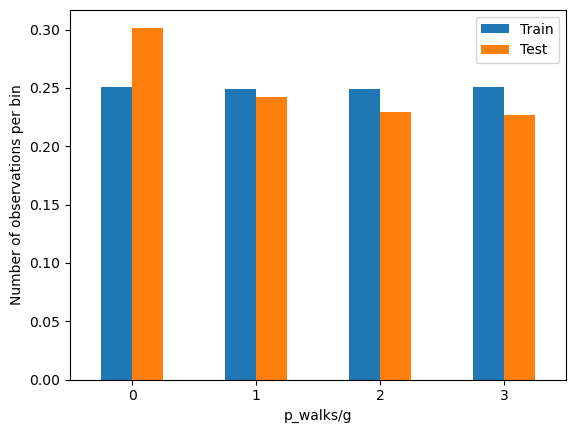

In [133]:
t1 = X_train.groupby(['p_walks/g'])['p_walks/g'].count() / len(X_train)
t2 = X_test.groupby(['p_walks/g'])['p_walks/g'].count() / len(X_test)

tmp = pd.concat([t1, t2], axis=1)
tmp.columns = ['Train', 'Test']
tmp.plot.bar()
plt.xticks(rotation=0)
plt.ylabel('Number of observations per bin')

### 3.8 Feature Scaling<a id="part3.8"></a>

In [134]:
# Old Code (Tried Polynomial Expansion but led to overfitting of model)

#from sklearn.preprocessing import PolynomialFeatures
#poly = PolynomialFeatures(degree=2, interaction_only=False, include_bias=False)
#poly.fit(X_train)
#train_t = poly.transform(X_train)
#test_t = poly.transform(X_test)
#test_t = pd.DataFrame(test_t)
#train_t = pd.DataFrame(train_t)

In [135]:
scaler = StandardScaler()

scaler.fit(X_train)

X_train_scaled = scaler.transform(X_train)
X_test_scaled = scaler.transform(X_test)

X_train_scaled = pd.DataFrame(X_train_scaled, columns=X_train.columns)
X_test_scaled = pd.DataFrame(X_test_scaled, columns=X_test.columns)

In [136]:
# Old Code (also tried Min Max Scaling)
#from sklearn.preprocessing import MinMaxScaler
#scaler = MinMaxScaler()

#scaler.fit(X_train)

#X_train_scaled = scaler.transform(X_train)
#X_test_scaled = scaler.transform(X_test)

#X_train_scaled = pd.DataFrame(X_train_scaled, columns=X_train.columns)
#X_test_scaled = pd.DataFrame(X_test_scaled, columns=X_test.columns)

In [137]:
# Old Code (also explored Mean Normalisation)
#means = X_train.mean(axis=0)
#ranges = X_train.max(axis=0)-X_train.min(axis=0)
#X_train_scaled = (X_train - means) / ranges
#X_test_scaled = (X_test - means) / ranges

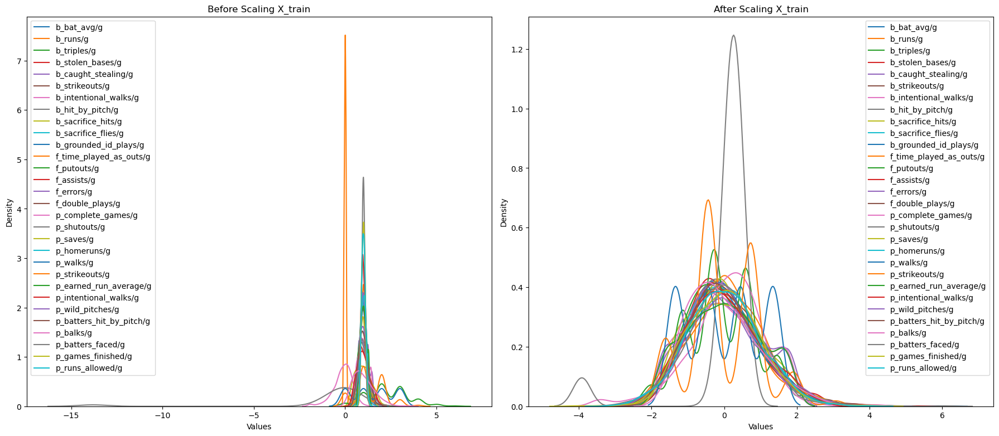

In [138]:
fig, (ax1, ax2) = plt.subplots(ncols=2, figsize=(18, 8))

ax1.set_title('Before Scaling X_train')
for col in X_train.columns:
    sns.kdeplot(X_train[col], ax=ax1, label=col)
ax1.legend()
ax1.set_xlabel('Values')

ax2.set_title('After Scaling X_train')
for col in X_train_scaled.columns:
    sns.kdeplot(X_train_scaled[col], ax=ax2, label=col)
ax2.legend()
ax2.set_xlabel('Values')

plt.tight_layout()
plt.show()

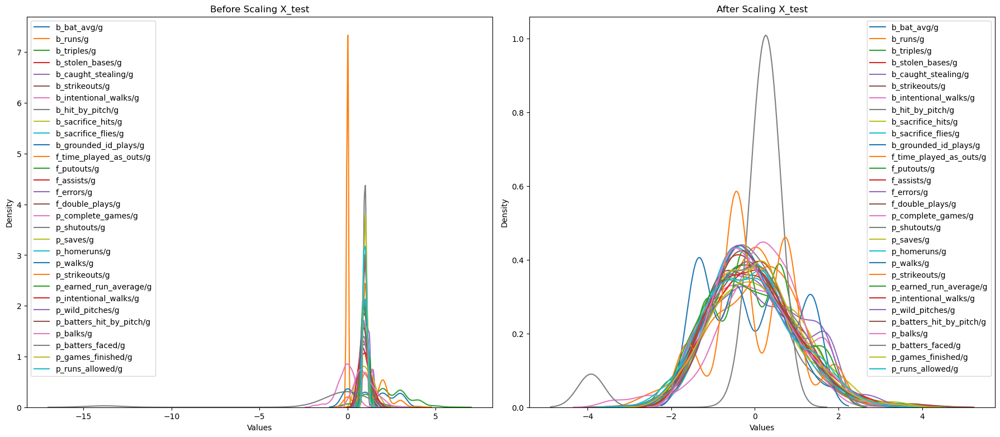

In [139]:
fig, (ax1, ax2) = plt.subplots(ncols=2, figsize=(18, 8))

ax1.set_title('Before Scaling X_test')
for col in X_test.columns:
    sns.kdeplot(X_test[col], ax=ax1, label=col)
ax1.legend()
ax1.set_xlabel('Values')

ax2.set_title('After Scaling X_test')
for col in X_test_scaled.columns:
    sns.kdeplot(X_test_scaled[col], ax=ax2, label=col)
ax2.legend()
ax2.set_xlabel('Values')

plt.tight_layout()
plt.show()

In [140]:
X_train_scaled.head()

,b_bat_avg/g,b_runs/g,b_triples/g,b_stolen_bases/g,b_caught_stealing/g,b_strikeouts/g,b_intentional_walks/g,b_hit_by_pitch/g,b_sacrifice_hits/g,b_sacrifice_flies/g,...,p_walks/g,p_strikeouts/g,p_earned_run_average/g,p_intentional_walks/g,p_wild_pitches/g,p_batters_hit_by_pitch/g,p_balks/g,p_batters_faced/g,p_games_finished/g,p_runs_allowed/g
0,0.672239,0.964460,-0.836713,0.305337,0.709019,-1.361076,0.102718,-0.279420,-0.280238,0.413567,...,-0.446876,-0.440770,-0.343787,0.128382,1.976067,-1.381436,-1.190402,-0.732112,0.799512,0.668868
1,-0.501068,-0.391723,0.402350,-1.324596,-1.185045,-0.692964,-0.160934,-0.764798,-1.262169,0.347883,...,1.340627,0.727988,0.073235,1.287072,1.380252,0.042614,-0.235714,0.545480,-0.501553,0.323392
2,-2.135800,-0.901320,-0.352883,-0.014085,-1.038749,-1.437503,-0.939976,0.900676,-1.448254,-1.123624,...,-1.340627,-0.440770,0.837077,-1.405787,-0.570798,1.027922,-1.088401,-0.294772,0.946648,0.387756
3,0.695488,-1.100718,-1.850782,-0.357023,0.510529,0.122969,0.237349,-1.109775,0.658173,-0.273512,...,-1.340627,-0.440770,-1.246545,0.402311,-0.605056,-0.404909,-0.523018,-0.748079,0.523761,-0.693979
4,-0.902136,-0.159366,1.171323,-1.032993,0.798332,0.343180,-0.606245,1.112266,-0.682189,-1.528915,...,0.446876,-1.609528,0.822220,-0.024740,-0.576132,-0.352683,-1.025269,-2.005266,0.884016,-1.031237


In [141]:
X_test_scaled.head()

,b_bat_avg/g,b_runs/g,b_triples/g,b_stolen_bases/g,b_caught_stealing/g,b_strikeouts/g,b_intentional_walks/g,b_hit_by_pitch/g,b_sacrifice_hits/g,b_sacrifice_flies/g,...,p_walks/g,p_strikeouts/g,p_earned_run_average/g,p_intentional_walks/g,p_wild_pitches/g,p_batters_hit_by_pitch/g,p_balks/g,p_batters_faced/g,p_games_finished/g,p_runs_allowed/g
0,-1.193497,-0.232564,-0.629066,0.641916,-0.548563,0.730206,-0.888049,-1.111992,-0.351199,0.242389,...,-1.340627,-0.440770,0.310209,0.347337,-0.471306,-0.670582,0.424650,-0.532861,0.708663,-0.206248
1,-0.883023,0.432783,1.087404,-0.358820,-0.602645,1.343528,-0.412930,0.233519,-1.034467,0.210985,...,0.446876,-1.609528,0.397429,2.717117,2.024253,0.025821,-0.198811,0.188909,0.812363,1.465228
2,-0.217262,-0.293265,0.333354,2.269445,1.459596,-0.626428,-1.390285,0.305444,-0.488079,-0.506563,...,-0.446876,-0.440770,1.739334,-1.135499,-0.030427,-1.223633,-0.678363,-0.732799,0.790592,-0.110938
3,-0.005854,0.064937,0.164741,-0.540452,0.484131,-1.154852,0.891042,-0.038262,-1.349502,-0.023671,...,-0.446876,-0.440770,0.843508,0.278876,1.119370,-0.170393,0.155693,-0.937716,0.022415,-1.012570
4,1.282148,0.612612,-0.680392,1.117286,1.225033,-0.916438,-0.136133,-0.262965,-1.108567,0.174419,...,-1.340627,0.727988,-1.714520,-1.242415,-0.279843,-0.449466,-1.287909,0.270285,-0.307752,-0.803662


In [142]:
# Old Code

#from sklearn.decomposition import PCA
#pca = PCA()
#pca.fit(X_train_scaled)
#X_train_scaled = pca.transform(X_train_scaled)
#X_test_scaled = pca.transform(X_test_scaled)

In [143]:
#plt.plot(pca.explained_variance_ratio_, linewidth=2)
#plt.title('Percentage of Variance Explained')
#plt.xlabel('Index Number of Components')
#plt.ylabel('Percentage of Variance Explained')

In [144]:
#print(len(pca.explained_variance_ratio_))
#print(pca.explained_variance_ratio_)

## 4. Machine Learning Modelling<a id="part4"></a>

### 4.1 Naïve Baseline Model<a id="part4.1"></a>

In [145]:
mean_target_value = y_train.mean()
print(f"The train mean target value is {mean_target_value:.2f}.")

The train mean target value is 49.82.


In [146]:
y_train_preds_naive = [round(mean_target_value,2) for row in X_train.iloc[:,0]]
y_train_preds_naive[0:5]

[49.82, 49.82, 49.82, 49.82, 49.82]

In [147]:
y_test_preds_naive = [round(mean_target_value,2) for row in X_test.iloc[:,0]]
y_test_preds_naive[0:5]

[49.82, 49.82, 49.82, 49.82, 49.82]

In [148]:
y_true = y_train
y_pred = y_train_preds_naive

train_mse_naive = mean_squared_error(y_true, y_pred)
print(f"The Naive Baseline Model's MSE on train data is {train_mse_naive:.3f}.")

# test MSE score
y_true = y_test
y_pred = y_test_preds_naive

test_mse_naive = mean_squared_error(y_true, y_pred)
print(f"The Naive Baseline Model's MSE on test data is {test_mse_naive:.3f}.")

print()

# train R2 score
y_true = y_train
y_pred = y_train_preds_naive

train_r2_naive = r2_score(y_true, y_pred)
print(f"The Naive Baseline Model's R2 on train data is {train_r2_naive:.3f}.")

# test R2 score
y_true = y_test
y_pred = y_test_preds_naive

test_r2_naive = r2_score(y_true, y_pred)
print(f"The Naive Baseline Model's R2 on test data is {test_r2_naive:.3f}.")


The Naive Baseline Model's MSE on train data is 49.414.
The Naive Baseline Model's MSE on test data is 53.473.

The Naive Baseline Model's R2 on train data is -0.000.
The Naive Baseline Model's R2 on test data is -0.004.


### 4.2 Linear Regression Model<a id="part4.2"></a>

In [149]:
model_linear_regression = LinearRegression()
model_linear_regression.fit(X_train_scaled, y_train)

train_mse_lr = mean_squared_error(y_train, model_linear_regression.predict(X_train_scaled))
test_mse_lr = mean_squared_error(y_test, model_linear_regression.predict(X_test_scaled))

train_r2_lr = r2_score(y_train, model_linear_regression.predict(X_train_scaled))
test_r2_lr = r2_score(y_test, model_linear_regression.predict(X_test_scaled))


print(f"The Linear Regression Model's MSE on train data is {train_mse_lr:.3f}.")
print(f"The Linear Regression Model's MSE on test data is {test_mse_lr:.3f}.")

print()

print(f"The Linear Regression Model's R2 on train data is {train_r2_lr:.3f}.")
print(f"The Linear Regression Model's R2 on test data is {test_r2_lr:.3f}.")

The Linear Regression Model's MSE on train data is 9.931.
The Linear Regression Model's MSE on test data is 10.159.

The Linear Regression Model's R2 on train data is 0.799.
The Linear Regression Model's R2 on test data is 0.809.


In [150]:
coefficients = pd.Series(model_linear_regression.coef_, index=X_train.columns)
coefficients.sort_values(ascending=False, inplace=True)
print(coefficients)

b_runs/g                    4.432434
p_batters_faced/g           3.445116
p_saves/g                   1.492420
b_intentional_walks/g       0.748517
p_strikeouts/g              0.684924
f_assists/g                 0.256017
b_stolen_bases/g            0.237693
p_homeruns/g                0.155137
p_balks/g                   0.110285
p_shutouts/g                0.102228
p_earned_run_average/g      0.099585
p_wild_pitches/g            0.046833
b_bat_avg/g                -0.095715
f_double_plays/g           -0.151015
p_complete_games/g         -0.186307
b_sacrifice_hits/g         -0.191927
f_putouts/g                -0.206276
p_intentional_walks/g      -0.222901
b_sacrifice_flies/g        -0.286067
p_batters_hit_by_pitch/g   -0.363297
b_hit_by_pitch/g           -0.373549
b_triples/g                -0.420821
f_errors/g                 -0.422135
p_walks/g                  -0.541773
b_caught_stealing/g        -0.679814
f_time_played_as_outs/g    -1.014770
b_grounded_id_plays/g      -1.202173
b

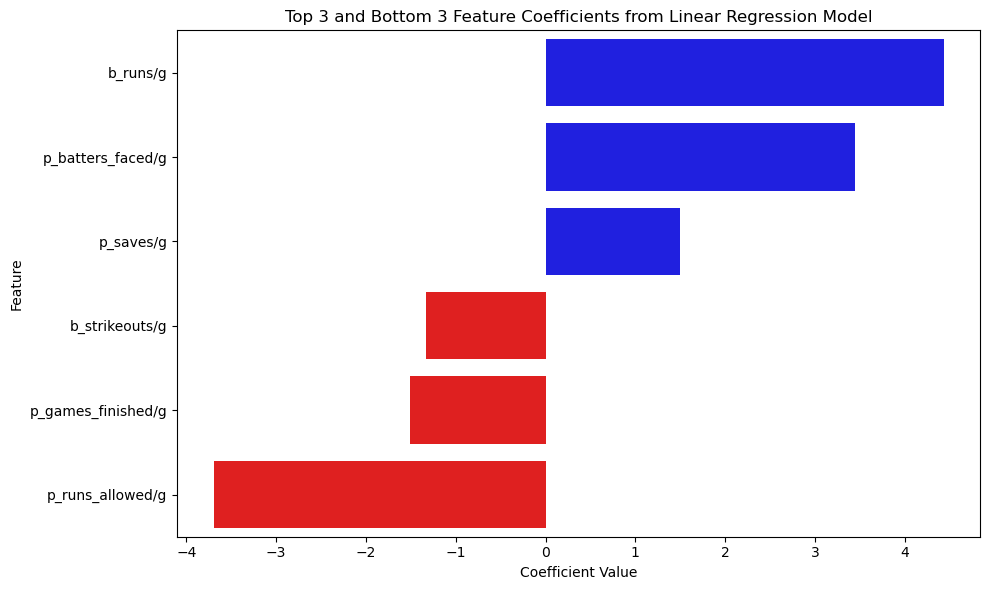

In [151]:
# plotting bar chart of feature coefficients
top_5 = coefficients.head(3)
bottom_5 = coefficients.tail(3)

top_bottom_coefficients = pd.concat([top_5, bottom_5])

colors = ['blue']*3 + ['red']*3

plt.figure(figsize=(10, 6))

sns.barplot(x=top_bottom_coefficients.values, y=top_bottom_coefficients.index, palette=colors,hue=top_bottom_coefficients.index,legend=False)

plt.title('Top 3 and Bottom 3 Feature Coefficients from Linear Regression Model')
plt.xlabel('Coefficient Value')
plt.ylabel('Feature')
plt.tight_layout()
plt.show()

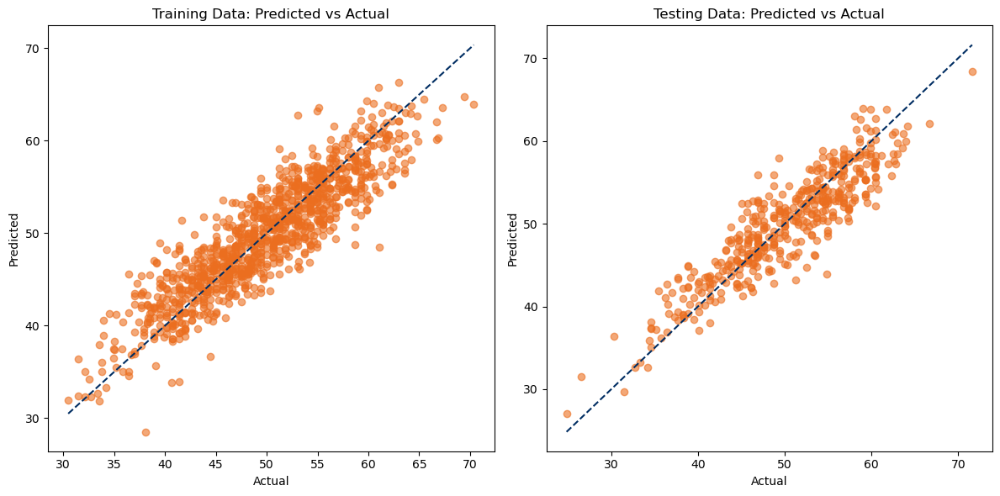

In [152]:
y_train_pred = model_linear_regression.predict(X_train_scaled)
y_test_pred = model_linear_regression.predict(X_test_scaled)

plt.figure(figsize=(12, 6))

plt.subplot(1, 2, 1)
plt.scatter(y_train, y_train_pred, alpha=0.6, color='#EB6E1F')
plt.plot([y_train.min(), y_train.max()], [y_train.min(), y_train.max()], color='#002D62', linestyle='--')
plt.xlabel('Actual')
plt.ylabel('Predicted')
plt.title('Training Data: Predicted vs Actual')

plt.subplot(1, 2, 2)
plt.scatter(y_test, y_test_pred, alpha=0.6, color='#EB6E1F')
plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], color='#002D62', linestyle='--')
plt.xlabel('Actual')
plt.ylabel('Predicted')
plt.title('Testing Data: Predicted vs Actual')

plt.tight_layout()
plt.show()

### 4.3 Rainforest Regressor Model<a id="part4.3"></a>

In [153]:
rfr = RandomForestRegressor(n_estimators=200,random_state=69, min_samples_split=2,min_samples_leaf=2)
rfr.fit(X_train, y_train)
print('train_mse:', mean_squared_error(y_train, rfr.predict(X_train)), 
      '\n test_mse:', mean_squared_error(y_test, rfr.predict(X_test)))
print('train_r-sq:', r2_score(y_train,rfr.predict(X_train)), 
      '\n test_r-sq:', r2_score(y_test, rfr.predict(X_test)))

train_mse: 3.4089645007897658 
 test_mse: 22.02107819445661
train_r-sq: 0.9310128329817244 
 test_r-sq: 0.5866227500991513


In [154]:
# Old Code tried using GridSearchCV for best params
#from sklearn.model_selection import GridSearchCV

#param_grid = {
#    'n_estimators': [100, 200, 300], 'min_samples_split': [2, 5, 10], 'min_samples_leaf': [1, 2, 4]
#}

#rfr = RandomForestRegressor(random_state=69)
#grid_search = GridSearchCV(estimator=rfr, param_grid=param_grid, cv=5, n_jobs=-1, verbose=2, scoring='neg_mean_squared_error')
#grid_search.fit(X_train, y_train)
#grid_search.best_estimator_

### 4.4 Classification Problem Tested With Logistic Regression and Decision Tree Classifier<a id="part4.4"></a>

In [155]:
#from sklearn.linear_model import LogisticRegression
#from sklearn.metrics import accuracy_score

#logreg = LogisticRegression(random_state=69, solver='liblinear')
#logreg.fit(X_train, y_train)
#y_train_preds_logreg = logreg.predict(X_train)
#y_test_preds_logreg = logreg.predict(X_test)

#y_true = y_train
#y_pred = y_train_preds_logreg

#train_accuracy_logreg = accuracy_score(y_true, y_pred) * 100
#print(f"The LogReg Model's accuracy on train data is {train_accuracy_logreg:.2f}%.")

#y_true = y_test
#y_pred = y_test_preds_logreg

#test_accuracy_logreg = accuracy_score(y_true, y_pred) * 100
#print(f"The LogReg Model's accuracy on test data is {test_accuracy_logreg:.2f}%.")

In [156]:
#from sklearn.tree import DecisionTreeClassifier

#dtree = DecisionTreeClassifier(random_state=69)
#dtree.fit(X_train, y_train)
#y_train_preds_dtree = dtree.predict(X_train)
#y_test_preds_dtree = dtree.predict(X_test)

#y_true = y_train
#y_pred = y_train_preds_dtree

#train_accuracy_dtree = accuracy_score(y_true, y_pred) * 100
#print(f"The DTree Model's accuracy on train data is {train_accuracy_dtree:.2f}%.")

#y_true = y_test
#y_pred = y_test_preds_dtree

#test_accuracy_dtree = accuracy_score(y_true, y_pred) * 100
#print(f"The DTRee Model's accuracy on test data is {test_accuracy_dtree:.2f}%.")

### 5. Additional (Finding Undervalued Players Who Contribute To Winning)<a id="part5"></a>

In [157]:
# This is just for the fielding category, it can be applied to pitching and batting

In [158]:
baseball_averages = pd.read_csv('baseball_data_averages.csv')

In [159]:
baseball_averages_hou_2014 = baseball_averages[(baseball_averages['year'] == 2014) & (baseball_averages['team_id'] == 'HOU')]

In [160]:
fielding_hou_2014 = baseball_averages_hou_2014[['year','team_id', 'f_time_played_as_outs/g',
                                                'f_putouts/g','f_assists/g' ,'f_errors/g','f_double_plays/g']]

In [161]:
fielding_hou_2014

,year,team_id,f_time_played_as_outs/g,f_putouts/g,f_assists/g,f_errors/g,f_double_plays/g
1492,2014,HOU,16.772029,1.712812,0.509222,0.040439,0.126228


In [162]:
baseball_averages_laa_2014 = baseball_averages[(baseball_averages['year'] == 2014) & (baseball_averages['team_id'] == 'LAA')]

In [163]:
fielding_laa_2014 = baseball_averages_laa_2014[['year','team_id', 'f_time_played_as_outs/g',
                                                'f_putouts/g','f_assists/g' ,'f_errors/g','f_double_plays/g']]

In [164]:
fielding_laa_2014

,year,team_id,f_time_played_as_outs/g,f_putouts/g,f_assists/g,f_errors/g,f_double_plays/g
1494,2014,LAA,15.956734,1.546696,0.391921,0.033065,0.08181


In [165]:
fielding_data = pd.read_csv('fielding.csv')
player_data = pd.read_csv('player.csv')
salary_data = pd.read_csv('salary.csv')

In [166]:
salary_data = salary_data[salary_data['year'] == 2014]

fplayers_data = pd.merge(fielding_data, player_data, on='player_id', how='inner')

fplayers_data = pd.merge(fplayers_data, salary_data, on='player_id', how='inner')

fplayers_data['full_name'] = fplayers_data['name_first'] + ' ' + fplayers_data['name_last']

fplayers_data['age_in_2014'] = 2014 - fplayers_data['birth_year']
fplayers_data['age_in_2014'] = fplayers_data['age_in_2014'].astype(int)

In [167]:
fplayers_data = fplayers_data[['full_name','team_id_x','age_in_2014','g','inn_outs', 'a', 'e', 'salary']]
fplayers_data = fplayers_data.dropna(subset=['e', 'a', 'inn_outs'])

In [168]:
fplayers_data.info()

<class 'pandas.core.frame.DataFrame'>
Index: 6970 entries, 0 to 9422
Data columns (total 8 columns):
 #   Column       Non-Null Count  Dtype  
---  ------       --------------  -----  
 0   full_name    6970 non-null   object 
 1   team_id_x    6970 non-null   object 
 2   age_in_2014  6970 non-null   int32  
 3   g            6970 non-null   int64  
 4   inn_outs     6970 non-null   float64
 5   a            6970 non-null   float64
 6   e            6970 non-null   float64
 7   salary       6970 non-null   int64  
dtypes: float64(3), int32(1), int64(2), object(2)
memory usage: 462.9+ KB


In [169]:
fplayers_data['salary'].mean()

5286481.294978479

In [170]:
filtered_players = fplayers_data[(fplayers_data['salary'] <= 2000000) & (fplayers_data['g'] >= 30)]
filtered_players = filtered_players.copy()
filtered_players.head()

,full_name,team_id_x,age_in_2014,g,inn_outs,a,e,salary
47,Jamey Wright,COL,40,34,619.0,36.0,2.0,1800000
57,Alex Gonzalez,FLO,37,135,3433.0,339.0,27.0,1100000
100,Alex Gonzalez,FLO,37,104,2568.0,288.0,19.0,1100000
130,Joe Beimel,PIT,37,42,345.0,17.0,2.0,850000
148,Alex Gonzalez,FLO,37,142,3660.0,396.0,26.0,1100000


In [171]:
filtered_players.info()

<class 'pandas.core.frame.DataFrame'>
Index: 1232 entries, 47 to 9422
Data columns (total 8 columns):
 #   Column       Non-Null Count  Dtype  
---  ------       --------------  -----  
 0   full_name    1232 non-null   object 
 1   team_id_x    1232 non-null   object 
 2   age_in_2014  1232 non-null   int32  
 3   g            1232 non-null   int64  
 4   inn_outs     1232 non-null   float64
 5   a            1232 non-null   float64
 6   e            1232 non-null   float64
 7   salary       1232 non-null   int64  
dtypes: float64(3), int32(1), int64(2), object(2)
memory usage: 81.8+ KB


In [172]:
filtered_players['f_time_played_as_outs/g'] = filtered_players['inn_outs'] / filtered_players['g']
filtered_players['f_assists/g'] = filtered_players['a'] / filtered_players['g']
filtered_players['f_errors/g'] = filtered_players['e'] / filtered_players['g']

In [173]:
filtered_players = filtered_players.drop(columns=['inn_outs','a','e'])

In [174]:
filtered_players.head()

,full_name,team_id_x,age_in_2014,g,salary,f_time_played_as_outs/g,f_assists/g,f_errors/g
47,Jamey Wright,COL,40,34,1800000,18.205882,1.058824,0.058824
57,Alex Gonzalez,FLO,37,135,1100000,25.429630,2.511111,0.200000
100,Alex Gonzalez,FLO,37,104,1100000,24.692308,2.769231,0.182692
130,Joe Beimel,PIT,37,42,850000,8.214286,0.404762,0.047619
148,Alex Gonzalez,FLO,37,142,1100000,25.774648,2.788732,0.183099


In [175]:
astro_averages = {
    'f_time_played_as_outs/g': 16.772029,
    'f_errors/g': 0.040439,
    'f_assists/g': 0.509222,
}

filtered_players = filtered_players[
    (filtered_players['f_time_played_as_outs/g'] <= astro_averages['f_time_played_as_outs/g']) &
    (filtered_players['f_errors/g'] <= astro_averages['f_errors/g']) &
    (filtered_players['f_assists/g'] >= astro_averages['f_assists/g'])
]

In [176]:
filtered_players.info()

<class 'pandas.core.frame.DataFrame'>
Index: 11 entries, 4250 to 8984
Data columns (total 8 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   full_name                11 non-null     object 
 1   team_id_x                11 non-null     object 
 2   age_in_2014              11 non-null     int32  
 3   g                        11 non-null     int64  
 4   salary                   11 non-null     int64  
 5   f_time_played_as_outs/g  11 non-null     float64
 6   f_assists/g              11 non-null     float64
 7   f_errors/g               11 non-null     float64
dtypes: float64(3), int32(1), int64(2), object(2)
memory usage: 748.0+ bytes


In [177]:
feature_coefficients = {
    'f_time_played_as_outs/g': -1.014770,
    'f_errors/g': -0.422135,
    'f_assists/g': 0.256017
}

# Calculating weighted score for each player, the larger the weighted score the better
filtered_players['weighted_score'] = (
    filtered_players['f_time_played_as_outs/g'] * feature_coefficients['f_time_played_as_outs/g'] +
    filtered_players['f_errors/g'] * feature_coefficients['f_errors/g'] +
    filtered_players['f_assists/g'] * feature_coefficients['f_assists/g']
)

# Calculating value metric for each player based on salar, the larger the value_metric "more value per dollar"
filtered_players['value_metric'] = filtered_players['weighted_score'] / filtered_players['salary']

In [178]:
filtered_players_sorted = filtered_players[['full_name', 'team_id_x','age_in_2014','salary', 'g', 'f_time_played_as_outs/g', 'f_errors/g',
                                            'f_assists/g','value_metric']].sort_values(by='value_metric', ascending=False)

In [179]:
filtered_players_sorted.head(20)

,full_name,team_id_x,age_in_2014,salary,g,f_time_played_as_outs/g,f_errors/g,f_assists/g,value_metric
8796,John McDonald,LAA,40,850000,73,8.178082,0.027397,0.657534,-0.000010
6096,Sean Rodriguez,TBA,29,1475000,37,14.432432,0.000000,1.702703,-0.000010
7886,Joaquin Arias,SFN,30,1150000,44,11.454545,0.022727,0.818182,-0.000010
8640,Don Kelly,DET,34,1000000,41,10.536585,0.024390,0.756098,-0.000011
7413,Ramiro Pena,ATL,29,700000,32,9.281250,0.000000,0.781250,-0.000013
4250,Josh Collmenter,ARI,28,925000,31,14.903226,0.000000,0.580645,-0.000016
8140,Josh Collmenter,ARI,28,925000,33,16.272727,0.000000,0.696970,-0.000018
8984,David Phelps,NYA,28,541425,32,10.593750,0.000000,0.562500,-0.000020
8489,Brad Hand,MIA,24,500000,32,10.406250,0.000000,0.750000,-0.000021
7116,Dallas Keuchel,HOU,26,508700,31,14.903226,0.000000,0.774194,-0.000029


# Table Of Contents (Report)<a id="part0"></a>

#### To (Code) ===> [Code](#part-1)

#### 1. [Introduction with Value Based Problem Statement](#part10)

   
#### 2. [Problem Formulation](#part11)
   
   
#### 3. [Data Wrangling on multiple tables](#part12)


#### 4. [Data Cleansing and Transformation](#part13)

   
#### 5. [Machine Learning Model](#part14)

  
#### 6. [Summary and Further Improvements](#part15)


#### 7. [Reflection](#part16)


#### 8. [References](#part17)

# Report

## 1. Introduction with Value Based Problem Statement<a id="part10"></a>

### 1.1 Introduction To Report

In today's fiercely competitive MLB landscape, understanding the statistics of players that influence a team's season win percentage is crucial for teams like the Houston Astros. By gaining insights into these key determinants, teams can identify which players on their roster contribute most significantly to their success. Additionally, this understanding allows teams to pinpoint valuable players on other teams, enabling strategic acquisitions if possible. This approach not only enhances the team's performance on the field but also positions them to win more games. Consequently, this leads to increased revenue from ticket sales, merchandise, broadcasting rights, and sponsorships, ultimately fostering long-term financial stability and success.

Given the vast array of available datasets, it was essential to select those that were most relevant. By applying the data wrangling techniques learned in this module to these selected datasets, I aim to develop a robust predictive model. I hope that this model will enable the Houston Astros to identify and focus on the key player statistics that contribute to winning, with the ultimate goal of securing more victories and generating more revenue.

Therefore, I believe that this data-wrangling project holds immense value for the Houston Astros, shaping their future success by enabling them to perform well and win more games.

The report was structured sequentially. It begins with an exploration of the selected datasets, followed by how I performed data wrangling on the tables, which included the joining of them. Next, it covers data cleaning and transformation, detailing the methods used to prepare the data for machine learning modeling. I then evaluated various machine learning models against a baseline model. Finally, it concludes with a summary, recommendations for further improvement, and a reflective section to tie everything together.

### 1.2 Problem Statement

As the 2014 MLB season concludes, the Houston Astros find themselves with a 70-92 win-loss record. Small market teams like the Houston Astros often face challenges competing with larger market teams due to financial disparities. To maximise their competitive edge, the Astros need to identify undervalued players who can significantly improve their win percentage and overall team success. This project aims to develop a regression model that predicts a team's season win percentage based on the averages of their players' statistics. By pinpointing the most impactful metrics, the Houston Astros can strategically recruit undervalued players to increase their chances of on-field success, leading to more revenue opportunities.

## 2. Problem Formulation<a id="part11"></a>

### 2.1 Load and Explore the Data

To start things off, I imported data from the csv files 'team.csv', 'batting.csv', 'fielding.csv' and 'pitching.csv'. For each table, I explored the data with methods like .head(), .describe(include='all') and plotted distribution plots, correlation heatmaps, boxplots, countplots and missingness pattern if applicable for each variable in the dataframes. For each dataframe, I'll only include the missingness pattern, possibly interesting visuals and not the output of the functions to minimise confusion from too many pictures.

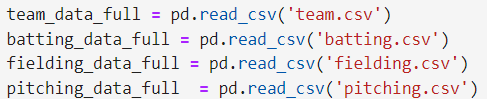

### 2.2 Exploring team_data_full 

The first team_data_full dataframe contains aggregated (sum) team statistics, including metrics such as wins, losses, and games played for each particular year. The dataset provides a good foundation for calculating the win percentage, defined as the ratio of a team's wins to the total number of games played. Key columns, such as 'year' and 'team_id', are extremely critical for merging with other dataframes and should be included when before merging. Notably, divisions were introduced in 1969, leading to many null values in related categorical columns for earlier years. This is alright as my key columns of interest are wins and games played and divisions does not affect them. The primary columns of interest for this analysis are year, team_id, w (wins), and g (games played), which will be used to create the Win_Percentage.

Boxplots plotted as seen below reveal numerous outliers in some columns, such as 'g', due to historical variations in the number of games played each season in MLB, particularly in its early years (dataset included years all the way back to 1871). Calculating the win percentage may help normalise these values, placing them on a consistent scale from 0% to 100%. 

Fortunately, the columns of interest do not exhibit missing data at this point in time, ensuring the usability of this dataframe without significant issues.

### 2.3 Exploring batting_data_full

Next, the batting_data_full dataframe provides batting statistics along with 'player_id', 'team_id', and 'year'. The distribution of many batting statistics skews towards zero, likely due to numerous players with minimal game appearances, distorting the statistics. A potential solution I can think of right now is to possibly filter players based on a minimum threshold of games played, thereby focusing on more significant contributors(players). To aggregate average player statistics, we can group the data by 'team_id' and 'year', enabling a subsequent join with team_data_full.

The missingness pattern shown for the numerical column displays a significant number of null values in the early records, with some records around the middle consistently having null values across the same records. After filtering, the plan is to use all relevant columns, excluding stint.

It's also important to note about potential multicollinearity issues, as some of these statistics are highly correlated. This will be and should be addressed in the later stages of the analysis if required.

### 2.4 Exploring fielding_data_full

Similar to the batting_data_full, the fielding_data_full dataframe includes fielding statistics along with player_id, team_id, and year. The distribution of statistics is again skewed due to players with minimal game appearances. Filtering based on a minimum number of games played will be essential. Aggregating average player statistics by team_id and year will allow for integration with team_data_full.

The data exhibits significant outliers, particularly where some columns have consistently low values, making most other data points appear as outliers. We will look to try and address these issues after merging the datasets and calculating relative averages.

We can also see that there are multicollinearity issues between some columns in the fielding_data_full as seen from 'wp'(wild pitches) and 'po'(putouts) having a correlation coefficient of 0.9. These potential issues should be handled if still present later on after the merging of tables.

Countplots of categorical variables were plotted. I believe that the columns 'pos' (position) and 'player_id' may not be necessary when merging, as the focus will be on team-level statistics. The unique identifier formed by team_id and year will ensure that the merging of tables will proceed without duplication issues.

### 2.5 Exploring pitching_data_full

The last pitching_data_full dataframe follows a similar pattern, containing pitching statistics. While there is a diverse range of metrics, such as 'era' (earned run average) and 'sv' (saves), certain columns like 'stint', 'w' (wins), and 'l' (losses) will not be used to avoid potential data leakage, as the machine learning model aims to predict win percentage.

Outliers are present, one notable one being in the 'baopp' column, which has extreme upper-range values skewing the distribution. This will need further exploration to decide on imputation strategies if necessary.

Pearson correlation of features indicates that several columns are highly correlated with coefficients close to 1 or -1, and may require careful handling of multicollinearity in subsequent steps. The column g_idp showing a blank below indicates numerous null values and will likely be dropped.

It is further confirmed that the column 'g_idp' has mostly null values and should be dropped in the data wrangling section. After filtering the years,  the null values at the start should not appear in the missingness pattern and that will be confirmed in the later section.

After the exploration of the different tables, I believe that I have came up with a problem statement to explore.

### 2.6 Problem Formulation

As the 2014 MLB season comes to a close, Houston Astros finds themselves with a 70-92 win-loss record. In professional baseball leagues like MLB, small market teams such as Houston Astros often face challenges competing with larger market teams due to financial disparities. To maximise their competitive edge, Houston Astros need to identify undervalued players who can significantly improve their win percentage and overall team success. This project aims to develop a regression model that predicts a team's season win percentage based on the averages of their players' pitching, batting, and fielding statistics. By pinpointing the most impactful metrics, Houston Astros can strategically recruit undervalued players to increase their chances of on-field success, leading to more revenue opportunities.

## 3. Data Wrangling on multiple tables<a id="part12"></a>

### 3.1 Data Wrangling on team_data_full

After lots of testing and understanding of the missingness in the datasets, I opted to use data from 1955 onwards, excluding the year 2015. This decision was driven by the following factors as shown below.

Batting Data:
- Intentional walks started being recorded in 1955.
- Sacrifice flies began being tracked in 1954.
- Caught stealing started being tracked in 1951.

Fielding Data:
- Before 1954, there were missing values for innings played as outs.

Pitching Data:
- Intentional walks were only tracked starting in 1955.
  
Imputing missing values for these statistics before their introduction would be misleading, as the data was not collected.

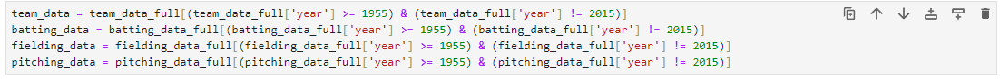

Below is an overview of team_data (.info() output).

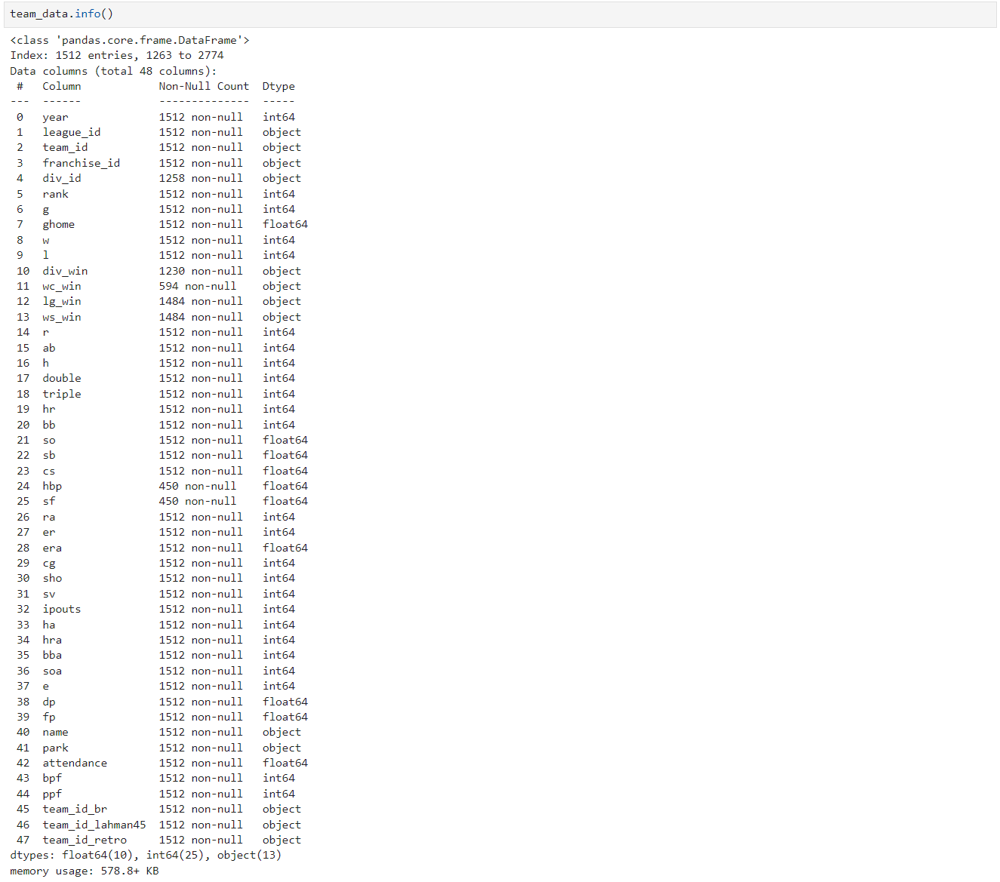

To calculate t_Win_Percentage (where "t" indicates the team's win percentage), I divided the number of wins (w) by the total number of games played (g). The year and team_id columns were retained for merging tables.

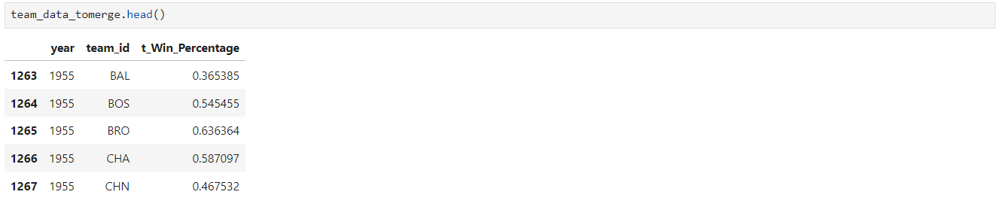

### 3.2 Data Wrangling on batting_data_full

Following the outlined filtering criteria, I excluded players who participated in fewer than 15 games. Many null values were associated with players who played very few games such as like one or two games, which could really distort the statistics. To decrease the possibility of inaccurate reflection, a threshold of 15 games was set to balance statistical reliability with inclusiveness.

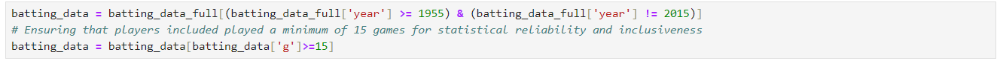

Below is an overview of batting_data (.info() output).

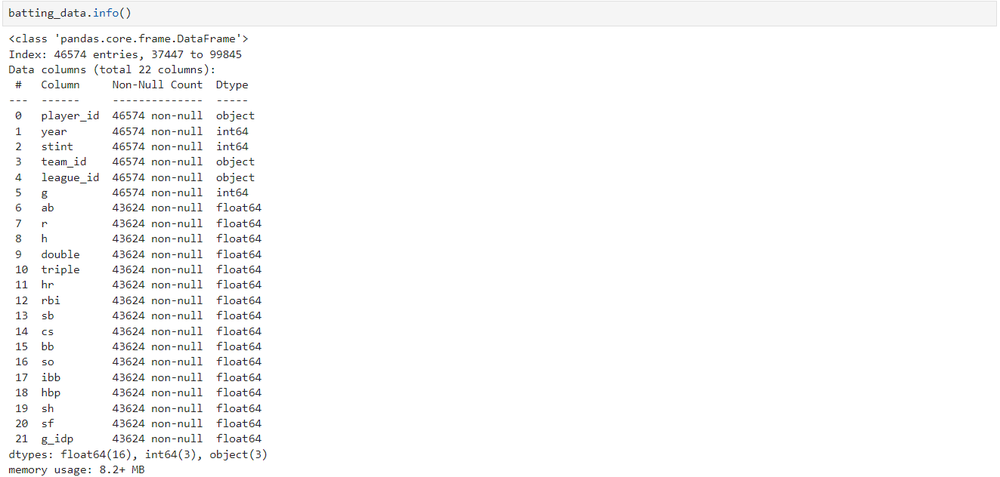

From the missingness pattern as seen below, most of the null values were actually concentrated within the same records.

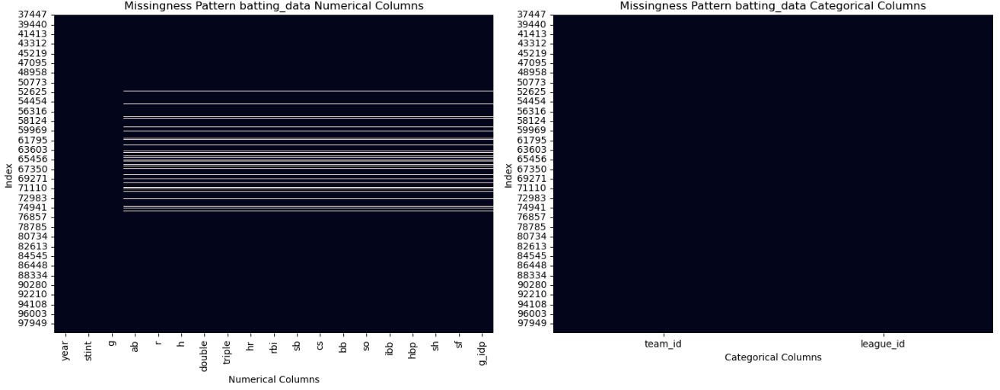

Therefore, with this knowledge of the missingness in batting_data, I believe that the best method here to handle the missing values was to drop the records containing these null values instead of introducing biases across all the columns by trying to imputing them.

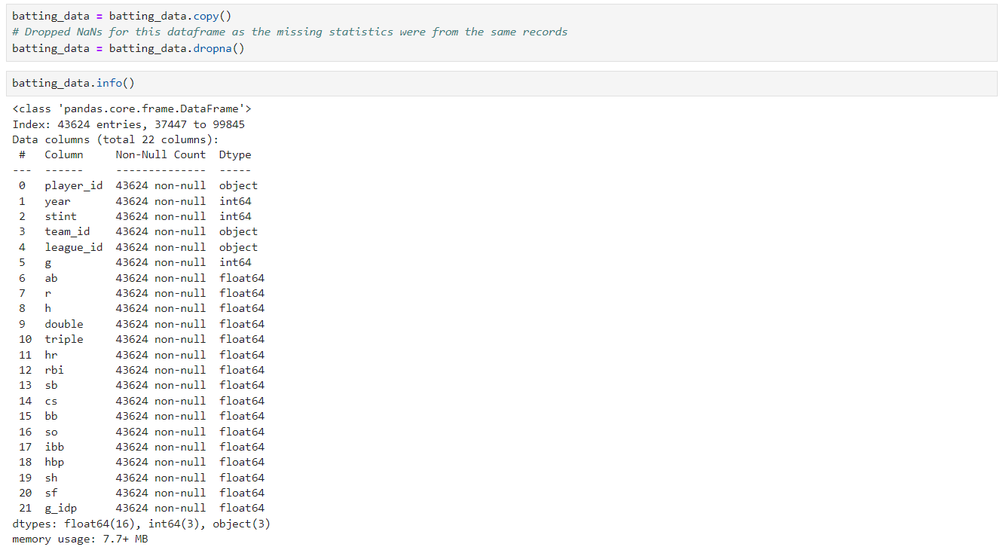

After handling the missing data, I aggregated and grouped the data by 'team_id' and 'year' and calculated average player statistics per game. It was essential that the missing data was handled before the aggregation as it would lead to null aggregated results.

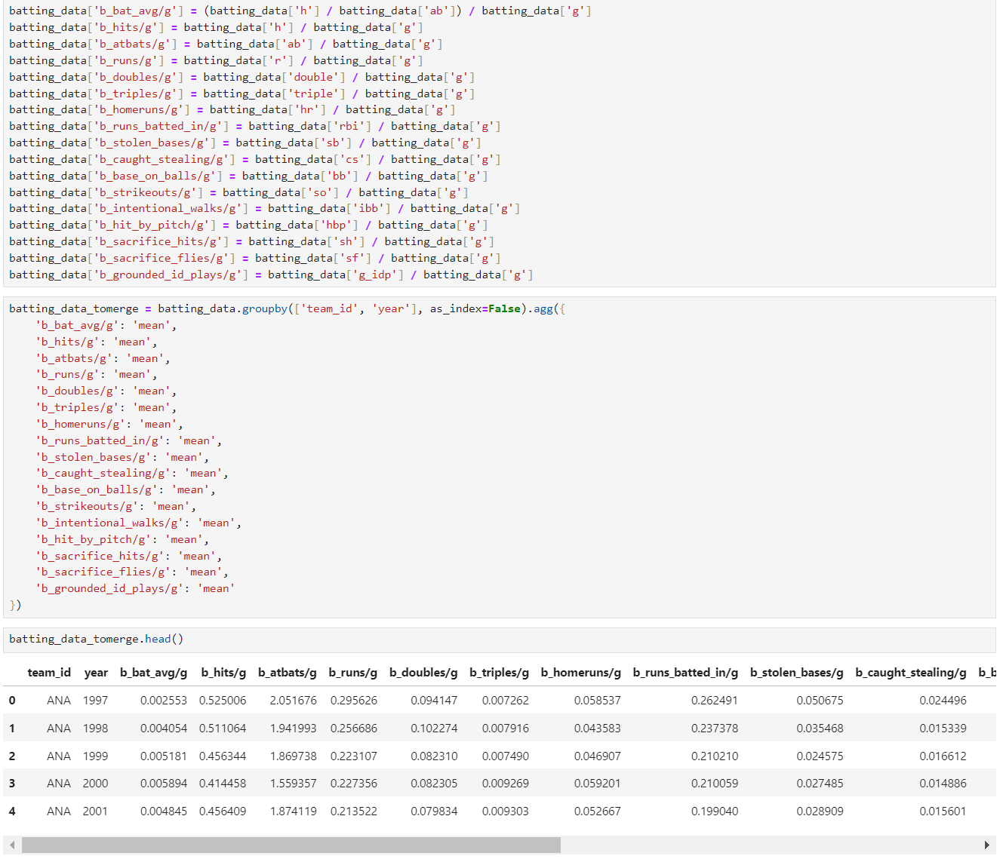

### 3.3 Data Wrangling on fielding_data_full

As mentioned previously, this is how the years were filtered. The filtering of players were still kept consistent, filtering out players who had less than 15 games played.

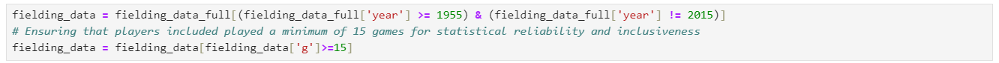

Below is an overview of fielding_data (.info() output).

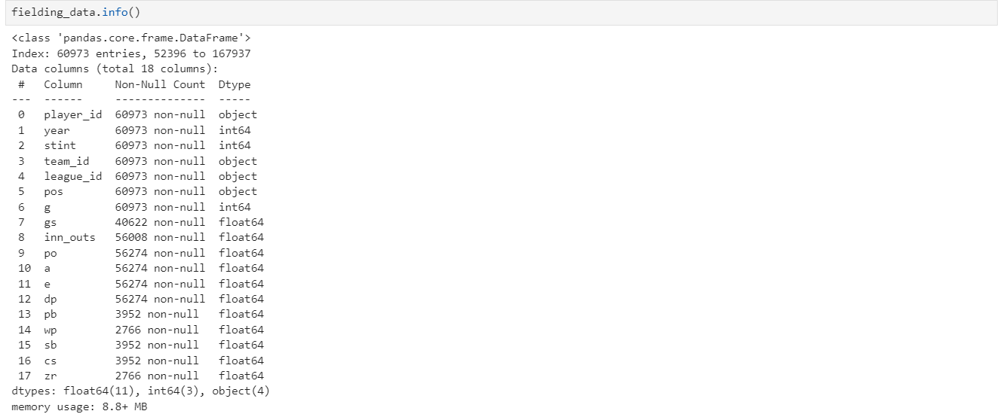

From the missingness pattern as seen below, an examinsation of it reveals that a large extent of the values in the columns 'pb', 'wp', 'sb', 'cs' and 'zr' are missing. Additionally, 'gs' had a large portion of missing values in recent years. It can also be seen that the columns 'po', 'a', 'e', and 'dp' had missing values primarily from the same records, which also affected some in the 'inn_outs' column. Interestingly, for 'inn_outs' there seems to be some null values missing at random.

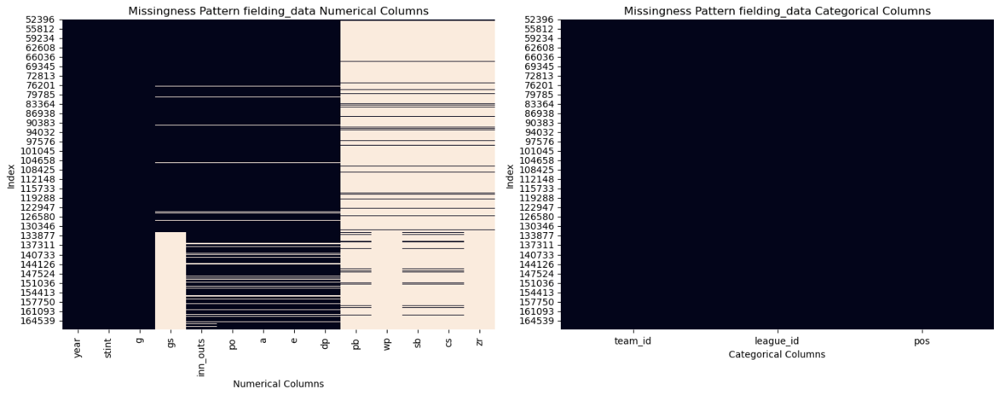

Given the extent of missing data, I dropped the 'gs', 'pb', 'wp', 'sb', 'cs', and 'zr' columns and excluded records with null values in the 'po', 'a', 'e', and 'dp' columns.

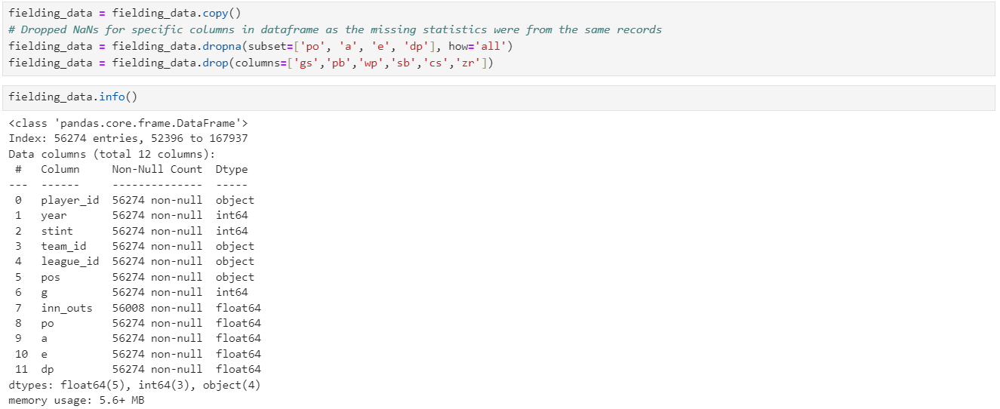

Now, we can look the handle the missingness in the 'inn_outs' column

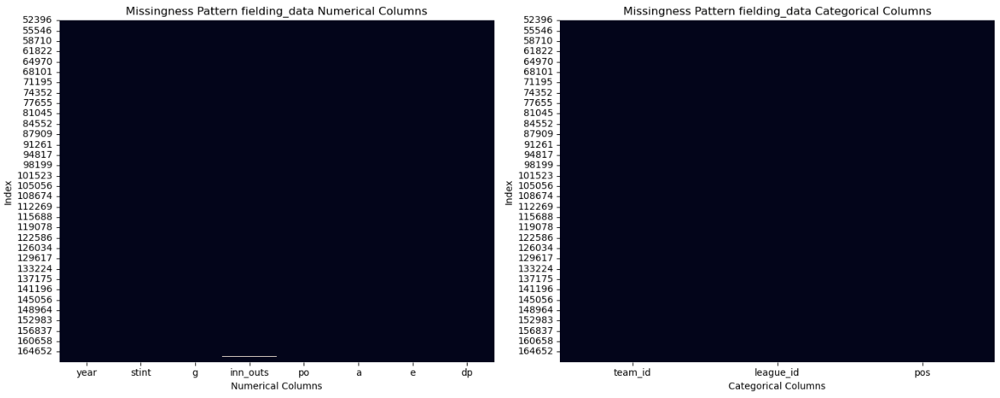

Taking a look at the average games played for years with null values in the 'inn_outs' column. Their games played are not insignificant and should not be excluded.

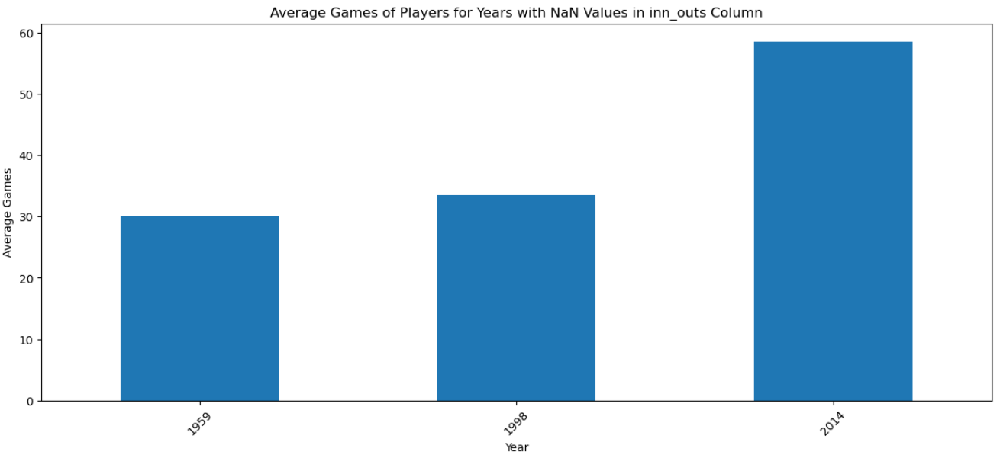

After taking a look at the percentage of nulls in the 'inn_outs' column for these years, the year 2014 has about 20% of null values and below 1% of null values in the years 1959 and 1998. After rigorous testing on mean imputation, mode imputation and median imputation, I went with mean imputation and multiplied the mean inn_outs/g with the number of games played for the records with null values in that column. I believe that mean imputation had the most positive impact on the machine learning model metrics in the later section, as it looked to offer a more accurate representation of the overall for that year.

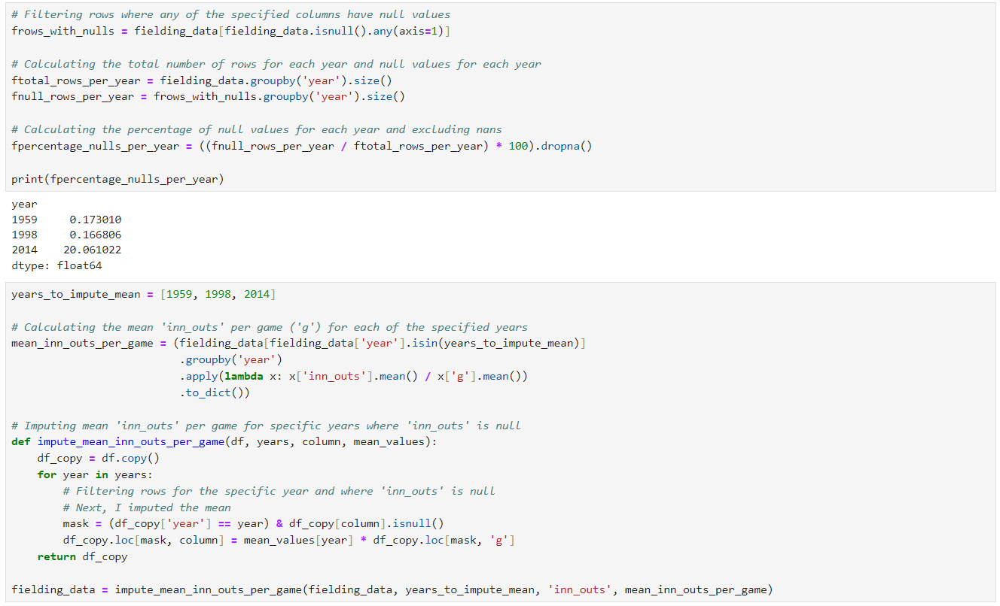

And with that, we have handled the null values and below displays a .info() again.

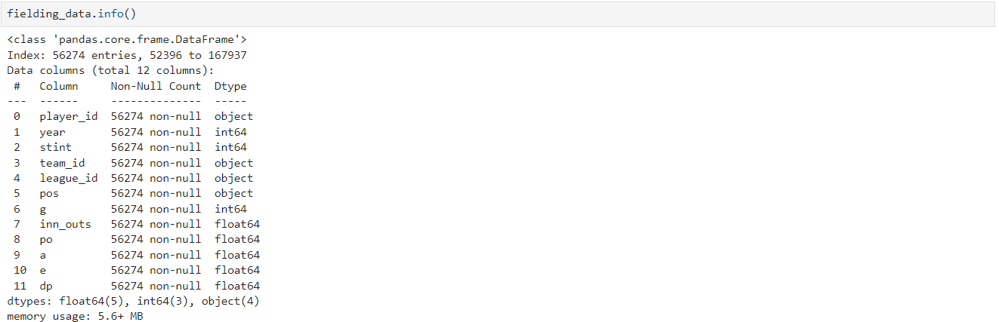

Following the handling of null values, I aggregated and grouped the data by 'team_id' and 'year' to obtain the average player statistics per game. I also calculated fielding percentages using the columns of 'putouts', 'assists', and 'errors' to look to improve the performance of the model.

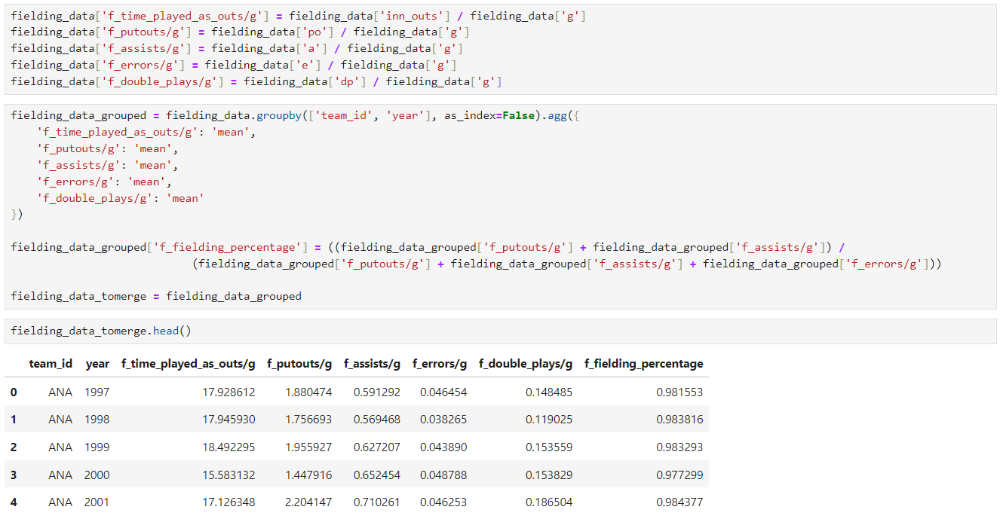

### 3.4 Data Wrangling on pitching_data_full

Again, as mentioned previously, this is how the years were filtered. The filtering of players were still kept consistent, filtering out players who had less than 15 games played.

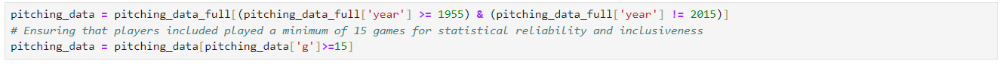

Below is an overview of pitching_data (.info() output).

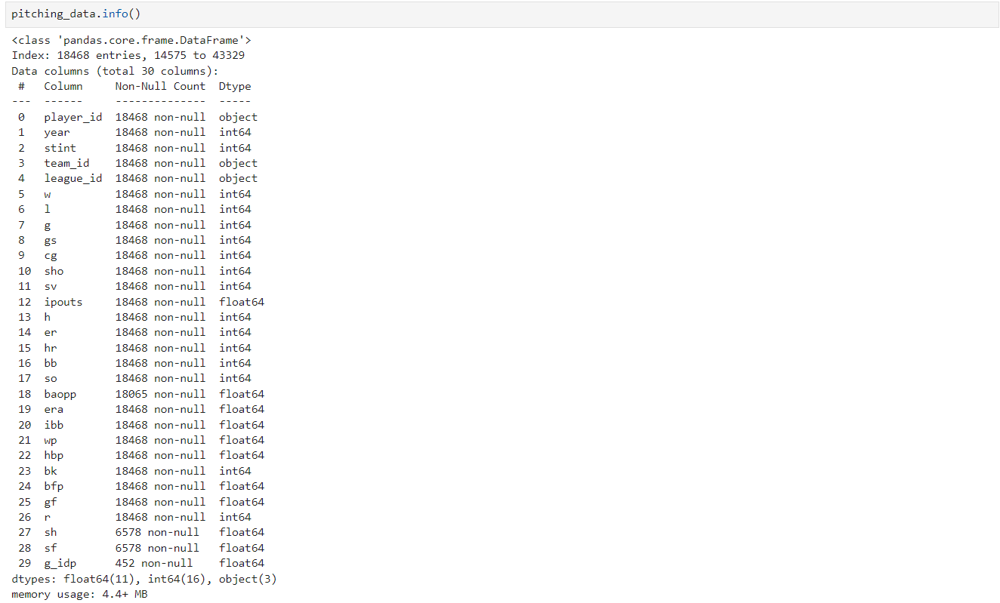

From the missingness pattern as seen below, there is a large portion of null values in the columns 'sh' (sacrifice hits), 'sf' (sacrifice flies) and 'g_idp' (grounded into double plays). It can also be seen that theres a small portion of missing data in the 'baopp' column which should be further looked into. 

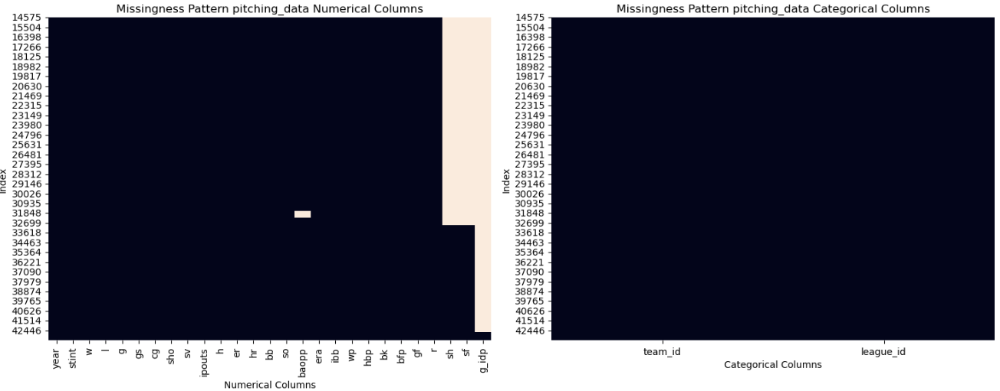

I decided to drop the columns 'sh' (sacrifice hits), 'sf' (sacrifice flies) and 'g_idp' (grounded into double plays) as these columns had more than 50% null values, making it pointless to impute at all. This leaves us with only one column left to handle for null values, which is 'baopp'.

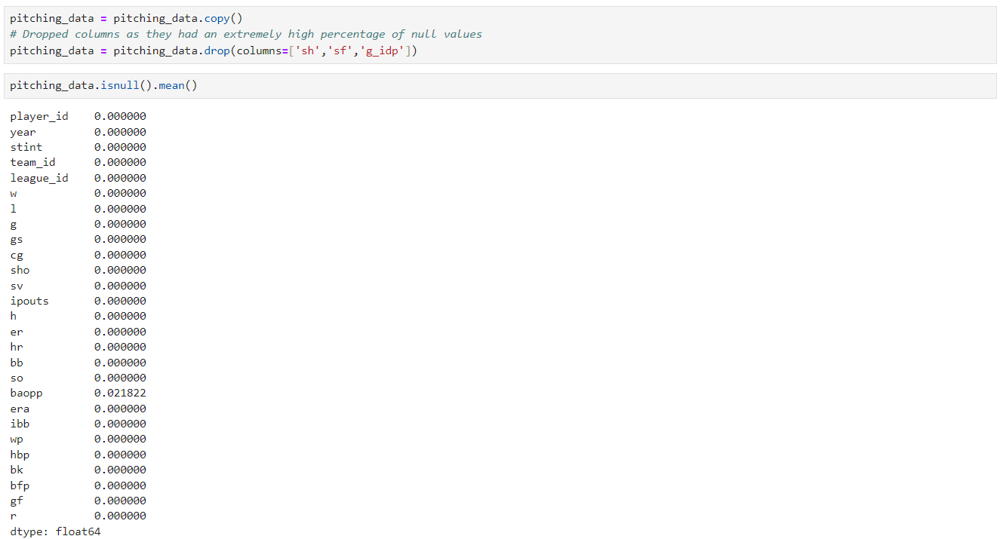

Taking a look at the average 'baopp' across all the years, we can see that the year 1999 has an 'baopp' average of 0 although it does not have any null values. For the year 1998 though, it had fully null values.

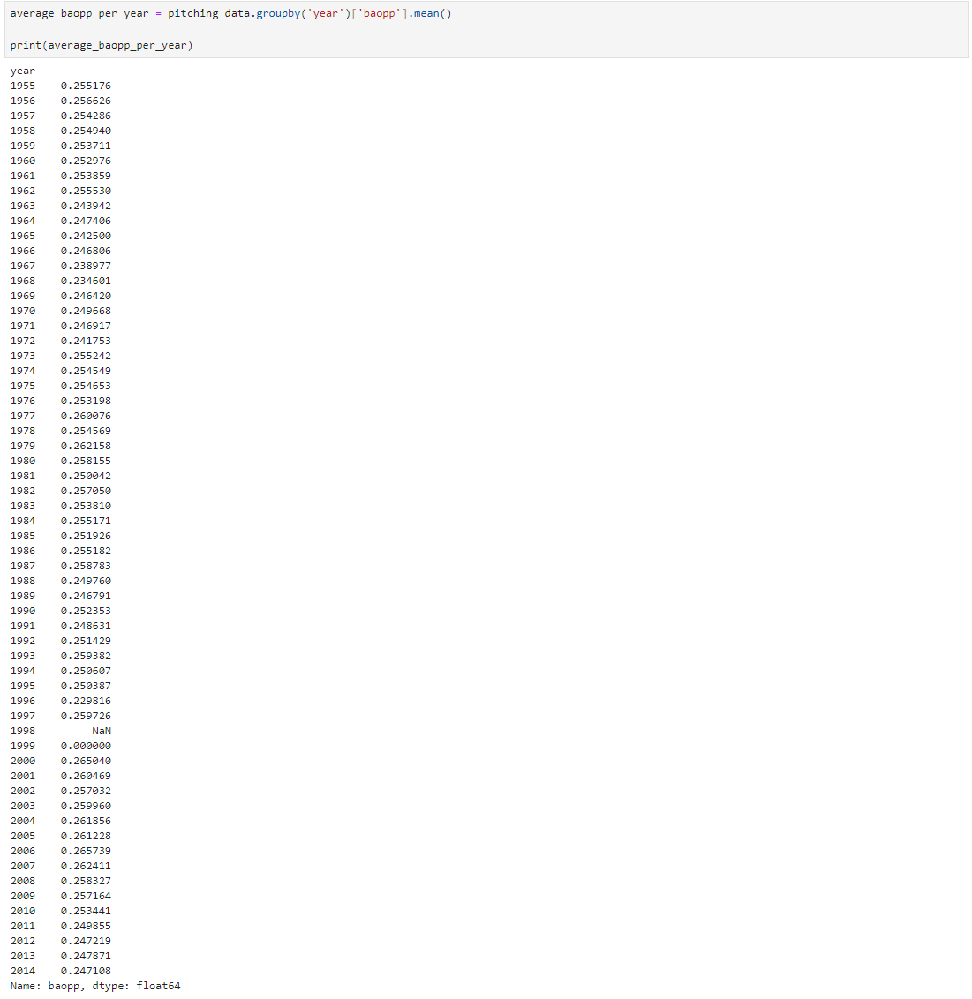

Therefore, I decided to drop the 'baopp' column entirely. Introducing imputation for these columns would not provide meaningful data as it will result in the lack of variance in these specific years of 1998 and 1999, therefore I went ahead with this decision.

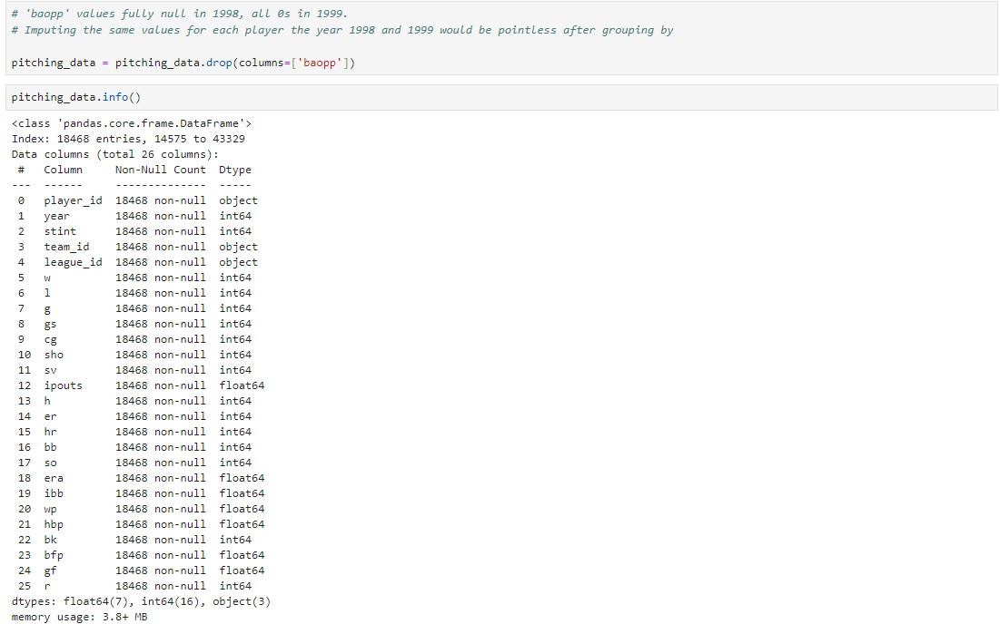

Subsequently, after the handling of missing data I calculated the pitching statistics per game for every player before grouping by 'team_id' and 'year' to obtain the average player pitching stats across each team yearly. The first 5 rows of the dataframe to be merged is displayed below.

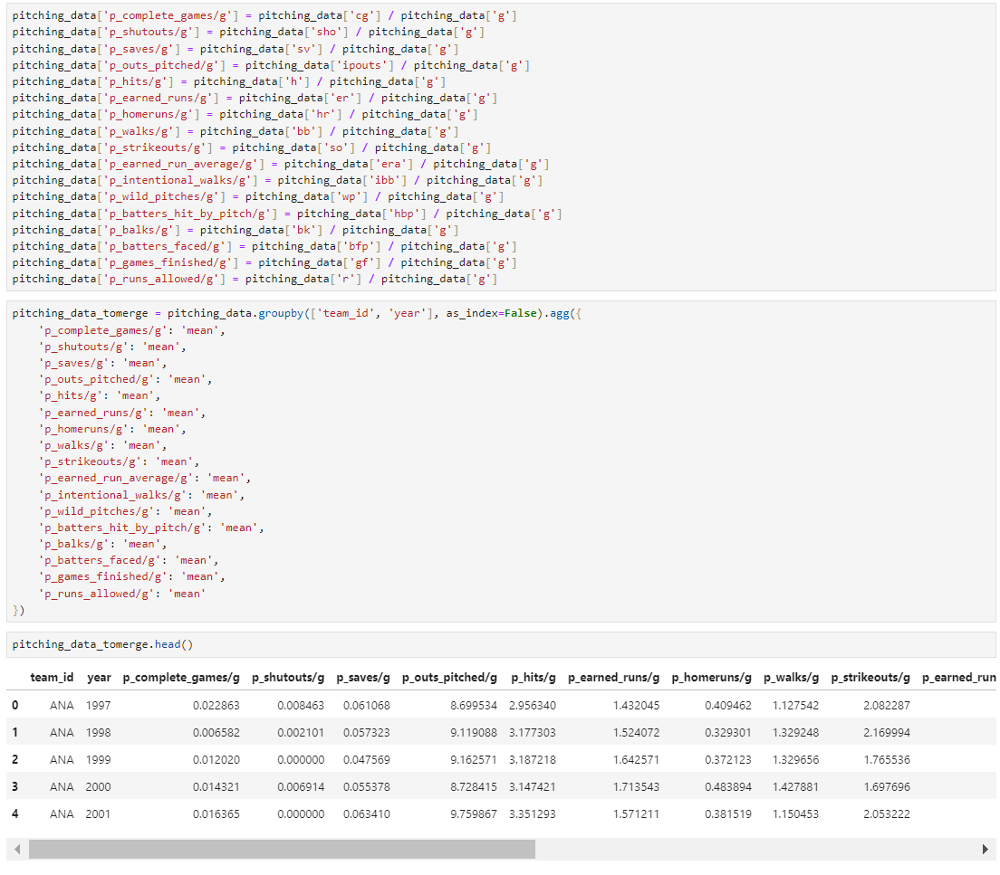

### 3.5 Merging Tables

With the 4 dataframes prepared, I merged all the tables on the team_id and year columns using an inner join, ensuring only complete records were included in the final dataset. The resulting dataframe, baseball_data, had its target variable t_Win_Percentage shifted according to industry standards, as suggested by Mr. Joey. The next python code block writes the dataframe to a .csv file with the name 'baseball_data_averages.csv' which allowed for the efficient testing of code in a separated Jupyter Notebook, decreasing the time taken for testing which I believe would be crucial. 

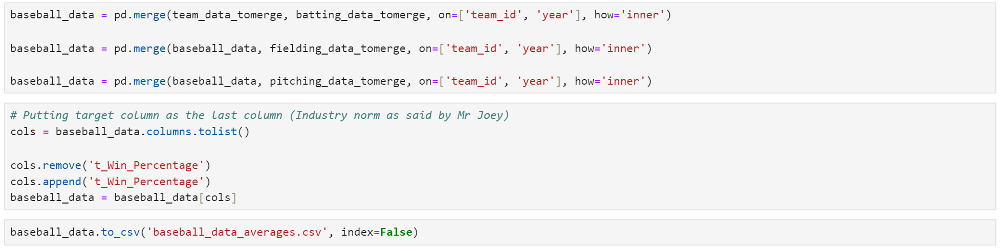

### 3.6 Applying Mathematical Calculations

To account for changes in the overall level of statistics across different years, I normalised each value by dividing it by the mean value for that year to obtain a relative scale. This relative scaling method helps to ensure that comparisons and modeling were not influenced by variations in the environments across eras. For instance, comparing a team averaging five runs per game in 2014 with a team averaging four runs per game in 1955 without considering the changes in gameplay norms would be inaccurate. This approach allowed for a fair and consistent analysis across different periods.

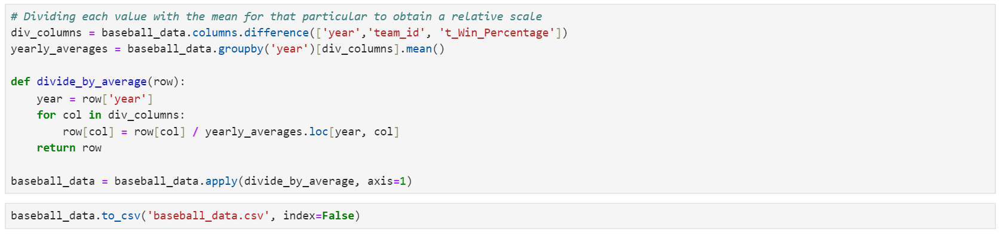

## 4. Data Cleansing and Transformation<a id="part13"></a>

### 4.1 Exploring baseball_data

Upon inspecting the merged dataframe 'baseball_data', we identified that there are 1512 rows and we have a total of 43 columns. We can also see that there are no null values present since they were already addressed in the prior data wrangling phase

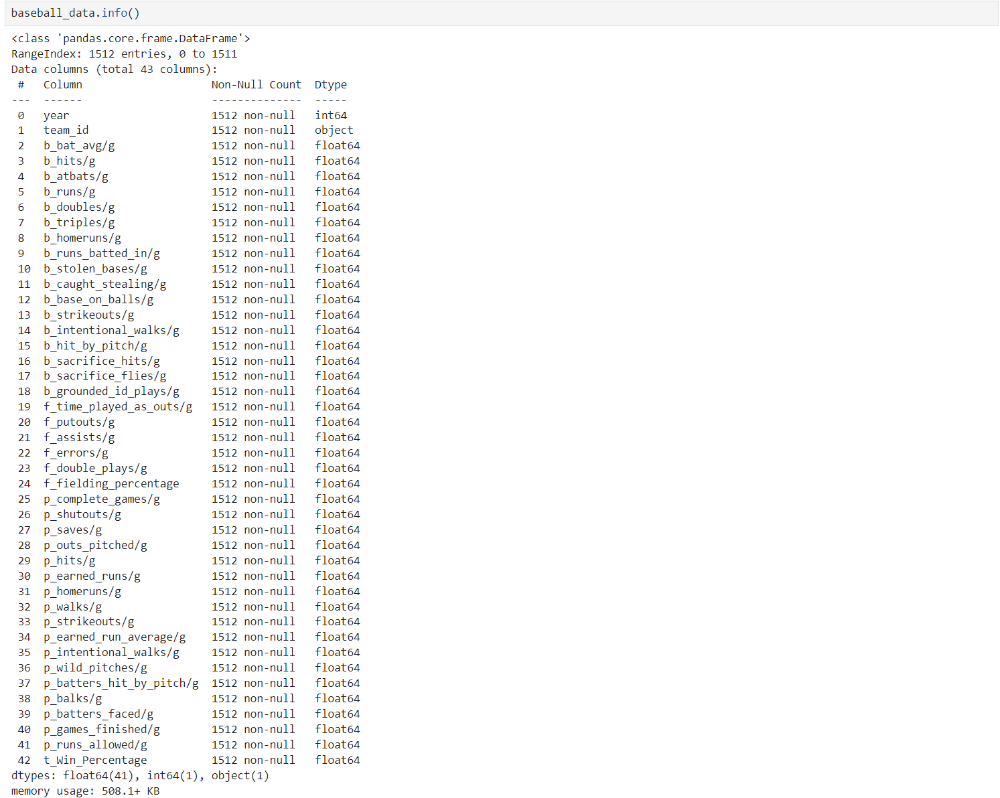

A heatmap plotted out displaying the Pearson Correlation of all features and showed that there were a few columns that were highly correlated among each other. Examples as seen in the heatmap would be 'b_hits/g' and 'b_atbats/g' with an extremely high correlation coefficient of 0.94. This occurence of high correlations is called multicollinearity and it can lead to skewed or misleading results when trying to determine how well each independent variable can be used most effectively to predict or understand the dependent variable in a statistical model. Therefore, we will make sure that some of these columns are handled by dropping some of them after comparing the model's metrics.

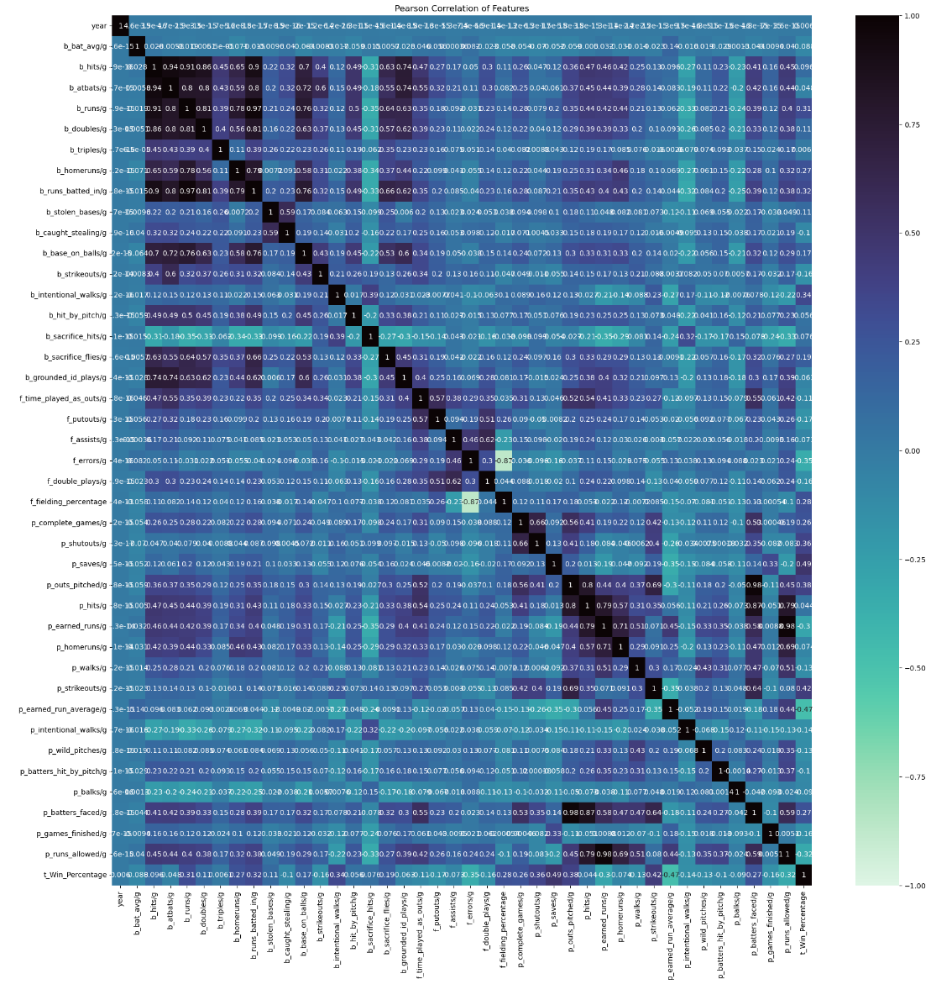

### 4.2 Addressing Multicollinearity

The following python code was used to flag out the unique pairs of columns with multicollinearity issues. The threshold I decided to go with was if two columns had an absoloute coefficient value greating than 0.7. Taking a look at the output of the python code, we can see that there are many columns with multicollinearity issues, with some columns such as 'b_atbats/g' appearing very frequently with an extremely high of about six times in the list.

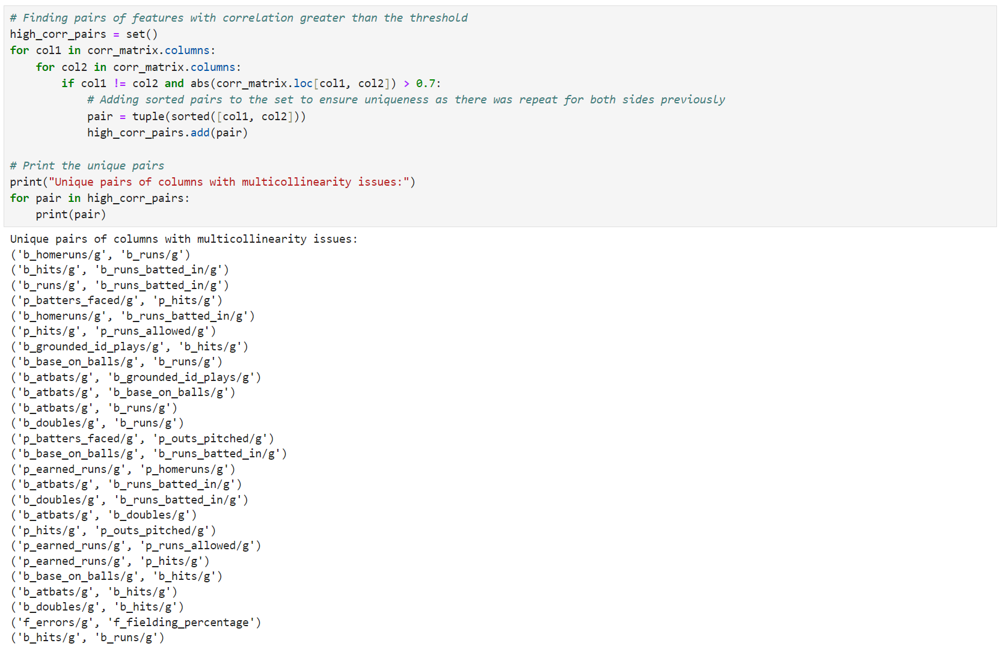

I then got to testing the python codes to drop specific columns. For each unique pair, I compared dropping either one of the two and evaluated its success using the model's metrics. For example, I tested dropping 'f_fielding_percentage' by itself and dropping 'f_errors/g'. For example, seeing that the model performed worser when 'f_errors/g' is dropped compared to 'f_fielding_percentage', I decided to drop 'f_fielding_percentage'. In addition to these specific columns, I also dropped 'year' and 'team_id' as these columns were not of use anymore after I had merged the tables. After dropping some columns as shown in my code below, there are a total of 31 columns left in my dataframe.

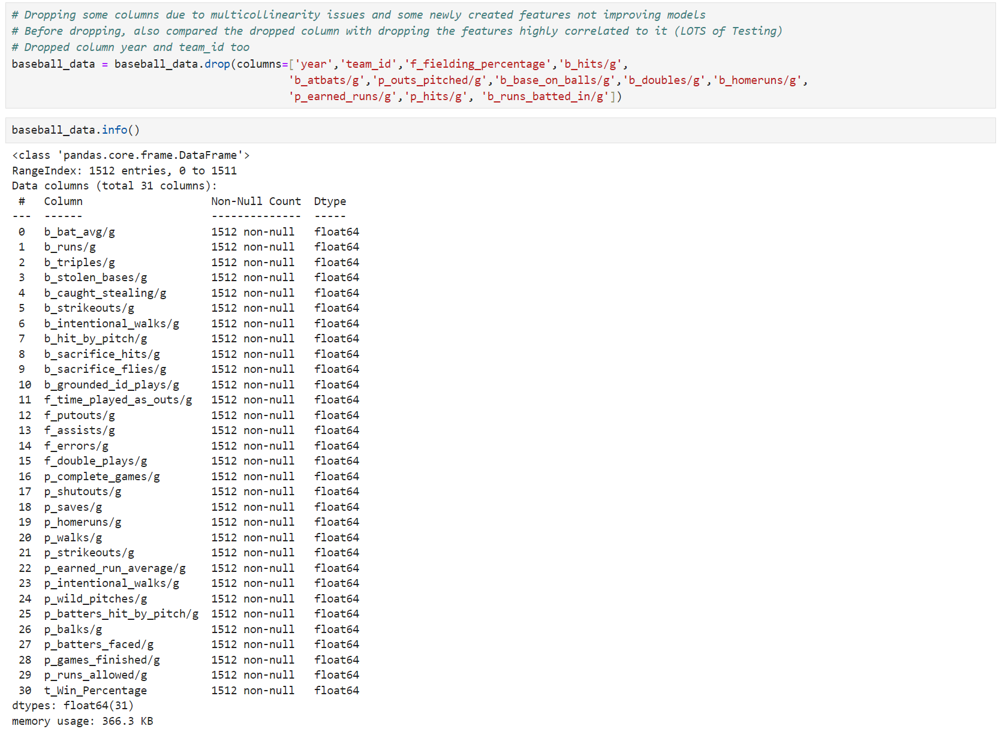

### 4.3 Continuation of Exploring updated baseball_data

Visualising distribution plots of the variables in the dataset will allow me to grasp the overall distribution of each numerical variable which will help me decide on which variables should be transformed if necessary. These distribution plots show that most of the columns in the dataframe are not extremely skewed, however, some columns like 'b_hit_by_pitch/g' amd 'p_shutouts/g' have tails that slightly extend on the right side of their distributions, which could be further investigated.  I believe that comparing the stats relatively and filtering out players who have played fewer than 15 games (which were done in the previous section) were key factors in reducing extreme skewness in the columns.

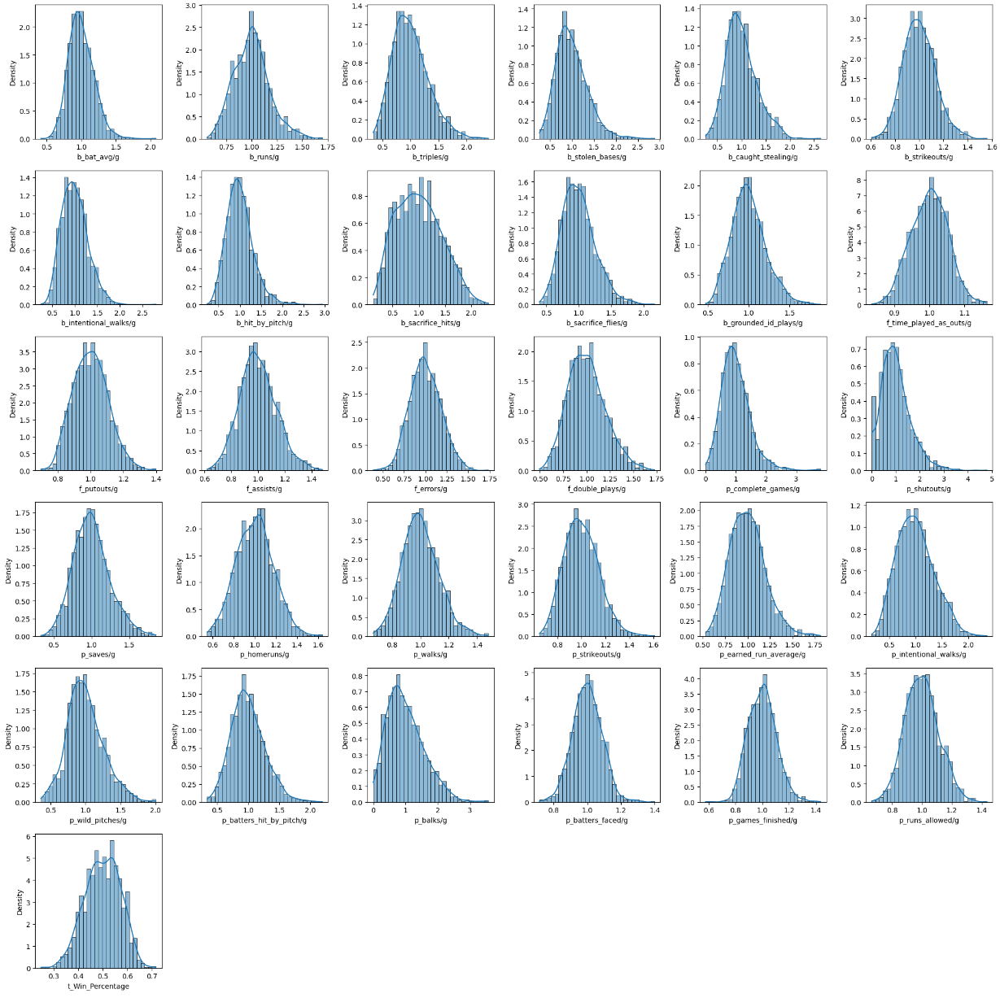

Visualising boxplots of the variables in the dataframe will allow me to get a better idea of the outliers present. It can be observed that there are a few outliers for the columns in the dataset. Some of the outliers in specific columns should be handled appropriately, ensuring that the changes result in me obtaining a better model. Before we proceed, it is important that I do not transform the target variable as we want to predict it in its natural state and not a transformed one, the target variable having a somewhat normal distribution looks good for now.

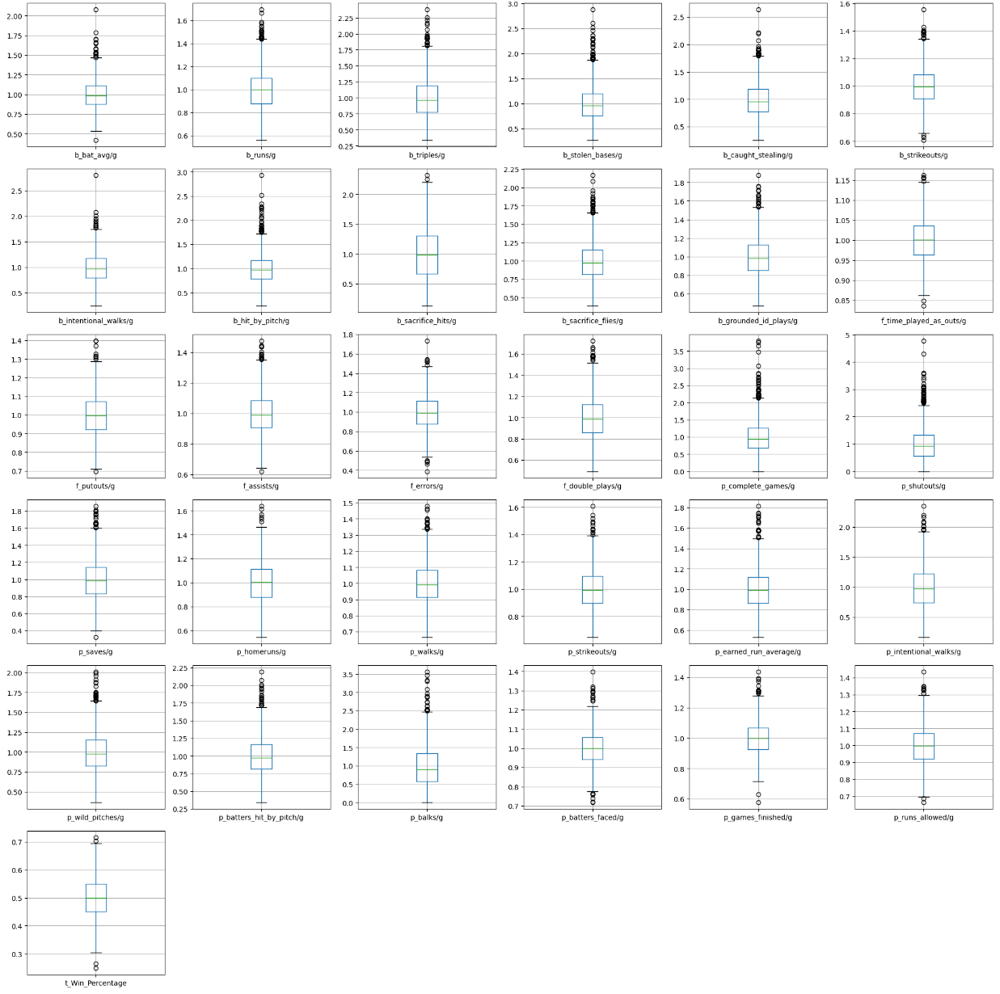

In the last row, we can observe relationships of how a team's win percentage is correlated by its relative average player statistics across all the columns.

Relatively high Correlation Coefficients with t_Win_Percentage

b_runs/g (0.31 Weak Positive), indicates that teams with batters who are able to execute more runs a game are more likely to be win more.

b_intentional_walks/g (0.34 Weak Positive), indicates that teams with batters who are able to execute more intentional walks a game tend to win more.

f_errors/g (-0.35 Weak Negative), indicates that teams with fielders who make less errors tend to win more which is expected.

p_shutouts/g (0.36 Weak Positive),  indicates that teams with pitchers who shutout more often are more likely to be popular.

p_saves/g (0.49 Moderate Positive), indicates that teams with pitchers who are more effective at pitching and good defence tend to be slightly win more.

p_strikeouts/g (0.42 Moderate Positive),  indicates that teams with pitchers who strikeout more are more likely to be win more games.

p_runs_allowed/g (-0.32 Weak Negative),  indicates that teams with pitchers who allow more runs are more likely to lose more games.

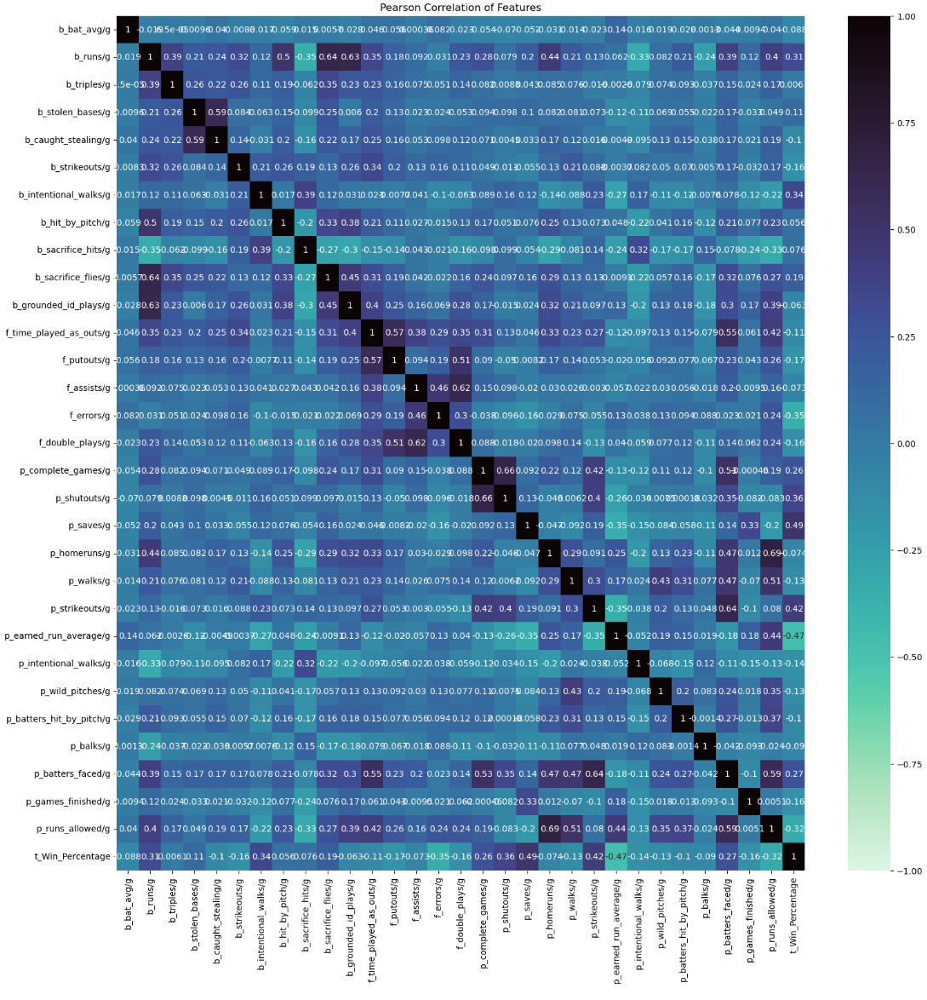

### 4.4 Numerical Data Transformation

Taking a look at the skewness of the columns, some columns like 'b_hit_by_pitch/g', 'b_stolen_bases/g' ,'p_complete_games/g' and 'p_shutouts/g' have considerably higher skewness values. These columns should be further investigated to determine if they could be handled.

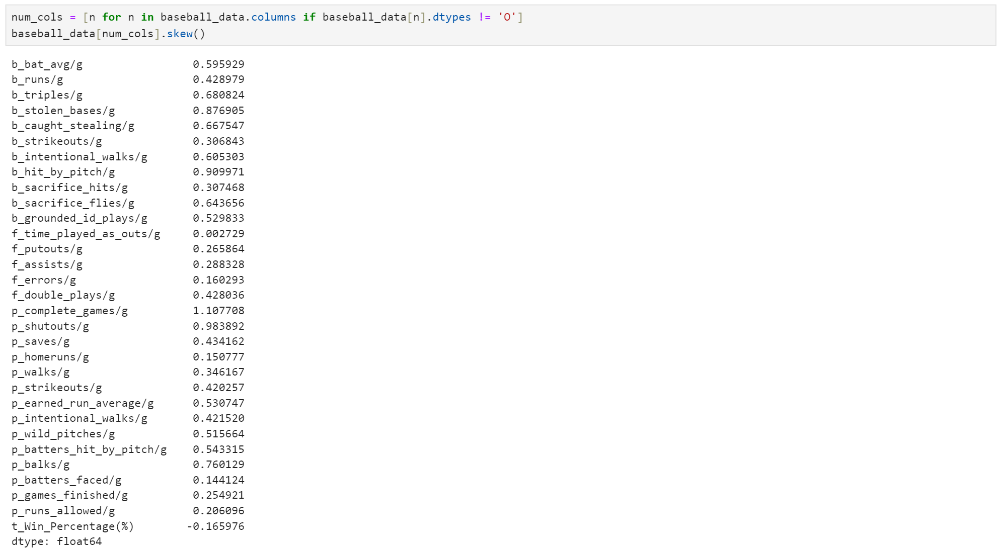

After rigorous testing on many columns, I performed numerical transformation on these 3 variables, 'f_time_played_as_outs/g', 'p_complete_games/g', 'p_shutouts/g' as they had improved the model.

Although, the distribution of the variable 'f_time_played_as_outs/g' looked normal, performing a logarithmic transformation of it had further improved its normality, improving the model.

Diagnostic Plots Before:

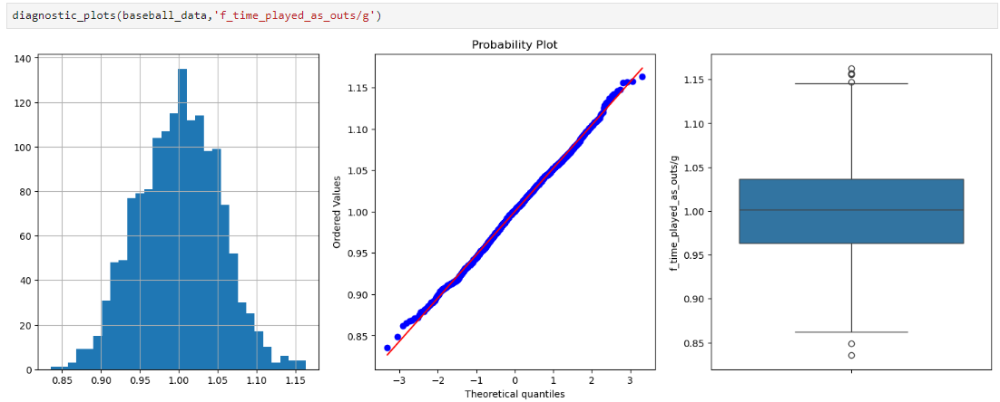

Diagnostic Plots After Logarithmic Transformation:

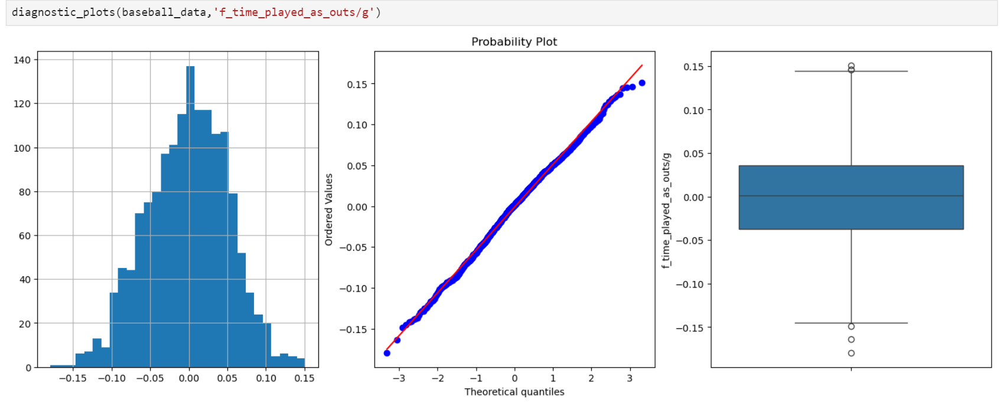

Moving on to handling the variables 'p_complete_games/g' and 'p_shutouts/g', I used a logarithmic transformation with shift with an addition of 1e-6 as they had zero values
I believe that this transformation was particularly effective in reducing the skewness of the variables and improved the model.

Diagnostic Plots Before:

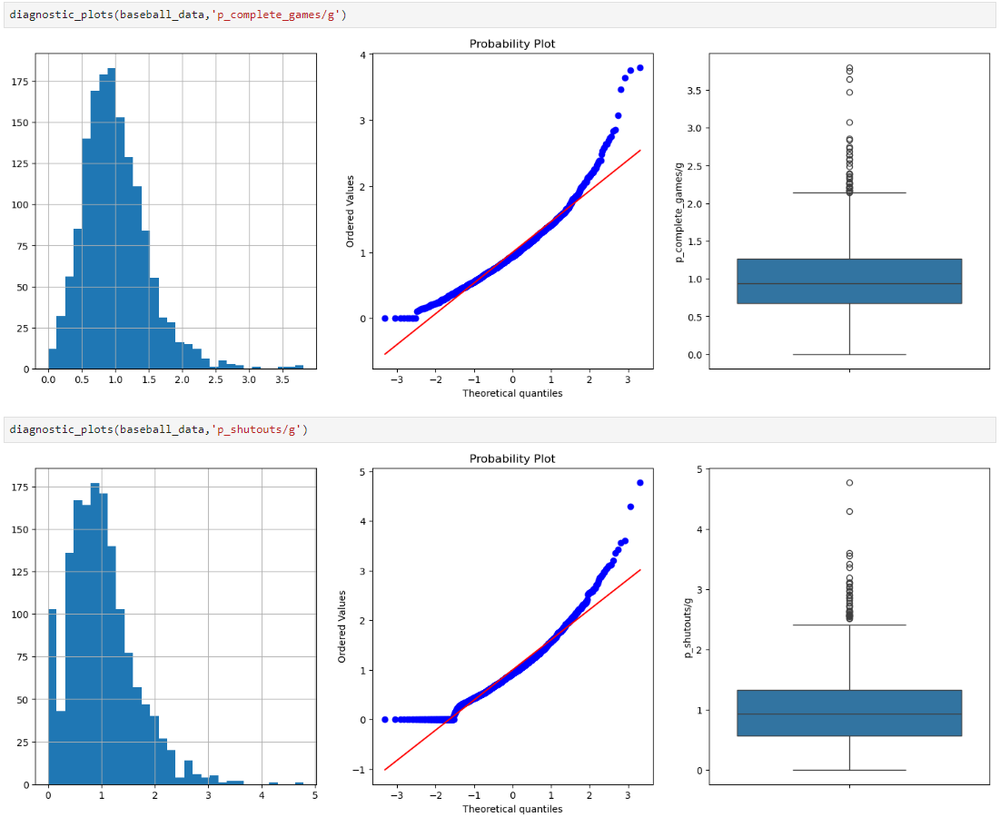

Diagnostic Plots After Logarithmic Transformation With Shift:

I believe that I should consider the need to handle the outliers values at the lower end as seen below.

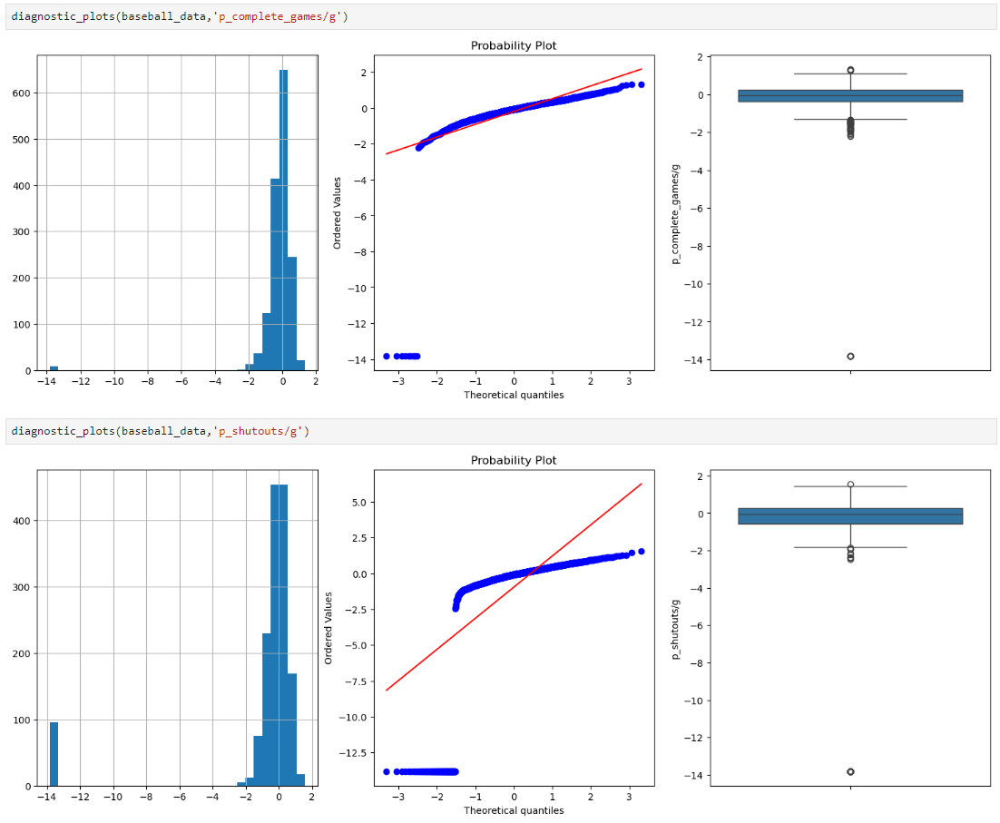

### 4.5 Outlier Capping

A boxplot of all the numerical variables and their skewness are displayed below after numerical transformation of the data was applied to some variables(will be covered in later section under Data Transformation). To handle outliers, I will perform capping on specific columns based on trial and error and the understanding of outliers and how they may affect the model, and I decided on the following variables to cap. I also tried winsorization on some variables but it did not improve the model which could be due to capping maintaining the natural distribution of the data while managing extreme values, whereas winsorisation artificially limits the data by replacing extreme values with specific percentiles.

After testing the two different functions I defined find_normal_boundaries and find_skewed_boundaries, and testing many combinations of parameters, I ended capping the variables 'b_caught_stealing/g', 'b_strikeouts/g', 'b_intentional_walks/g', 'f_assists/g', 'f_errors/g', 'f_double_plays/g', 'p_earned_run_average/g', 'p_intentional_walks/g', 'p_complete_games/g', 'p_walks/g', 'p_wild_pitches/g' as they had made significant improvements to the model. The results of the outlier capping are shown below.

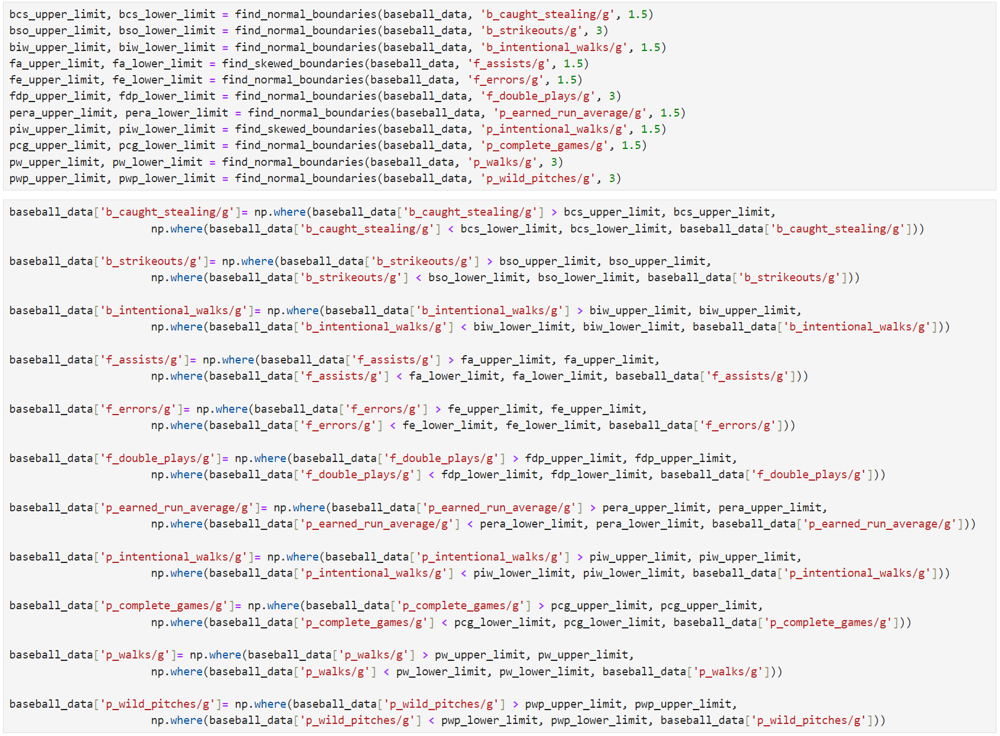

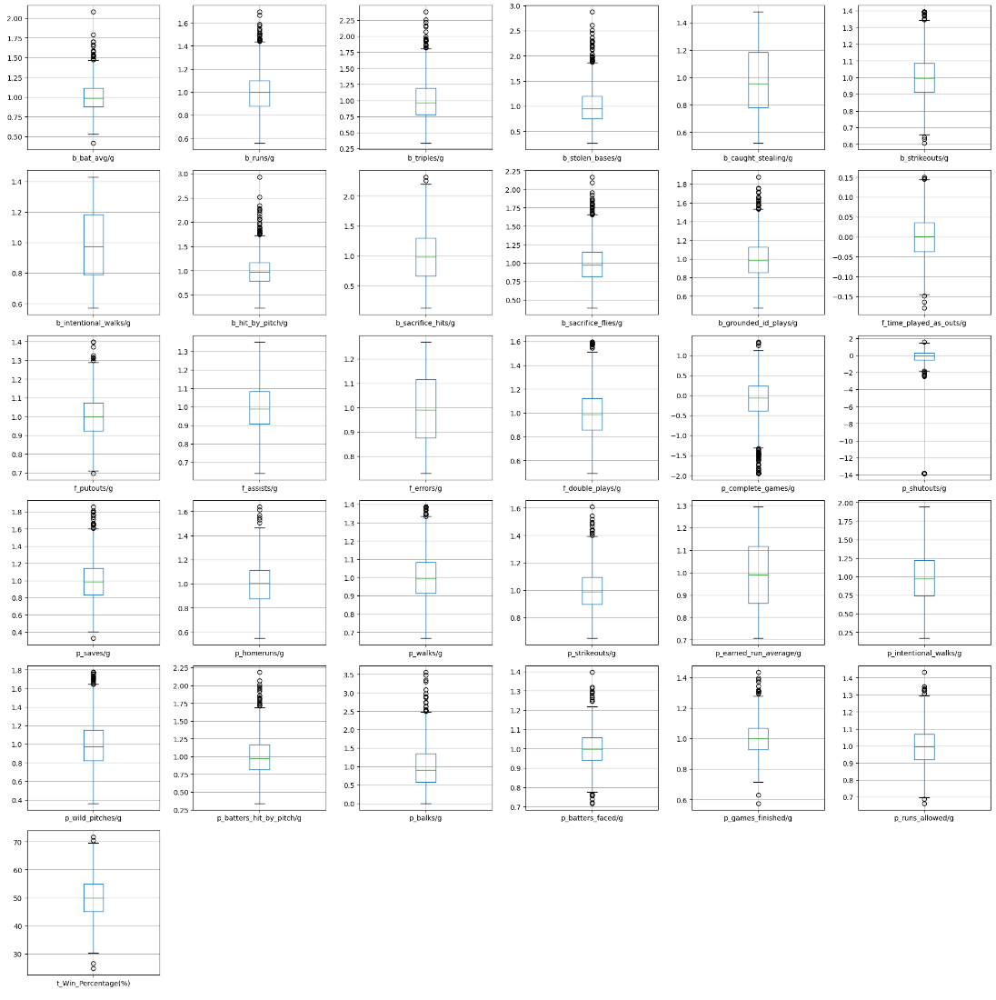

### 4.6 Variable Discretisation (After Train Test Split)

Next, under the variable discretisation section after much trial and error on the numerical variables, I performed Equal Frequency Discretisation on the variable 'p_walks/g' to group the column into 4 bins and helps to ensure that each bin contains approximately the same number of observations. This can help in normalising the impact of highly skewed data and in making these columns more balanced for modelling. I also tried Equal Frequency Discretisation on the columns 'p_complete_games/g','f_double_plays/g', 'p_balks/g','p_batters_hit_by_pitch/g' but it made the model worse which could have been due to the lost of important information from discretising them. I also performed Equal Width Discretisation on the variables 'p_strikeouts/g' and 'f_putouts/g' to divide the range into 5 and 7 equal-sized bins respectively. I believed it was beneficial for these variables where the absolute value differences are important while also improving its interpretability. All this while preserving their distribution characteristics. The results are shown below. 

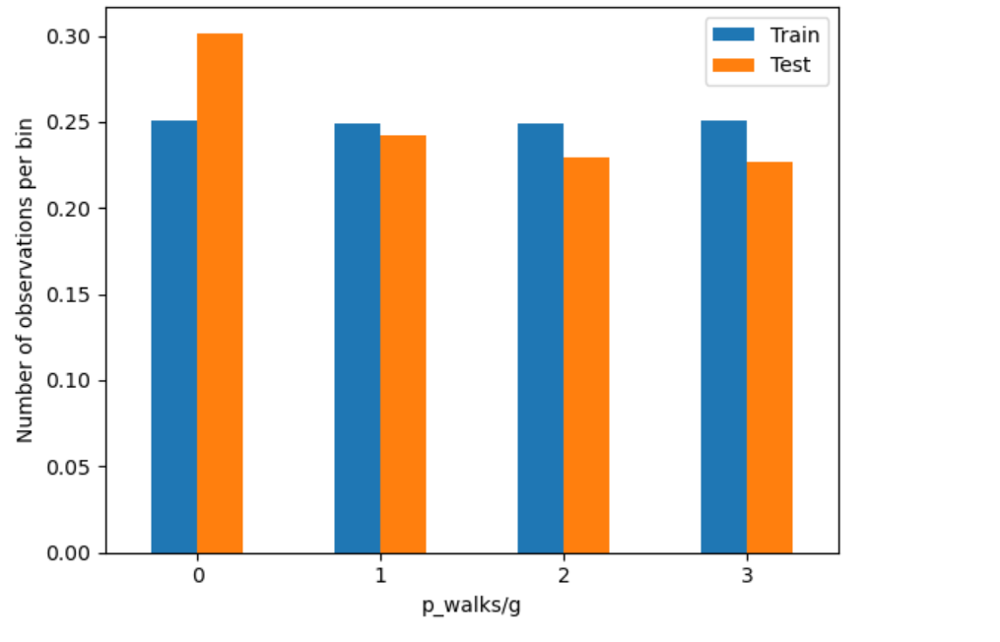

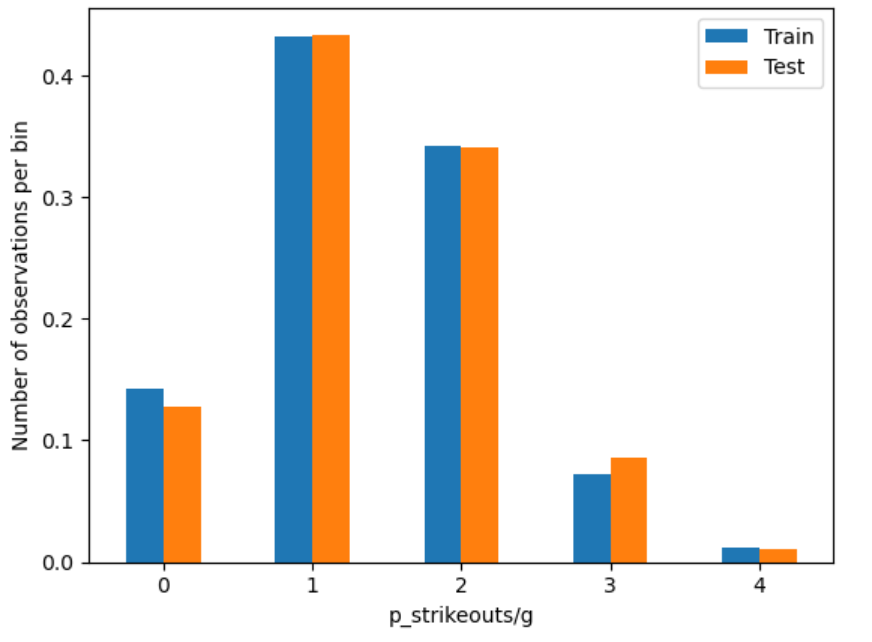

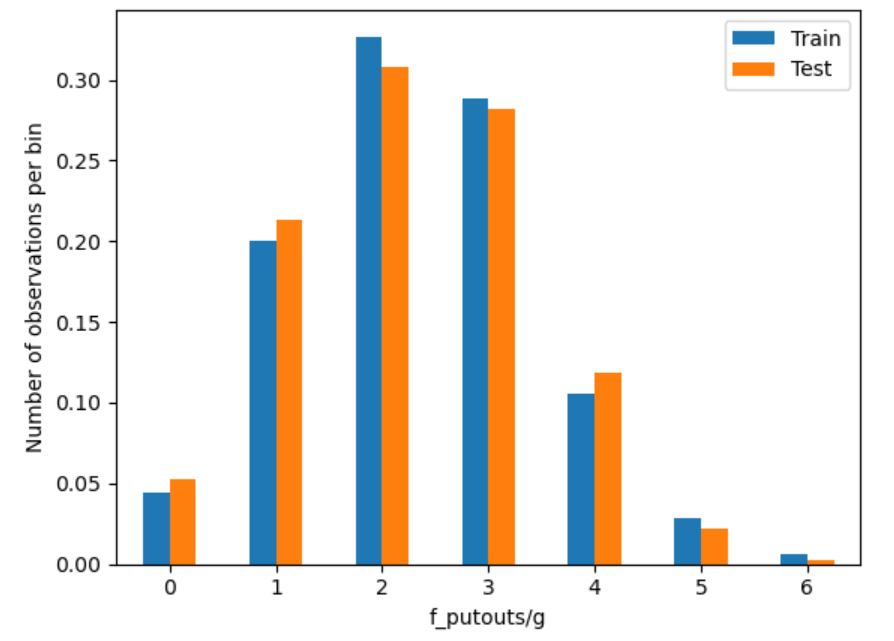

### 4.7 Feature Scaling

Moving on, before I fed my columns into the linear regression model, I performed feature scaling on my numerical columns, deciding between standard scaler, min-max scaler and using mean normalisation. I performed standardisation on all my columns in the X_train and X_test sets. This step was performed after I was done with variable discretisation. I wanted to use standardisation to ensure that all features contribute equally to the model's performance and prevents features with larger scales from dominating the model's learning process. Also, I did not the scale the target variable as it is not needed.

I also experimented with other scaling methods like the min-max scaler and mean normalisation but all of the scalers did not significantly affect the model metrics. After thorough analysis and consideration, I decided to proceed with standardisation as it is a widely accepted practice in many statistical analyses and machine learning algorithms. This helped to ensure that the variations in the predictor variables do not disproportionately influence the model, allowing for a more balanced interpretation across features.

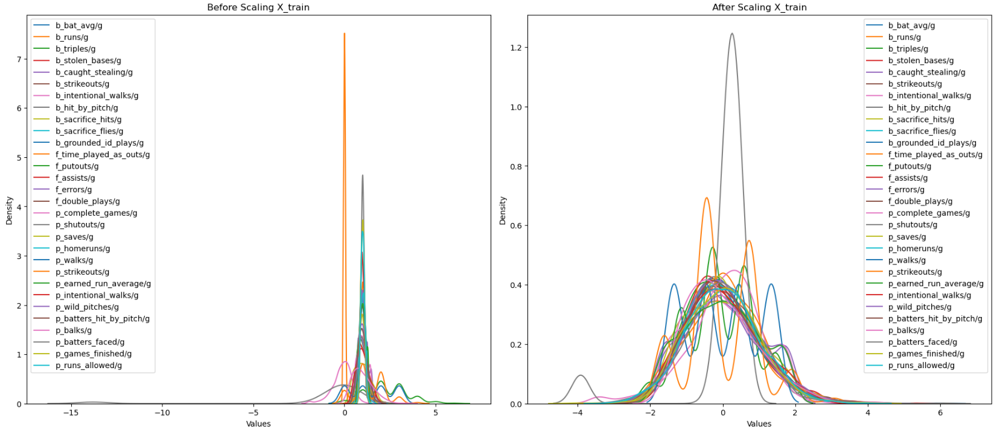

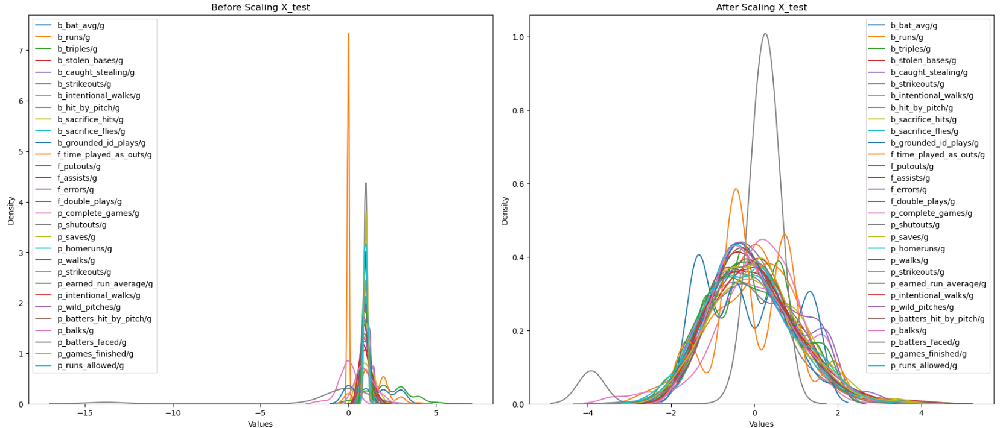

## 5. Machine Learning Model<a id="part14"></a>

### 5.1 Building the Naïve Baseline Model

The train mean target value that was used for the predictions on the model was 49.82 as seen from the output of the python code.

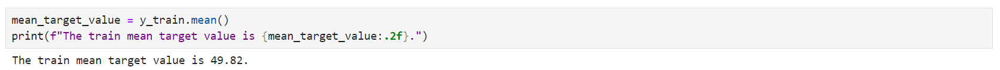

Training Data MSE obtained was 49.414 and for Test Data MSE 53.473 for the Naive Baseline Model. These high values indicate that the model's predictions are not very accurate.
Moreover, its was also expected that the r2 values were extremely close to 0 and negative too. It implies that the Naive Baseline Model does not capture much variance of the factors that influence a team's winning percentage. 

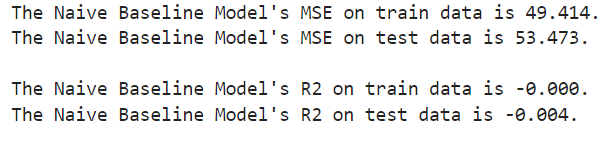

### 5.2 Building & Evaluating The Linear Regression Model

The code was provided for building the model is shown below. For training data, X_train_scaled and y_train represent the input features and target values for training respectively. For the test data, X_test_scaled and y_test represent the input features and target values for testing respectively. Linear Regression is the machine learning model used, in which it finds the best fit linear line between the independent and dependent variables in which the aim is to find the best fit linear line and the optimal values of intercept and coefficients such that errors are minimised.

After the Linear Regression Model was built and ran, the train mse, test mse, train r2 and test r2 is displayed. The MSE (Mean Squared Error) is the variance of the residuals, that is, the squared differences between prediction and actual observation. Lower values of MSE indicate better fit and model performance. Additionally, R-square represents the percentage of the response variable variation that is explained by a linear model. The closer to 1.0 the value of R-square, the more indicative of a better fit and model performance.

Compared to the Naive Baseline Model, the Linear Regression Model performs significantly better

The Training MSE I obtained 9.931(3dp) and the Testing MSE I obtained was 10.159(3dp). The slight MSE difference of 0.228 indicates that the model performs similarly on both the train and test set, with only a slight increase in error on the test set. This suggests that there is good generalisation and there is minimal overfitting in the data which is a good sign. However, as seen from r-sq values of 0.799(3dp) for the train set and 0.809(3dp) for the test set (good fit), the model captures most of the underlying patterns and just leaves a relatively small portion of the variance unexplained, which suggests that further improvements can still be be made such as exploring more complex models to replace the Linear Regression Model.

Additionally, the evaluation clearly shows that the Linear Regression model is far superior to the Naive Baseline Model in predicting a baseball team's winning percentage based on player statistics.

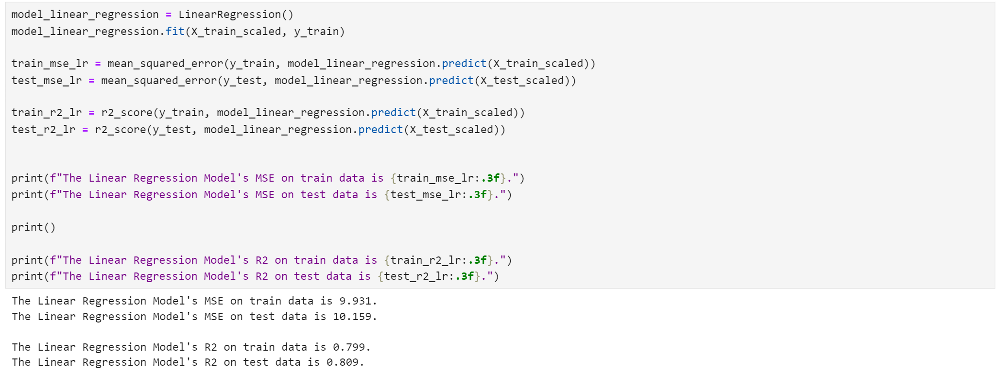

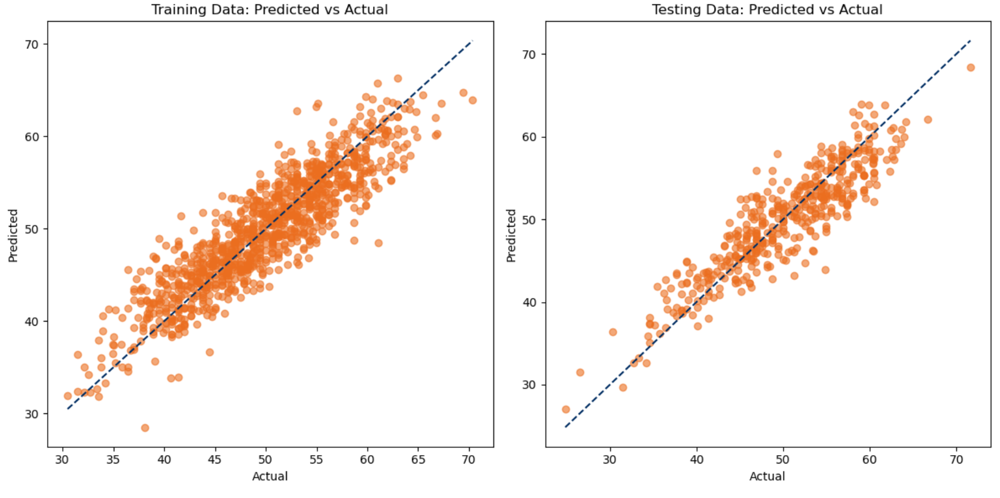

I then extracted the linear coefficients of each column. Looking at the top 3 feature coefficients, it can be seen that the b_runs/g(4.432) variable stands out as having the most significant positive impact on winning percentage. This suggests that more runs under batting category in game tend to be contribute to winning. Being able to retire more batters in a games under pitching category tend to contribute more to winning too, as seen by p_batters_faced/g(3.445). More pitching saves per game also has a subtle positive influence on winning percentage

For the 3 factors that have the most detrimental effect on winning percentage, more runs allowed under the pitching category(-3.697) levels tend to negatively influence winning percetnage the most. Additionally, we found that for more games pitchers finished on average in the team, it tends to result in a lower win percentage(-1.509) Lastly, for more strikeouts per game under the batting category, teams tend to lose slightly more.

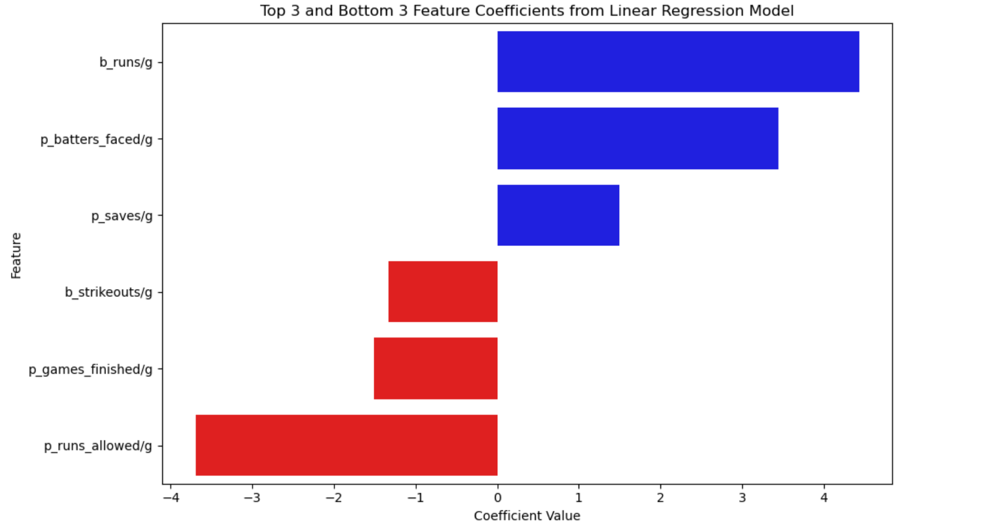

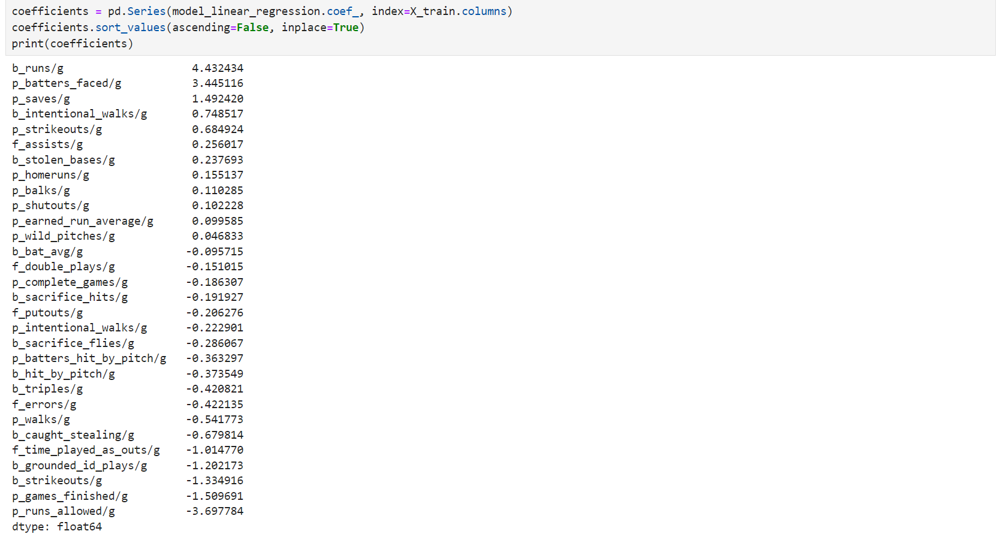

### 5.3 Building & Evaluating The Random Forest Regressor Model

Apart from the linear regression model I ran, I also tried a comparison model I learnt outside of the practicals and exercises, a Random Forest Regressor. Compared to the linear regression model, Random Forest Regressor is a more complex model that can capture non-linear relationships in the data. Comparing performance of these two models will help me determine if the comparison model is necessary, or the Linear Regression model would be sufficient. However, the random forest regressor model exhibits signs of overfitting, as evidenced by the large gap between training and test performance, demonstrating that it was not able to generalise well to new data. (I utilised gridsearchcv to obtain the best parameters.)

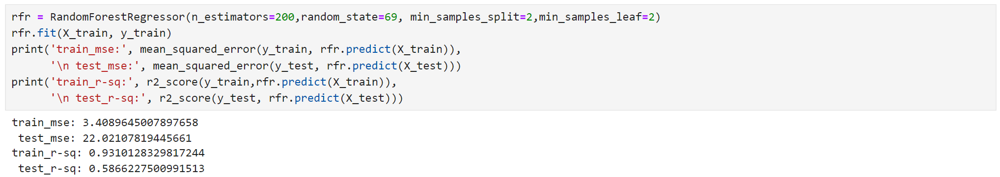

## 6. Summary and Further Improvements<a id="part15"></a>

The evaluation of the Linear Regression model for predicting a baseball team's winning percentage reveals reasonablly great performance, indicated by the Mean Squared Error (MSE) values for both the training (9.931) and test datasets (10.159). This means that our model makes only relatively small errors when predicting how often a baseball team will win based on relative average player statistics. Additionally, the R-Squared values of 0.799 for the training data and 0.809 for the test data suggest that the about 80% of the variation in the outcome variable is explained by the model, which is considered pretty good.

Several enhancements can be considered to further refine the model, and I will provide recommendations below.

The current model could benefit from the creation of new features beyond the basic averages of pitching, batting, and fielding statistics. For instance, possibly incorporating metrics such as player consistency, clutch performance, and other situational statistics which could be a stretch. But this may provide a more comprehensive understanding of factors influencing winning percentage.

Exploring other regression techniques such as Multiple Linear Regression, Ridge Regression, and Lasso Regression, evaluate the robusticity of each model and its ability at generalising to new data and could lead me to obtaining better models. Moreover, more sophisticated models other than Random Forests Regressor could prove as an interesting posibility to capture complex relationships in the data.

Ensuring high-quality data collection is crucial. Filling in missing values accurately with accurate real-life data if possible will possibly enhance model performance. Moreover, gaining a deeper understanding of baseball through consultation with players or sports analysts can also guide the selection of relevant features. Also, from getting new data and constantly reiterating the model will help too.

## 7. Reflection<a id="part16"></a>

### Understanding the Data Wrangling Process and Principles (1)

#### Skills and Abilities I've Acquired
Throughout this module, I have gained a comprehensive understanding of the data wrangling process and its underlying principles. I have learned the importance of cleaning and structuring raw data, as it directly affects the accuracy and reliability of the machine learning models created. Studies show that 50–80% of analysis time is spent wrangling data that has errors, inconsistencies, and poor organization for analysis, further emphasising the critical role of this fundamental step.

I have also better understood the processes as defined below:

Discovery: Understanding the data, including its source, structure, and content.

Structuring: Changing how data is displayed or stored to make it more useful.

Cleaning: Modifying data to correct errors and inconsistencies.

Validating: Confirming data consistency and quality.

Publishing: Sharing the cleaned and structured data, along with documentation of the previous activities.

#### Area(s) for improvement

However, I believe that I could have devoted more time to exploring these concepts in detail beyond the module materials to gain a more granular perspective. This is something I plan and hope to explore further in the near future.

### Extract and transform features from structured datasets, time series, transactions data and text (2)

#### Skills and Abilities I've Acquired
The module equipped me with the skills to extract and transform features from various data types. Through the week 12 and 13 Exercises and Practicals, I learned to handle time series, transactional and text data effectively. The practicals were extremely informative and the code was well explained by my lecturer Mr Joey. It was also great that the exercises gave me an opportunity to apply my learning for that week and tackle the coding tasks. It was also suprising that a single column like date was able to allow for the creation of many other columns such as day of week, year, quarter and many more. Learning about the maxima and minima was also pretty interesting as it could provide more insights into the data (which is the importance of data science).  

#### Area(s) for improvement
I did not really have many opportunities to incorporate some of these I learnt into the assignments as they weren't very relevant to my problem statements. It would be interesting to source datasets uploaded by others on kaggle to apply these learning concepts.

### Design data pipelines to do categorical variable encoding, numerical variable transformation, missing data imputation and variable discretization (3) 

#### Skills and Abilities I've Acquired
Designing efficient data pipelines was a key focus of the module in the variable transformation process. I learned to combine the many individual techniques into a pipelines for encoding categorical variables, transforming numerical variables, imputing missing data, and discretising variables. Learning how to create pipelines is extremly crucial for streamlining these repetitive tasks for easier readability. The exercises and Assignment 1 has also provided me with opportunities to apply my coding knowledge in appropriate scenarios.

#### Area(s) for improvement
I believe that could improve by incorporating other possible imputation methods that were not covered such as the K-Nearest-Neighbours Imputation which will what I will be experimenting in my own time to explore their impacts on model performance.

### Utilize the cutting-edge Python packages to extract, transform and generate features to develop highly optimized machine learning models. (4) 

#### Skills and Abilities I've Acquired
The module introduced me to various advanced Python packages for feature engineering. Through the Feature Engineering practical and exercises, I have learnt the uses of these, as mentioned below.

Feature Extraction: Identifying and selecting relevant features from raw data.

Feature Transformation: Applying techniques to modify features for better model performance.

Feature Generation: Creating new features from existing ones to improve model performance

Under feature generation, I have learnt how to perform mathematical functions on different columns and apply polynomial expansion. Under feature transformation, I have learnt and better understood how to apply Standard Scaling and Min-Max Scaling. Additionally, I have also been introduced to Principal Component Analysis, which my lecturer has explained in layman about around 3 times to me and I believe I would be able to explain.

#### Area(s) for improvement
I could explore the nuances of other different scaling techniques and other feature generation techniques and evaluate their impact on various machine learning algorithms.

### Utilize the enterprise software to do inline data wrangling (5) 

#### Skills and Abilities I've Acquired
Understanding the application of enterprise software in data wrangling was a valuable aspect of the module. I believe that the tool was alteryx to manage and process data within organizational contexts. Although I did not really get the chance to apply it to the assignments in this module, I have achieved the Alteryx Foundation Micro-Credential the test which the knowledge will be useful for my final year project or when I do my own personal data science projects.

#### Area(s) for improvement
I believe I could benefit from gaining deeper insights into the full range of capabilities offered by alteryx by using it in my own projects or I can also learn other applications other than alteryx.

### Apply the data wrangling techniques to solve real word problems (6)

#### Skills and Abilities I've Acquired
I learnt how to come up with useful problem statements that provide great actionable insights to the appropriate stakeholders. In which I applied these data wrangling techniques to solve real world problems in assignments 1 and 2 where I had to perform data wrangling on Song Data and Baseball Data datasets. It was more interesting in this assignment as we were given more than 20 datasets to make sense of which was what my lecturer Mr Joey mentioned was very applicable in real life.

#### Area(s) for improvement
I could improve by seeking more opportunities to apply these techniques in diverse real-world contexts, further solidifying my practical experience.

## 8. References<a id="part17"></a>

#DiamondDebates: MLB Strike | Baseball Hall of Fame. (n.d.). Baseballhall.org. https://baseballhall.org/discover-more/stories/whole-new-ballgame/mlb-strike

Caught stealing. (2023, December 28). Wikipedia. https://en.wikipedia.org/wiki/Caught_stealing

Intentional Bases On Balls Records | Baseball Almanac. (n.d.). Www.baseball-Almanac.com. Retrieved July 12, 2024, from https://www.baseball-almanac.com/recbooks/rb_wk3.shtml

OpenAI. (2024). ChatGPT . ChatGPT. https://chatgpt.com/

Sacrifice Fly (SF) | Glossary. (n.d.). MLB.com. https://www.mlb.com/glossary/standard-stats/sacrifice-fly

scikit-learn. (2018). 3.2.4.3.2. sklearn.ensemble.RandomForestRegressor — scikit-learn 0.20.3 documentation. Scikit-Learn.org. https://scikit-learn.org/stable/modules/generated/sklearn.ensemble.RandomForestRegressor.html

Wikipedia Contributors. (2019, September 8). Baseball statistics. Wikipedia; Wikimedia Foundation. https://en.wikipedia.org/wiki/Baseball_statistics
